# PROJET : ANALYSE DES SENTIMENTS - AMAZON REVIEWS

# Étape 1 : Définition de la problématique et objectifs

**📋 Contexte et Problématique**<br>
Le défi business<br>
Dans l'ère numérique actuelle, les entreprises génèrent et reçoivent un volume massif de retours clients : avis en ligne, commentaires sur<br>
les réseaux sociaux, emails de support, enquêtes de satisfaction, etc. Analyser manuellement ces données est :<br>

Chronophage : impossible à l'échelle de milliers/millions de commentaires<br>
Coûteux : nécessite des ressources humaines importantes<br>
Subjectif : l'interprétation peut varier d'une personne à l'autre<br>
Lent : les insights arrivent trop tard pour agir rapidement<br>

**La problématique**<br>
Comment automatiser la compréhension des émotions et opinions des clients à partir de leurs commentaires textuels, afin de prendre des<br> 
décisions business éclairées en temps réel ?<br>

**🎯 Objectifs du Projet**<br>
Développer un modèle de Machine Learning capable de classifier automatiquement le sentiment exprimé dans un texte en trois catégories :<br>
**Positif**, **Négatif**, ou **Neutre**.

# ÉTAPE 2 : CHARGEMENT ET EXPLORATION DES DONNÉES

Dans cette section, nous allons :
- Charger le dataset Amazon Reviews
- Comprendre sa structure et ses caractéristiques
- Identifier les patterns, déséquilibres et anomalies
- Visualiser les distributions et premières insights

In [15]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [17]:
# Import des bibliothèques

# Manipulation de données
import pandas as pd
import numpy as np

# Visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Analyse de texte
from wordcloud import WordCloud
import re
from collections import Counter

# Utilitaires
import warnings
warnings.filterwarnings('ignore')

# Configuration de l'affichage
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 200)
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")


In [21]:
import pandas as pd
import bz2

# Chemins vers les fichiers
train_path = 'Downloads/train.ft.txt.bz2/train.ft.txt.bz2'
test_path = 'Downloads/test.ft.txt.bz2/test.ft.txt.bz2'

def load_amazon_data(filepath, sample_size=None):
    """
    Charge et parse les données Amazon Reviews
    Format : __label__X texte_du_review
    """
    labels = []
    texts = []

    with bz2.open(filepath, 'rt', encoding='utf-8') as f:
        for i, line in enumerate(f):
            if sample_size is not None and i >= sample_size:
                break

            parts = line.strip().split(' ', 1)
            if len(parts) == 2:
                label = int(parts[0].replace('__label__', ''))
                text = parts[1]
                labels.append(label)
                texts.append(text)

    return pd.DataFrame({
        'label': labels,
        'text': texts
    })

#Chargement des données d'entraînement
df_train = load_amazon_data(train_path, sample_size=100_000) # 100k pour commencer

#Chargement des données de test
df_test = load_amazon_data(test_path, sample_size=20_000) #20k pour le test

print("✅ Données chargées avec succès !")
print(f"   - Training set : {len(df_train):,}")
print(f"   - Test set     : {len(df_test):,}")


✅ Données chargées avec succès !
   - Training set : 100,000
   - Test set     : 20,000


In [23]:
# Combinons temporairement pour l'exploration
df = df_train.copy()

In [25]:
# ## 🔍 Première Vue des Données

# %%
print("=" * 80)
print("📋 APERÇU DU DATASET")
print("=" * 80)
print("\n🎯 Premières lignes :")
display(df.head(10))

print("\n" + "=" * 80)
print("📊 Informations générales :")
print("=" * 80)
df.info()

print("\n" + "=" * 80)
print("📈 Statistiques descriptives :")
print("=" * 80)
display(df.describe())

📋 APERÇU DU DATASET

🎯 Premières lignes :


,label,text
0,2,Stuning even for the non-gamer: This sound track was beautiful! It paints the senery in your mind so well I would recomend it even to people who hate vid. game music! I have played the game Chrono...
1,2,The best soundtrack ever to anything.: I'm reading a lot of reviews saying that this is the best 'game soundtrack' and I figured that I'd write a review to disagree a bit. This in my opinino is Ya...
2,2,"Amazing!: This soundtrack is my favorite music of all time, hands down. The intense sadness of ""Prisoners of Fate"" (which means all the more if you've played the game) and the hope in ""A Distant P..."
3,2,Excellent Soundtrack: I truly like this soundtrack and I enjoy video game music. I have played this game and most of the music on here I enjoy and it's truly relaxing and peaceful.On disk one. my ...
4,2,"Remember, Pull Your Jaw Off The Floor After Hearing it: If you've played the game, you know how divine the music is! Every single song tells a story of the game, it's that good! The greatest songs..."
5,2,"an absolute masterpiece: I am quite sure any of you actually taking the time to read this have played the game at least once, and heard at least a few of the tracks here. And whether you were awar..."
6,1,"Buyer beware: This is a self-published book, and if you want to know why--read a few paragraphs! Those 5 star reviews must have been written by Ms. Haddon's family and friends--or perhaps, by hers..."
7,2,"Glorious story: I loved Whisper of the wicked saints. The story was amazing and I was pleasantly surprised at the changes in the book. I am not normaly someone who is into romance novels, but the ..."
8,2,"A FIVE STAR BOOK: I just finished reading Whisper of the Wicked saints. I fell in love with the caracters. I expected an average romance read, but instead I found one of my favorite books of all t..."
9,2,"Whispers of the Wicked Saints: This was a easy to read book that made me want to keep reading on and on, not easy to put down.It left me wanting to read the follow on, which I hope is coming soon...."



📊 Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   label   100000 non-null  int64 
 1   text    100000 non-null  object
dtypes: int64(1), object(1)
memory usage: 1.5+ MB

📈 Statistiques descriptives :


,label
count,100000.000000
mean,1.512670
std,0.499842
min,1.000000
25%,1.000000
50%,2.000000
75%,2.000000
max,2.000000


In [27]:
# Mapper les labels vers des sentiments compréhensibles: 1 = Négatif, 2 = Positif
sentiment_map = {1: 'Négatif', 2: 'Positif'}
df['sentiment'] = df['label'].map(sentiment_map)

In [29]:
print("=" * 80)
print("🏷️ DISTRIBUTION DES SENTIMENTS")
print("=" * 80)

# Comptage
sentiment_counts = df['sentiment'].value_counts()
sentiment_percentages = df['sentiment'].value_counts(normalize=True) * 100

print("\n📊 Nombre de reviews par sentiment :")
for sentiment in sentiment_counts.index:
    count = sentiment_counts[sentiment]
    pct = sentiment_percentages[sentiment]
    print(f"   {sentiment:10s} : {count:6,d} ({pct:5.2f}%)")

print(f"\n⚖️ Ratio Positif/Négatif : {sentiment_counts['Positif'] / sentiment_counts['Négatif']:.2f}")

🏷️ DISTRIBUTION DES SENTIMENTS

📊 Nombre de reviews par sentiment :
   Positif    : 51,267 (51.27%)
   Négatif    : 48,733 (48.73%)

⚖️ Ratio Positif/Négatif : 1.05


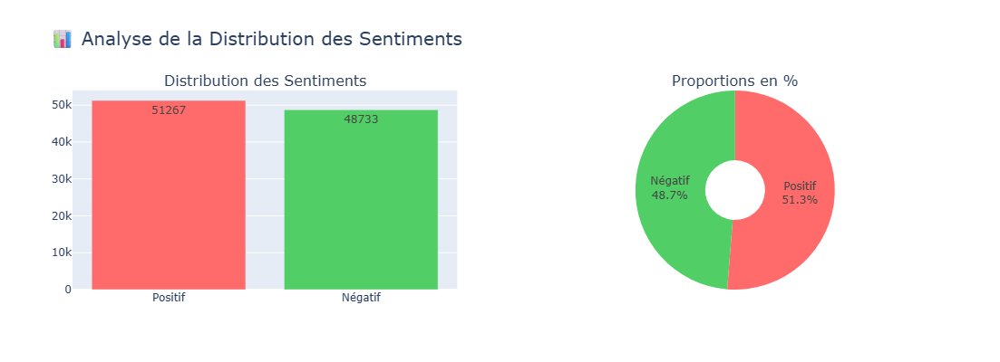

In [31]:
# Visualisation de la distribution
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Distribution des Sentiments', 'Proportions en %'),
    specs=[[{"type": "bar"}, {"type": "pie"}]]
)

# Graphique en barres
fig.add_trace(
    go.Bar(
        x=sentiment_counts.index,
        y=sentiment_counts.values,
        marker_color=['#ff6b6b', '#51cf66'],
        text=sentiment_counts.values,
        textposition='auto',
        name='Count'
    ),
    row=1, col=1
)

# Graphique circulaire
fig.add_trace(
    go.Pie(
        labels=sentiment_counts.index,
        values=sentiment_counts.values,
        marker=dict(colors=['#ff6b6b', '#51cf66']),
        textinfo='label+percent',
        hole=0.3
    ),
    row=1, col=2
)

fig.update_layout(
    title_text="📊 Analyse de la Distribution des Sentiments",
    title_font_size=20,
    showlegend=False,
    height=400
)

fig.show()

In [33]:
# 📝 Analyse de la Longueur des Textes

# Calcul des statistiques de longueur
df['text_length'] = df['text'].str.len()
df['word_count'] = df['text'].str.split().str.len()

print("=" * 80)
print("📏 STATISTIQUES SUR LA LONGUEUR DES TEXTES")
print("=" * 80)

# Statistiques globales
print("\n🔢 Longueur en caractères :")
print(f"   Moyenne  : {df['text_length'].mean():.1f}")
print(f"   Médiane  : {df['text_length'].median():.1f}")
print(f"   Min      : {df['text_length'].min()}")
print(f"   Max      : {df['text_length'].max()}")
print(f"   Std Dev  : {df['text_length'].std():.1f}")

print("\n📚 Nombre de mots :")
print(f"   Moyenne  : {df['word_count'].mean():.1f}")
print(f"   Médiane  : {df['word_count'].median():.1f}")
print(f"   Min      : {df['word_count'].min()}")
print(f"   Max      : {df['word_count'].max()}")
print(f"   Std Dev  : {df['word_count'].std():.1f}")

# Statistiques par sentiment
print("\n" + "=" * 80)
print("📊 COMPARAISON PAR SENTIMENT")
print("=" * 80)

comparison = df.groupby('sentiment').agg({
    'text_length': ['mean', 'median', 'std'],
    'word_count': ['mean', 'median', 'std']
}).round(1)

display(comparison)

📏 STATISTIQUES SUR LA LONGUEUR DES TEXTES

🔢 Longueur en caractères :
   Moyenne  : 439.5
   Médiane  : 393.0
   Min      : 101
   Max      : 1015
   Std Dev  : 240.4

📚 Nombre de mots :
   Moyenne  : 79.8
   Médiane  : 72.0
   Min      : 10
   Max      : 241
   Std Dev  : 43.2

📊 COMPARAISON PAR SENTIMENT


text_length               word_count             
                 mean median    std       mean median   std
sentiment                                                  
Négatif         455.7  416.0  237.5       82.8   76.0  42.8
Positif         424.2  370.0  242.2       76.9   68.0  43.5

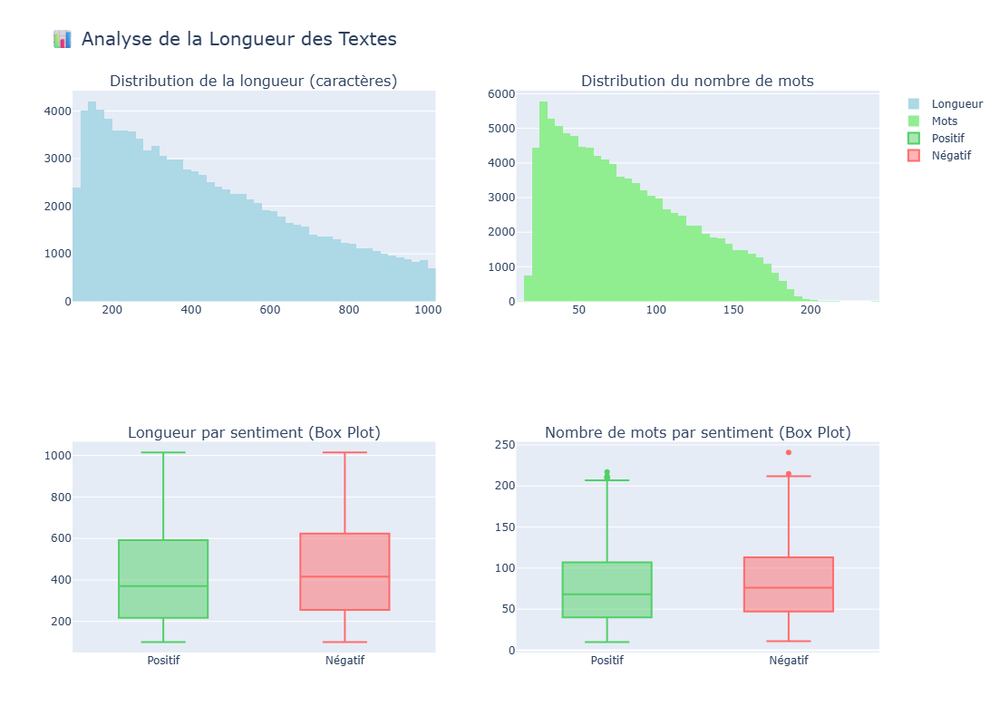

In [35]:
# Visualisation des distributions de longueur
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=(
        'Distribution de la longueur (caractères)',
        'Distribution du nombre de mots',
        'Longueur par sentiment (Box Plot)',
        'Nombre de mots par sentiment (Box Plot)'
    )
)

# Histogramme longueur caractères
fig.add_trace(
    go.Histogram(
        x=df['text_length'],
        nbinsx=50,
        name='Longueur',
        marker_color='lightblue'
    ),
    row=1, col=1
)

# Histogramme nombre de mots
fig.add_trace(
    go.Histogram(
        x=df['word_count'],
        nbinsx=50,
        name='Mots',
        marker_color='lightgreen'
    ),
    row=1, col=2
)

# Box plot longueur par sentiment
for sentiment in df['sentiment'].unique():
    data = df[df['sentiment'] == sentiment]['text_length']
    fig.add_trace(
        go.Box(
            y=data,
            name=sentiment,
            marker_color='#ff6b6b' if sentiment == 'Négatif' else '#51cf66'
        ),
        row=2, col=1
    )

# Box plot mots par sentiment
for sentiment in df['sentiment'].unique():
    data = df[df['sentiment'] == sentiment]['word_count']
    fig.add_trace(
        go.Box(
            y=data,
            name=sentiment,
            marker_color='#ff6b6b' if sentiment == 'Négatif' else '#51cf66',
            showlegend=False
        ),
        row=2, col=2
    )

fig.update_layout(
    title_text="📊 Analyse de la Longueur des Textes",
    title_font_size=20,
    height=800,
    showlegend=True
)

fig.show()

In [39]:

# 🔤 Analyse des Mots les Plus Fréquents

def get_top_words(texts, n=20, remove_stopwords=True):
    """
    Extrait les mots les plus fréquents d'une série de textes
    """
    # Stopwords basiques en anglais
    stopwords = {
        'the', 'a', 'an', 'and', 'or', 'but', 'in', 'on', 'at', 'to', 'for',
        'of', 'with', 'is', 'was', 'are', 'been', 'be', 'have', 'has', 'had',
        'do', 'does', 'did', 'will', 'would', 'could', 'should', 'may', 'might',
        'i', 'you', 'he', 'she', 'it', 'we', 'they', 'this', 'that', 'these',
        'those', 'my', 'your', 'his', 'her', 'its', 'our', 'their'
    }
    
    # Concaténer tous les textes
    all_text = ' '.join(texts).lower()
    
    # Extraire les mots
    words = re.findall(r'\b[a-z]+\b', all_text)
    
    # Filtrer les stopwords si demandé
    if remove_stopwords:
        words = [w for w in words if w not in stopwords and len(w) > 2]
    
    # Compter les occurrences
    word_counts = Counter(words)
    
    return word_counts.most_common(n)

# %%
print("=" * 80)
print("🔤 MOTS LES PLUS FRÉQUENTS")
print("=" * 80)

# Mots fréquents globaux
print("\n📊 Top 20 mots (tous sentiments confondus) :")
top_words_all = get_top_words(df['text'], n=20)
for i, (word, count) in enumerate(top_words_all, 1):
    print(f"   {i:2d}. {word:15s} : {count:6,d} occurrences")

# Mots fréquents par sentiment
print("\n" + "=" * 80)
for sentiment in df['sentiment'].unique():
    texts = df[df['sentiment'] == sentiment]['text']
    top_words = get_top_words(texts, n=15)
    
    print(f"\n🏷️ Top 15 mots - {"sentiments "+sentiment} :")
    for i, (word, count) in enumerate(top_words, 1):
        print(f"   {i:2d}. {word:15s} : {count:6,d} occurrences")

🔤 MOTS LES PLUS FRÉQUENTS

📊 Top 20 mots (tous sentiments confondus) :
    1. not             : 62,307 occurrences
    2. book            : 62,066 occurrences
    3. one             : 40,732 occurrences
    4. all             : 33,743 occurrences
    5. movie           : 31,333 occurrences
    6. great           : 30,377 occurrences
    7. good            : 30,334 occurrences
    8. like            : 30,148 occurrences
    9. very            : 28,836 occurrences
   10. just            : 26,970 occurrences
   11. from            : 26,060 occurrences
   12. read            : 25,335 occurrences
   13. about           : 24,407 occurrences
   14. can             : 23,794 occurrences
   15. what            : 22,974 occurrences
   16. out             : 22,965 occurrences
   17. more            : 20,858 occurrences
   18. there           : 20,841 occurrences
   19. time            : 20,105 occurrences
   20. when            : 19,472 occurrences


🏷️ Top 15 mots - sentiments Positif :
    1. bo

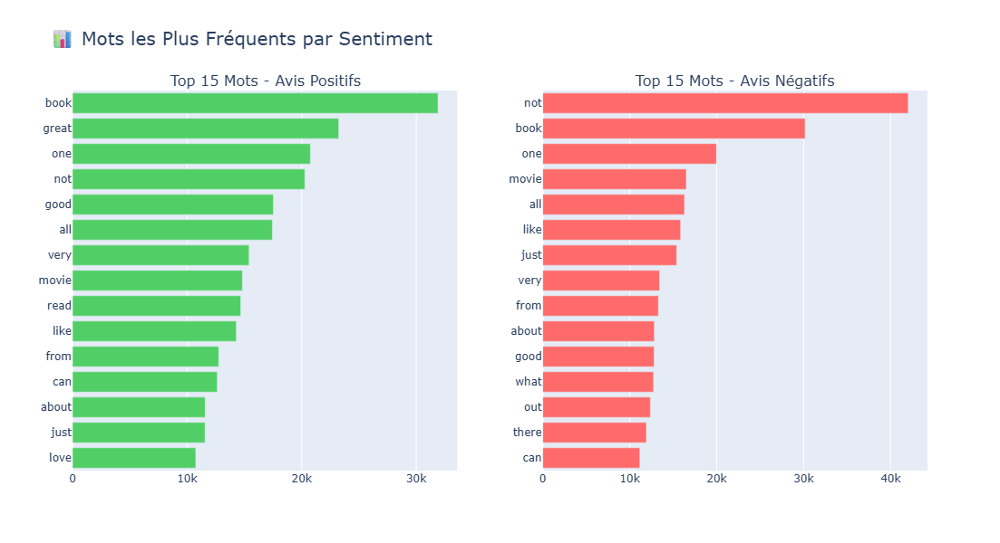

In [41]:
# Visualisation avec graphiques en barres
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Top 15 Mots - Avis Positifs', 'Top 15 Mots - Avis Négatifs')
)

# Mots positifs
pos_texts = df[df['sentiment'] == 'Positif']['text']
top_pos = get_top_words(pos_texts, n=15)
words_pos, counts_pos = zip(*top_pos)

fig.add_trace(
    go.Bar(
        y=list(words_pos)[::-1],
        x=list(counts_pos)[::-1],
        orientation='h',
        marker_color='#51cf66',
        name='Positif'
    ),
    row=1, col=1
)

# Mots négatifs
neg_texts = df[df['sentiment'] == 'Négatif']['text']
top_neg = get_top_words(neg_texts, n=15)
words_neg, counts_neg = zip(*top_neg)

fig.add_trace(
    go.Bar(
        y=list(words_neg)[::-1],
        x=list(counts_neg)[::-1],
        orientation='h',
        marker_color='#ff6b6b',
        name='Négatif'
    ),
    row=1, col=2
)

fig.update_layout(
    title_text="📊 Mots les Plus Fréquents par Sentiment",
    title_font_size=20,
    height=600,
    showlegend=False
)

fig.show()

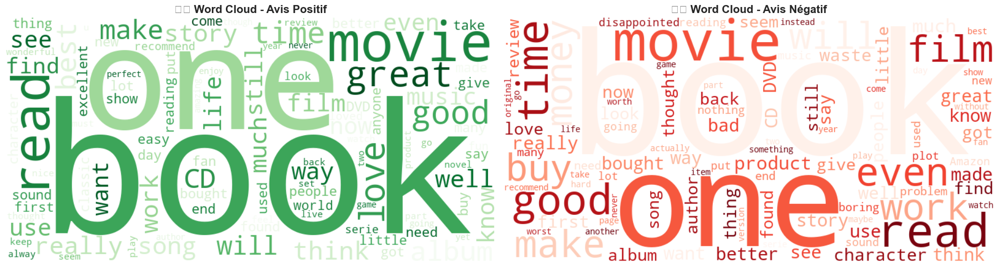

In [43]:
# ☁️ Nuages de Mots (Word Clouds)

# Création des word clouds
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

for idx, sentiment in enumerate(['Positif', 'Négatif']):
    # Préparer le texte
    texts = df[df['sentiment'] == sentiment]['text']
    text_combined = ' '.join(texts)
    
    # Créer le word cloud
    wordcloud = WordCloud(
        width=800,
        height=400,
        background_color='white',
        colormap='Greens' if sentiment == 'Positif' else 'Reds',
        max_words=100,
        relative_scaling=0.5,
        min_font_size=10
    ).generate(text_combined)
    
    # Afficher
    axes[idx].imshow(wordcloud, interpolation='bilinear')
    axes[idx].set_title(f'☁️ Word Cloud - Avis {sentiment}', fontsize=16, fontweight='bold')
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

In [45]:
# ## 🔍 Exemples de Reviews par Sentiment

print("=" * 80)
print("📝 EXEMPLES DE REVIEWS")
print("=" * 80)

for sentiment in ['Positif', 'Négatif']:
    print(f"\n{'='*80}")
    print(f"🏷️ SENTIMENT : {sentiment.upper()}")
    print(f"{'='*80}\n")
    
    # Sélectionner 3 exemples aléatoires
    samples = df[df['sentiment'] == sentiment].sample(n=3, random_state=42)
    
    for i, (idx, row) in enumerate(samples.iterrows(), 1):
        print(f"Exemple {i} :")
        print(f"Longueur : {row['text_length']} caractères | {row['word_count']} mots")
        print(f"Texte : {row['text'][:300]}{'...' if len(row['text']) > 300 else ''}")
        print()

📝 EXEMPLES DE REVIEWS

🏷️ SENTIMENT : POSITIF

Exemple 1 :
Longueur : 768 caractères | 140 mots
Texte : Incredible read: Picoult has done it again! I thought Mercy could not be topped...Mariah and her daughter Faith find their husband/father with another woman, sending both mother and daughter into a retreat of their own sort. Mariah reacted like most women; Faith, however, starts to see a "guard", la...

Exemple 2 :
Longueur : 570 caractères | 109 mots
Texte : Nice 80's Rock ensemble: First of all, be open minded, this is an 80's rock ensemble . . . then like in the 80's you will hear a lot of electric sounds (e.g. electric-drums, synths, etc). And if you enjoy the original Carmina Burana, this will be a pleasant experience.I really enjoy it because I lik...

Exemple 3 :
Longueur : 254 caractères | 43 mots
Texte : Columbia Fleece Vest: Not the first vest of this type from Columbia that I've purchased. Exactly what I wanted,soft,light weight but provides the warmth I want. Seems easy t

In [47]:
# 🧹 Vérification de la Qualité des Données
print("=" * 80)
print("🔍 VÉRIFICATION DE LA QUALITÉ DES DONNÉES")
print("=" * 80)

# Valeurs manquantes
print("\n❓ Valeurs manquantes :")
missing = df.isnull().sum()
print(missing)

if missing.sum() == 0:
    print("   ✅ Aucune valeur manquante détectée !")

# Doublons
print(f"\n🔄 Doublons :")
duplicates = df.duplicated().sum()
print(f"   Nombre de doublons : {duplicates:,}")

if duplicates > 0:
    print(f"   ⚠️ {duplicates:,} reviews dupliquées trouvées ({duplicates/len(df)*100:.2f}%)")
else:
    print("   ✅ Aucun doublon détecté !")

# Reviews vides ou très courtes
print(f"\n📏 Reviews potentiellement problématiques :")
very_short = (df['word_count'] < 3).sum()
print(f"   Reviews < 3 mots : {very_short:,} ({very_short/len(df)*100:.2f}%)")

empty_or_short = df[df['word_count'] < 3]
if len(empty_or_short) > 0:
    print("\n   Exemples :")
    for idx, row in empty_or_short.head(3).iterrows():
        print(f"   - '{row['text']}' ({row['word_count']} mots)")

🔍 VÉRIFICATION DE LA QUALITÉ DES DONNÉES

❓ Valeurs manquantes :
label          0
text           0
sentiment      0
text_length    0
word_count     0
dtype: int64
   ✅ Aucune valeur manquante détectée !

🔄 Doublons :
   Nombre de doublons : 0
   ✅ Aucun doublon détecté !

📏 Reviews potentiellement problématiques :
   Reviews < 3 mots : 0 (0.00%)


In [49]:
# Sauvegarder le dataframe avec les nouvelles colonnes
df.to_csv('amazon_reviews_explored.csv', index=False)
print("✅ Données explorées sauvegardées dans amazon_reviews_explored.csv'")

print("\n" + "="*80)
print("✨ ÉTAPE 2 TERMINÉE AVEC SUCCÈS ! ✨")
print("="*80)

✅ Données explorées sauvegardées dans amazon_reviews_explored.csv'

✨ ÉTAPE 2 TERMINÉE AVEC SUCCÈS ! ✨


# ÉTAPE 3 : NETTOYAGE ET PREPROCESSING DU TEXTE

 Dans cette section, nous allons :
- Nettoyer les textes (casse, ponctuation, caractères spéciaux)
- Normaliser le texte (lemmatisation, stemming)
- Retirer les stopwords
- Gérer les cas particuliers (URLs, emails, nombres)
- Comparer avant/après preprocessing
- Préparer les données pour la modélisation

In [54]:
# Bibliothèques NLP
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer, PorterStemmer
from nltk.corpus import wordnet

In [56]:
# Téléchargement des ressources NLTK nécessaires
print("📥 Téléchargement des ressources NLTK...")
nltk_resources = ['punkt', 'stopwords', 'wordnet', 'averaged_perceptron_tagger', 'omw-1.4']

for resource in nltk_resources:
    try:
        nltk.download(resource, quiet=True)
    except:
        pass

print("✅ Ressources NLTK téléchargées !\n")

📥 Téléchargement des ressources NLTK...
✅ Ressources NLTK téléchargées !



In [58]:
# Initialisation des outils
lemmatizer = WordNetLemmatizer()
stemmer = PorterStemmer()
stop_words = set(stopwords.words('english'))

print(f"📊 Nombre de stopwords en anglais : {len(stop_words)}")
print(f"📝 Exemples : {list(stop_words)[:10]}")

📊 Nombre de stopwords en anglais : 198
📝 Exemples : ['into', 'then', 'which', 'because', 'hasn', 'ain', 'at', 'yours', "we're", "hadn't"]


In [60]:
# ## 📂 Chargement des données explorées
# Charger les données de l'étape précédente
df = pd.read_csv('amazon_reviews_explored.csv')

print("=" * 80)
print("📊 DONNÉES CHARGÉES")
print("=" * 80)
print(f"Nombre de reviews : {len(df):,}")
print(f"Colonnes : {list(df.columns)}")
print(f"\n✅ Prêt pour le preprocessing !")

📊 DONNÉES CHARGÉES
Nombre de reviews : 100,000
Colonnes : ['label', 'text', 'sentiment', 'text_length', 'word_count']

✅ Prêt pour le preprocessing !


In [62]:
# ## 🔍 Analyse du texte AVANT nettoyage
print("=" * 80)
print("🔍 ANALYSE DU TEXTE BRUT (AVANT NETTOYAGE)")
print("=" * 80)

# Échantillon de textes
print("\n📝 Exemples de textes bruts :\n")
for i, text in enumerate(df['text'].head(3), 1):
    print(f"Exemple {i}:")
    print(f"{text[:200]}...")
    print()

🔍 ANALYSE DU TEXTE BRUT (AVANT NETTOYAGE)

📝 Exemples de textes bruts :

Exemple 1:
Stuning even for the non-gamer: This sound track was beautiful! It paints the senery in your mind so well I would recomend it even to people who hate vid. game music! I have played the game Chrono Cro...

Exemple 2:
The best soundtrack ever to anything.: I'm reading a lot of reviews saying that this is the best 'game soundtrack' and I figured that I'd write a review to disagree a bit. This in my opinino is Yasuno...

Exemple 3:
Amazing!: This soundtrack is my favorite music of all time, hands down. The intense sadness of "Prisoners of Fate" (which means all the more if you've played the game) and the hope in "A Distant Promi...



In [64]:
# Détection de patterns spéciaux
def analyze_special_patterns(texts):
    """Analyse les patterns spéciaux dans les textes"""
    patterns = {
        'URLs': r'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\\(\\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+',
        'Emails': r'\b[A-Za-z0-9._%+-]+@[A-Za-z0-9.-]+\.[A-Z|a-z]{2,}\b',
        'Mentions': r'@\w+',
        'Hashtags': r'#\w+',
        'Nombres': r'\b\d+\b',
        'Ponctuation excessive': r'[!?]{2,}',
        'Majuscules': r'\b[A-Z]{2,}\b'
    }
    
    results = {}
    for name, pattern in patterns.items():
        count = sum(len(re.findall(pattern, str(text))) for text in texts)
        results[name] = count
    
    return results

patterns_found = analyze_special_patterns(df['text'])

print("🔎 Patterns spéciaux détectés :")
for pattern, count in patterns_found.items():
    print(f"   {pattern:25s} : {count:6,} occurrences")

🔎 Patterns spéciaux détectés :
   URLs                      :     76 occurrences
   Emails                    :     88 occurrences
   Mentions                  :    121 occurrences
   Hashtags                  :    659 occurrences
   Nombres                   : 67,245 occurrences
   Ponctuation excessive     : 13,128 occurrences
   Majuscules                : 148,972 occurrences


In [66]:
# ## 🛠️ Fonctions de Nettoyage

def clean_text_basic(text):
    """
    Nettoyage basique du texte
    - Conversion en minuscules
    - Suppression URLs, emails, mentions
    - Suppression caractères spéciaux
    """
    if pd.isna(text):
        return ""
    
    text = str(text)
    
    # Conversion en minuscules
    text = text.lower()
    
    # Suppression des URLs
    text = re.sub(r'http[s]?://\S+|www\.\S+', '', text)
    
    # Suppression des emails
    text = re.sub(r'\S+@\S+', '', text)
    
    # Suppression des mentions et hashtags
    text = re.sub(r'@\w+|#\w+', '', text)
    
    # Suppression des nombres (optionnel, selon le contexte)
    # text = re.sub(r'\d+', '', text)
    
    # Gestion des contractions courantes en anglais
    contractions = {
        "won't": "will not", "can't": "cannot", "n't": " not",
        "'re": " are", "'s": " is", "'d": " would",
        "'ll": " will", "'ve": " have", "'m": " am"
    }
    for contraction, expansion in contractions.items():
        text = text.replace(contraction, expansion)
    
    # Suppression de la ponctuation excessive (garder un seul)
    text = re.sub(r'([!?.]){2,}', r'\1', text)
    
    # Suppression des caractères spéciaux (garder lettres, chiffres, espaces)
    text = re.sub(r'[^a-zA-Z0-9\s]', ' ', text)
    
    # Suppression des espaces multiples
    text = re.sub(r'\s+', ' ', text)
    
    # Suppression des espaces en début/fin
    text = text.strip()
    
    return text


def get_wordnet_pos(word):
    """
    Convertit les tags POS de NLTK en tags WordNet pour une meilleure lemmatisation
    """
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {
        "J": wordnet.ADJ,
        "N": wordnet.NOUN,
        "V": wordnet.VERB,
        "R": wordnet.ADV
    }
    return tag_dict.get(tag, wordnet.NOUN)


def remove_stopwords(text, custom_stopwords=None):
    """
    Supprime les stopwords du texte
    """
    words = text.split()
    
    # Utiliser les stopwords par défaut + custom si fourni
    stops = stop_words.copy()
    if custom_stopwords:
        stops.update(custom_stopwords)
    
    # Filtrer les stopwords tout en gardant les mots significatifs
    filtered_words = [word for word in words if word not in stops and len(word) > 2]
    
    return ' '.join(filtered_words)


def lemmatize_text(text):
    """
    Lemmatise le texte (ramène les mots à leur forme de base)
    """
    words = text.split()
    lemmatized = [lemmatizer.lemmatize(word, get_wordnet_pos(word)) for word in words]
    return ' '.join(lemmatized)


def stem_text(text):
    """
    Applique le stemming (coupe les mots à leur racine)
    """
    words = text.split()
    stemmed = [stemmer.stem(word) for word in words]
    return ' '.join(stemmed)


def preprocess_text(text, remove_stops=True, use_lemmatization=True, use_stemming=False):
    """
    Pipeline complet de preprocessing
    
    Parameters:
    -----------
    text : str
        Texte à traiter
    remove_stops : bool
        Si True, supprime les stopwords
    use_lemmatization : bool
        Si True, applique la lemmatisation
    use_stemming : bool
        Si True, applique le stemming (incompatible avec lemmatization)
    
    Returns:
    --------
    str : Texte nettoyé
    """
    # Nettoyage basique
    text = clean_text_basic(text)
    
    # Suppression des stopwords
    if remove_stops:
        text = remove_stopwords(text)
    
    # Lemmatisation OU Stemming (pas les deux)
    if use_lemmatization and not use_stemming:
        text = lemmatize_text(text)
    elif use_stemming:
        text = stem_text(text)
    
    return text

print("=" * 80)
print("✅ FONCTIONS DE NETTOYAGE DÉFINIES")
print("=" * 80)
print("""
📋 Fonctions disponibles :
   1. clean_text_basic()      : Nettoyage basique
   2. remove_stopwords()      : Suppression stopwords
   3. lemmatize_text()        : Lemmatisation
   4. stem_text()             : Stemming
   5. preprocess_text()       : Pipeline complet
""")

✅ FONCTIONS DE NETTOYAGE DÉFINIES

📋 Fonctions disponibles :
   1. clean_text_basic()      : Nettoyage basique
   2. remove_stopwords()      : Suppression stopwords
   3. lemmatize_text()        : Lemmatisation
   4. stem_text()             : Stemming
   5. preprocess_text()       : Pipeline complet



In [70]:
import nltk

nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
nltk.download('omw-1.4')


[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\RPC\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\RPC\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\RPC\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [72]:
import nltk
nltk.download('averaged_perceptron_tagger_eng')

[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     C:\Users\RPC\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping taggers\averaged_perceptron_tagger_eng.zip.


True

In [74]:
# ## 🧪 Test des fonctions de nettoyage
print("=" * 80)
print("🧪 DÉMONSTRATION DU PREPROCESSING")
print("=" * 80)

# Texte de test
test_text = df['text'].iloc[0]

print("\n📝 Texte original :")
print(f"'{test_text}'\n")

print("=" * 80)
print("\n🔄 Étapes de transformation :\n")

# Étape 1 : Nettoyage basique
cleaned = clean_text_basic(test_text)
print("1️⃣ Après nettoyage basique :")
print(f"   '{cleaned}'\n")

# Étape 2 : Suppression stopwords
no_stops = remove_stopwords(cleaned)
print("2️⃣ Après suppression des stopwords :")
print(f"   '{no_stops}'\n")

# Étape 3 : Lemmatisation
lemmatized = lemmatize_text(no_stops)
print("3️⃣ Après lemmatisation :")
print(f"   '{lemmatized}'\n")

# Comparaison Lemmatization vs Stemming
print("=" * 80)
print("\n⚔️ COMPARAISON : Lemmatization vs Stemming\n")

test_words = "running runs ran runner easily easily happily"
print(f"Texte test : '{test_words}'\n")

lemmatized_version = lemmatize_text(test_words)
stemmed_version = stem_text(test_words)

print(f"Lemmatization : '{lemmatized_version}'")
print(f"Stemming      : '{stemmed_version}'")

print("\n💡 Note : La lemmatisation préserve des mots valides,")
print("   le stemming est plus agressif mais moins précis.")

🧪 DÉMONSTRATION DU PREPROCESSING

📝 Texte original :
'Stuning even for the non-gamer: This sound track was beautiful! It paints the senery in your mind so well I would recomend it even to people who hate vid. game music! I have played the game Chrono Cross but out of all of the games I have ever played it has the best music! It backs away from crude keyboarding and takes a fresher step with grate guitars and soulful orchestras. It would impress anyone who cares to listen! ^_^'


🔄 Étapes de transformation :

1️⃣ Après nettoyage basique :
   'stuning even for the non gamer this sound track was beautiful it paints the senery in your mind so well i would recomend it even to people who hate vid game music i have played the game chrono cross but out of all of the games i have ever played it has the best music it backs away from crude keyboarding and takes a fresher step with grate guitars and soulful orchestras it would impress anyone who cares to listen'

2️⃣ Après suppression des stopword

In [76]:
# ## 🚀 Application du Preprocessing sur tout le dataset

print("=" * 80)
print("🚀 APPLICATION DU PREPROCESSING SUR TOUT LE DATASET")
print("=" * 80)

# Créer une copie pour comparer
df['text_original'] = df['text']

# Configuration du preprocessing
REMOVE_STOPWORDS = True
USE_LEMMATIZATION = True
USE_STEMMING = False

print(f"\n⚙️ Configuration :")
print(f"   • Suppression stopwords  : {REMOVE_STOPWORDS}")
print(f"   • Lemmatisation          : {USE_LEMMATIZATION}")
print(f"   • Stemming               : {USE_STEMMING}")

print(f"\n⏳ Preprocessing en cours...")

# Appliquer le preprocessing (avec barre de progression)
from tqdm.auto import tqdm
tqdm.pandas(desc="🔄 Nettoyage")

df['text_cleaned'] = df['text'].progress_apply(
    lambda x: preprocess_text(
        x, 
        remove_stops=REMOVE_STOPWORDS,
        use_lemmatization=USE_LEMMATIZATION,
        use_stemming=USE_STEMMING
    )
)

print("\n✅ Preprocessing terminé !")

🚀 APPLICATION DU PREPROCESSING SUR TOUT LE DATASET

⚙️ Configuration :
   • Suppression stopwords  : True
   • Lemmatisation          : True
   • Stemming               : False

⏳ Preprocessing en cours...


🔄 Nettoyage:   0%|          | 0/100000 [00:00<?, ?it/s]


✅ Preprocessing terminé !


In [78]:
# Calculer les nouvelles statistiques
df['cleaned_length'] = df['text_cleaned'].str.len()
df['cleaned_word_count'] = df['text_cleaned'].str.split().str.len()

# ## 📊 Comparaison AVANT / APRÈS Preprocessing

print("=" * 80)
print("📊 COMPARAISON AVANT / APRÈS PREPROCESSING")
print("=" * 80)

# Statistiques comparatives
comparison_stats = pd.DataFrame({
    'Avant': [
        df['text_length'].mean(),
        df['word_count'].mean(),
        df['text_length'].median(),
        df['word_count'].median()
    ],
    'Après': [
        df['cleaned_length'].mean(),
        df['cleaned_word_count'].mean(),
        df['cleaned_length'].median(),
        df['cleaned_word_count'].median()
    ]
}, index=['Longueur moyenne (car)', 'Nb mots moyen', 'Longueur médiane (car)', 'Nb mots médian'])

comparison_stats['Réduction (%)'] = ((comparison_stats['Avant'] - comparison_stats['Après']) / comparison_stats['Avant'] * 100).round(1)

print("\n📈 Statistiques :")
display(comparison_stats)

📊 COMPARAISON AVANT / APRÈS PREPROCESSING

📈 Statistiques :


,Avant,Après,Réduction (%)
Longueur moyenne (car),439.53839,259.28210,41.0
Nb mots moyen,79.82073,40.04136,49.8
Longueur médiane (car),393.00000,230.00000,41.5
Nb mots médian,72.00000,36.00000,50.0


In [80]:
# Calcul de la réduction totale
total_chars_before = df['text_length'].sum()
total_chars_after = df['cleaned_length'].sum()
reduction_pct = (total_chars_before - total_chars_after) / total_chars_before * 100

print(f"\n💾 Réduction totale de la taille :")
print(f"   Avant  : {total_chars_before:,} caractères")
print(f"   Après  : {total_chars_after:,} caractères")
print(f"   Gain   : {reduction_pct:.1f}%")


💾 Réduction totale de la taille :
   Avant  : 43,953,839 caractères
   Après  : 25,928,210 caractères
   Gain   : 41.0%


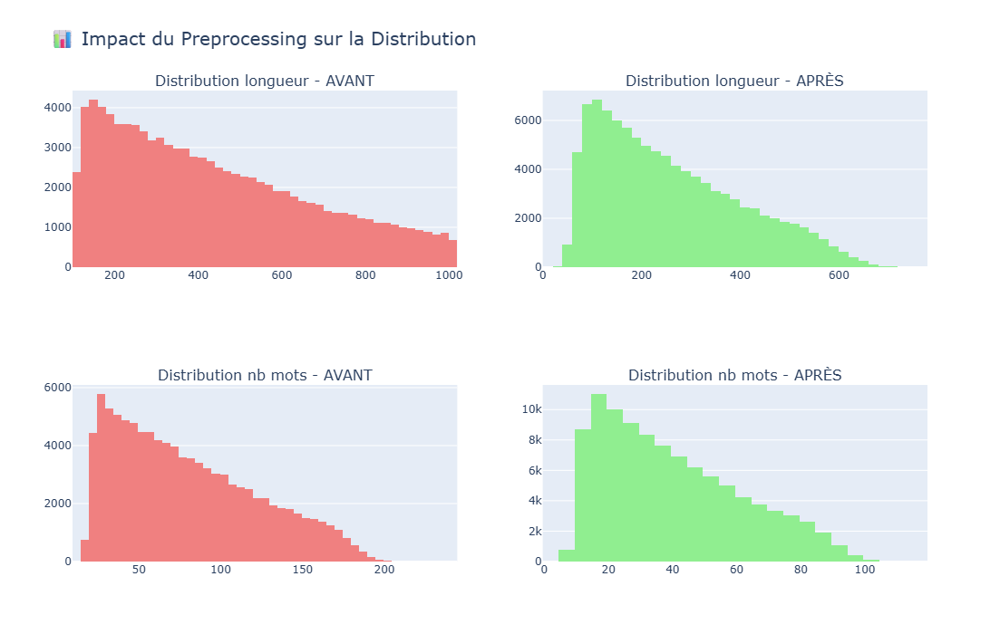

In [82]:
# Visualisation de la comparaison
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=(
        'Distribution longueur - AVANT',
        'Distribution longueur - APRÈS',
        'Distribution nb mots - AVANT',
        'Distribution nb mots - APRÈS'
    )
)

# Longueur avant
fig.add_trace(
    go.Histogram(x=df['text_length'], nbinsx=50, name='Avant', marker_color='lightcoral'),
    row=1, col=1
)

# Longueur après
fig.add_trace(
    go.Histogram(x=df['cleaned_length'], nbinsx=50, name='Après', marker_color='lightgreen'),
    row=1, col=2
)

# Mots avant
fig.add_trace(
    go.Histogram(x=df['word_count'], nbinsx=50, name='Avant', marker_color='lightcoral'),
    row=2, col=1
)

# Mots après
fig.add_trace(
    go.Histogram(x=df['cleaned_word_count'], nbinsx=50, name='Après', marker_color='lightgreen'),
    row=2, col=2
)

fig.update_layout(
    title_text="📊 Impact du Preprocessing sur la Distribution",
    title_font_size=20,
    height=700,
    showlegend=False
)

fig.show()

In [84]:
# ## 📝 Exemples AVANT / APRÈS

print("=" * 80)
print("📝 EXEMPLES DE TRANSFORMATION")
print("=" * 80)

# Sélectionner quelques exemples représentatifs
sample_indices = df.sample(n=5, random_state=42).index

for i, idx in enumerate(sample_indices, 1):
    print(f"\n{'='*80}")
    print(f"Exemple {i} - Sentiment : {df.loc[idx, 'sentiment']}")
    print(f"{'='*80}")
    
    original = df.loc[idx, 'text_original']
    cleaned = df.loc[idx, 'text_cleaned']
    
    print(f"\n🔴 AVANT ({len(original)} car, {len(original.split())} mots) :")
    print(f"   {original[:250]}{'...' if len(original) > 250 else ''}")
    
    print(f"\n🟢 APRÈS ({len(cleaned)} car, {len(cleaned.split())} mots) :")
    print(f"   {cleaned[:250]}{'...' if len(cleaned) > 250 else ''}")
    
    # Calculer la réduction
    reduction = (1 - len(cleaned) / len(original)) * 100
    print(f"\n📉 Réduction : {reduction:.1f}%")

📝 EXEMPLES DE TRANSFORMATION

Exemple 1 - Sentiment : Positif

🔴 AVANT (300 car, 58 mots) :
   I love reading Patricia Cornwell book's: I have read all of Patricia Cornwell's books. I was not happy with Benton dying, but I do like Talley. I hope he will have a bigger part and their relationship go further in her next book. I could not put the ...

🟢 APRÈS (164 car, 26 mots) :
   love reading patricia cornwell book read patricia cornwell book happy benton die like talley hope big part relationship next book could put book finish reading love

📉 Réduction : 45.3%

Exemple 2 - Sentiment : Positif

🔴 AVANT (460 car, 73 mots) :
   Great African Sampler: Lively and danceable, fun African music: Soukous (Zaire/Ivory Coast), Juju (Nigeria), Highlife (Ghana). Some tunes are longer jams.But look for the Sterns pressing that includes two extra tracks, filling the CD with 79 minutes ...

🟢 APRÈS (323 car, 48 mots) :
   great african sampler lively danceable fun african music soukous zaire ivory co

In [86]:
# ## 🔤 Analyse du vocabulaire APRÈS nettoyage

print("\n" + "=" * 80)
print("🔤 ANALYSE DU VOCABULAIRE NETTOYÉ")
print("=" * 80)

# Fonction pour analyser le vocabulaire
def analyze_vocabulary(texts):
    """Analyse le vocabulaire d'une série de textes"""
    all_words = ' '.join(texts).split()
    unique_words = set(all_words)
    word_freq = Counter(all_words)
    
    return {
        'total_words': len(all_words),
        'unique_words': len(unique_words),
        'vocabulary_richness': len(unique_words) / len(all_words),
        'most_common': word_freq.most_common(20)
    }

# Analyser par sentiment
vocab_stats = {}
for sentiment in df['sentiment'].unique():
    texts = df[df['sentiment'] == sentiment]['text_cleaned']
    vocab_stats[sentiment] = analyze_vocabulary(texts)

print("\n📊 Statistiques de vocabulaire par sentiment :\n")
for sentiment, stats in vocab_stats.items():
    print(f"{'='*80}")
    print(f"🏷️ {sentiment.upper()}")
    print(f"{'='*80}")
    print(f"   Total de mots       : {stats['total_words']:,}")
    print(f"   Mots uniques        : {stats['unique_words']:,}")
    print(f"   Richesse vocab.     : {stats['vocabulary_richness']:.4f}")
    print(f"\n   Top 10 mots :")
    for i, (word, count) in enumerate(stats['most_common'][:10], 1):
        print(f"      {i:2d}. {word:15s} : {count:6,}")
    print()


🔤 ANALYSE DU VOCABULAIRE NETTOYÉ

📊 Statistiques de vocabulaire par sentiment :

🏷️ POSITIF
   Total de mots       : 1,999,065
   Mots uniques        : 65,354
   Richesse vocab.     : 0.0327

   Top 10 mots :
       1. book            : 36,575
       2. great           : 24,470
       3. one             : 21,618
       4. good            : 17,564
       5. movie           : 17,347
       6. like            : 16,650
       7. love            : 15,571
       8. read            : 14,914
       9. well            : 14,687
      10. get             : 14,570

🏷️ NÉGATIF
   Total de mots       : 2,005,071
   Mots uniques        : 60,571
   Richesse vocab.     : 0.0302

   Top 10 mots :
       1. book            : 34,519
       2. one             : 20,707
       3. movie           : 19,036
       4. get             : 17,736
       5. like            : 17,305
       6. would           : 16,990
       7. make            : 13,208
       8. good            : 12,846
       9. well            : 12,

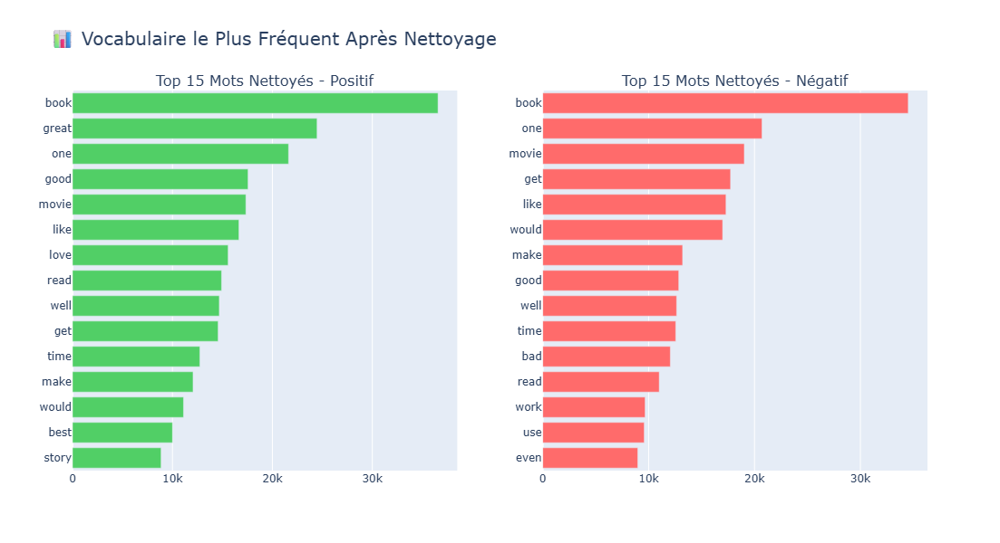

In [88]:
# Visualisation des mots les plus fréquents après nettoyage
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Top 15 Mots Nettoyés - Positif', 'Top 15 Mots Nettoyés - Négatif')
)

for idx, sentiment in enumerate(['Positif', 'Négatif']):
    words, counts = zip(*vocab_stats[sentiment]['most_common'][:15])
    
    fig.add_trace(
        go.Bar(
            y=list(words)[::-1],
            x=list(counts)[::-1],
            orientation='h',
            marker_color='#51cf66' if sentiment == 'Positif' else '#ff6b6b',
            name=sentiment
        ),
        row=1, col=idx+1
    )

fig.update_layout(
    title_text="📊 Vocabulaire le Plus Fréquent Après Nettoyage",
    title_font_size=20,
    height=600,
    showlegend=False
)

fig.show()

In [90]:
# ## 🧹 Nettoyage final et gestion des cas particuliers

print("=" * 80)
print("🧹 NETTOYAGE FINAL")
print("=" * 80)

# Vérifier les textes vides après nettoyage
empty_after_cleaning = df[df['text_cleaned'].str.strip() == '']
print(f"\n📊 Reviews vides après nettoyage : {len(empty_after_cleaning)}")

if len(empty_after_cleaning) > 0:
    print(f"   ⚠️ {len(empty_after_cleaning)} reviews sont devenues vides")
    print(f"   💡 Action : Suppression de ces reviews")
    df = df[df['text_cleaned'].str.strip() != '']
    print(f"   ✅ {len(df):,} reviews restantes")

# Vérifier les reviews très courtes (< 2 mots)
very_short_cleaned = df[df['cleaned_word_count'] < 2]
print(f"\n📊 Reviews très courtes (< 2 mots) : {len(very_short_cleaned)}")

if len(very_short_cleaned) > 0:
    print(f"   ⚠️ {len(very_short_cleaned)} reviews ont moins de 2 mots")
    print(f"   💡 Action : Conservation (peuvent contenir des infos)")
    
    # Afficher quelques exemples
    print(f"\n   Exemples :")
    for idx, row in very_short_cleaned.head(3).iterrows():
        print(f"   - Original : '{row['text_original'][:50]}'")
        print(f"     Nettoyé  : '{row['text_cleaned']}'")
        print()

# Supprimer les doublons sur le texte nettoyé
duplicates_cleaned = df.duplicated(subset=['text_cleaned']).sum()
print(f"\n📊 Doublons après nettoyage : {duplicates_cleaned}")

if duplicates_cleaned > 0:
    print(f"   ⚠️ {duplicates_cleaned} reviews dupliquées trouvées")
    print(f"   💡 Action : Suppression des doublons")
    df = df.drop_duplicates(subset=['text_cleaned'], keep='first')
    print(f"   ✅ {len(df):,} reviews uniques restantes")

🧹 NETTOYAGE FINAL

📊 Reviews vides après nettoyage : 0

📊 Reviews très courtes (< 2 mots) : 0

📊 Doublons après nettoyage : 29
   ⚠️ 29 reviews dupliquées trouvées
   💡 Action : Suppression des doublons
   ✅ 99,971 reviews uniques restantes


In [92]:
# ## 📊 Statistiques finales après preprocessing

print("\n" + "=" * 80)
print("📊 STATISTIQUES FINALES APRÈS PREPROCESSING")
print("=" * 80)

final_stats = f"""
✨ DATASET NETTOYÉ

📈 VOLUME FINAL :
   • Total reviews         : {len(df):,}
   • Reviews positives     : {(df['sentiment'] == 'Positif').sum():,}
   • Reviews négatives     : {(df['sentiment'] == 'Négatif').sum():,}

📏 LONGUEUR MOYENNE :
   • Caractères (avant)    : {df['text_length'].mean():.0f}
   • Caractères (après)    : {df['cleaned_length'].mean():.0f}
   • Mots (avant)          : {df['word_count'].mean():.1f}
   • Mots (après)          : {df['cleaned_word_count'].mean():.1f}

📉 RÉDUCTION :
   • Longueur moyenne      : {((df['text_length'].mean() - df['cleaned_length'].mean()) / df['text_length'].mean() * 100):.1f}%
   • Nombre de mots        : {((df['word_count'].mean() - df['cleaned_word_count'].mean()) / df['word_count'].mean() * 100):.1f}%

🎯 QUALITÉ :
   • Reviews vides         : 0
   • Vocabulaire unique    : {len(set(' '.join(df['text_cleaned']).split())):,} mots
   • Richesse vocabulaire  : {len(set(' '.join(df['text_cleaned']).split())) / len(' '.join(df['text_cleaned']).split()):.4f}

✅ TRANSFORMATIONS APPLIQUÉES :
   1. ✓ Conversion en minuscules
   2. ✓ Suppression URLs, emails, mentions
   3. ✓ Suppression caractères spéciaux
   4. ✓ Gestion des contractions
   5. ✓ Suppression stopwords
   6. ✓ Lemmatisation
   7. ✓ Suppression doublons
   8. ✓ Suppression reviews vides
"""

print(final_stats)


📊 STATISTIQUES FINALES APRÈS PREPROCESSING

✨ DATASET NETTOYÉ

📈 VOLUME FINAL :
   • Total reviews         : 99,971
   • Reviews positives     : 51,255
   • Reviews négatives     : 48,716

📏 LONGUEUR MOYENNE :
   • Caractères (avant)    : 440
   • Caractères (après)    : 259
   • Mots (avant)          : 79.8
   • Mots (après)          : 40.0

📉 RÉDUCTION :
   • Longueur moyenne      : 41.0%
   • Nombre de mots        : 49.8%

🎯 QUALITÉ :
   • Reviews vides         : 0
   • Vocabulaire unique    : 94,367 mots
   • Richesse vocabulaire  : 0.0236

✅ TRANSFORMATIONS APPLIQUÉES :
   1. ✓ Conversion en minuscules
   2. ✓ Suppression URLs, emails, mentions
   3. ✓ Suppression caractères spéciaux
   4. ✓ Gestion des contractions
   5. ✓ Suppression stopwords
   6. ✓ Lemmatisation
   7. ✓ Suppression doublons
   8. ✓ Suppression reviews vides



In [94]:
# ## 💾 Sauvegarde des données nettoyées

print("=" * 80)
print("💾 SAUVEGARDE DES DONNÉES")
print("=" * 80)

# Sélectionner les colonnes importantes pour la modélisation
df_final = df[['text_cleaned', 'sentiment', 'label']].copy()
df_final.rename(columns={'text_cleaned': 'text'}, inplace=True)

# Sauvegarder
output_path = 'amazon_reviews_cleaned.csv'
df_final.to_csv(output_path, index=False)

print(f"\n✅ Données nettoyées sauvegardées !")
print(f"📁 Fichier : {output_path}")
print(f"📊 Nombre de lignes : {len(df_final):,}")
print(f"📋 Colonnes : {list(df_final.columns)}")

# Également sauvegarder la version complète avec toutes les colonnes
output_path_full = 'amazon_reviews_cleaned_full.csv'
df.to_csv(output_path_full, index=False)
print(f"\n💾 Version complète (avec colonnes d'analyse) sauvegardée !")
print(f"📁 Fichier : {output_path_full}")

# Afficher un aperçu du dataset final
print("\n" + "=" * 80)
print("👀 APERÇU DU DATASET FINAL")
print("=" * 80)
display(df_final.head(10))

print("\n" + "=" * 80)
print("✨ ÉTAPE 3 TERMINÉE AVEC SUCCÈS ! ✨")
print("=" * 80)
print("\n🎯 Dataset prêt pour la modélisation !")
print("\n👉 Prochaine étape : Analyse Exploratoire Approfondie (EDA)")

💾 SAUVEGARDE DES DONNÉES

✅ Données nettoyées sauvegardées !
📁 Fichier : amazon_reviews_cleaned.csv
📊 Nombre de lignes : 99,971
📋 Colonnes : ['text', 'sentiment', 'label']

💾 Version complète (avec colonnes d'analyse) sauvegardée !
📁 Fichier : amazon_reviews_cleaned_full.csv

👀 APERÇU DU DATASET FINAL


,text,sentiment,label
0,stun even non gamer sound track beautiful paint senery mind well would recomend even people hate vid game music played game chrono cross game ever played best music back away crude keyboarding tak...,Positif,2
1,best soundtrack ever anything reading lot review say best game soundtrack figure would write review disagree bit opinino yasunori mitsuda ultimate masterpiece music timeless listen year beauty sim...,Positif,2
2,amaze soundtrack favorite music time hand intense sadness prisoner fate mean played game hope distant promise girl stole star important inspiration personally throughout teen year high energy trac...,Positif,2
3,excellent soundtrack truly like soundtrack enjoy video game music played game music enjoy truly relax peaceful disk one favorite scar time life death forest illusion fortress ancient dragon lose f...,Positif,2
4,remember pull jaw floor hearing played game know divine music every single song tell story game good great song without doubt chrono cross time scar magical dreamer wind star sea radical dreamer u...,Positif,2
5,absolute masterpiece quite sure actually take time read played game least heard least track whether aware mitsuda music contribute greatly mood every single minute whole game compose cd quite song...,Positif,2
6,buyer beware self publish book want know read paragraph star review must write haddon family friend perhaps cannot imagine anyone reading whole thing spent even book friend hysteric reading bit pi...,Négatif,1
7,glorious story love whisper wicked saint story amaze pleasantly surprised change book normaly someone romance novel world rave book bought love brilliant story true book wonderful told friend read...,Positif,2
8,five star book finish reading whisper wicked saint fell love caracters expect average romance read instead found one favorite book time thought could predict outcome shock writting descriptive hea...,Positif,2
9,whisper wicked saint easy read book make want keep reading easy put left want read follow hope come soon use read lot gotten away book make want read enjoyable,Positif,2



✨ ÉTAPE 3 TERMINÉE AVEC SUCCÈS ! ✨

🎯 Dataset prêt pour la modélisation !

👉 Prochaine étape : Analyse Exploratoire Approfondie (EDA)


# ÉTAPE 4 : ANALYSE EXPLORATOIRE APPROFONDIE (EDA)

Dans cette section, nous allons :
- Analyser en profondeur les patterns de sentiments
- Identifier les mots discriminants (positifs vs négatifs)
- Créer des visualisations avancées (n-grams, co-occurrences)
- Analyser la polarité et la subjectivité
- Détecter les thèmes et topics par sentiment
- Préparer des insights pour la modélisation

In [100]:
pip install textblob

   ---------------------------------------- 0.0/624.3 kB ? eta -:--:--
   ---------------------------------------- 0.0/624.3 kB ? eta -:--:--
   ---------------------------------------- 0.0/624.3 kB ? eta -:--:--
   ---------------------------------------- 0.0/624.3 kB ? eta -:--:--
   ---------------- ----------------------- 262.1/624.3 kB ? eta -:--:--
   ---------------- ----------------------- 262.1/624.3 kB ? eta -:--:--
   ---------------- ----------------------- 262.1/624.3 kB ? eta -:--:--
   ---------------- ----------------------- 262.1/624.3 kB ? eta -:--:--
   ------------------------------- ------ 524.3/624.3 kB 299.6 kB/s eta 0:00:01
   -------------------------------------- 624.3/624.3 kB 321.9 kB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [102]:
# ## 📦 Import des bibliothèques

# Bibliothèques de base
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

# NLP et analyse de texte
import nltk
from nltk import ngrams
from collections import Counter, defaultdict
from wordcloud import WordCloud
import re

# Analyse de sentiment
from textblob import TextBlob

# Visualisations avancées
from scipy.stats import chi2_contingency
import itertools

# Configuration
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("Set2")
pd.set_option('display.max_columns', None)

print("✅ Bibliothèques importées avec succès !")

✅ Bibliothèques importées avec succès !


In [104]:
# ## 📂 Chargement des données nettoyées

# Charger le dataset nettoyé
df = pd.read_csv('amazon_reviews_cleaned.csv')

print("=" * 80)
print("📊 DONNÉES CHARGÉES")
print("=" * 80)
print(f"Nombre total de reviews : {len(df):,}")
print(f"Colonnes disponibles : {list(df.columns)}")

# Distribution des sentiments
sentiment_dist = df['sentiment'].value_counts()
print(f"\n🏷️ Distribution des sentiments :")
for sentiment, count in sentiment_dist.items():
    pct = count / len(df) * 100
    print(f"   {sentiment:10s} : {count:6,} ({pct:5.2f}%)")

# Aperçu
print("\n👀 Aperçu des données :")
display(df.head())

📊 DONNÉES CHARGÉES
Nombre total de reviews : 99,971
Colonnes disponibles : ['text', 'sentiment', 'label']

🏷️ Distribution des sentiments :
   Positif    : 51,255 (51.27%)
   Négatif    : 48,716 (48.73%)

👀 Aperçu des données :


,text,sentiment,label
0,stun even non gamer sound track beautiful paint senery mind well would recomend even people hate vid game music played game chrono cross game ever played best music back away crude keyboarding tak...,Positif,2
1,best soundtrack ever anything reading lot review say best game soundtrack figure would write review disagree bit opinino yasunori mitsuda ultimate masterpiece music timeless listen year beauty sim...,Positif,2
2,amaze soundtrack favorite music time hand intense sadness prisoner fate mean played game hope distant promise girl stole star important inspiration personally throughout teen year high energy trac...,Positif,2
3,excellent soundtrack truly like soundtrack enjoy video game music played game music enjoy truly relax peaceful disk one favorite scar time life death forest illusion fortress ancient dragon lose f...,Positif,2
4,remember pull jaw floor hearing played game know divine music every single song tell story game good great song without doubt chrono cross time scar magical dreamer wind star sea radical dreamer u...,Positif,2


In [106]:
# ## 🔤 Analyse des N-grams

# ### Qu'est-ce qu'un N-gram ?
# 
# Un **n-gram** est une séquence contiguë de n mots dans un texte :
# - **Unigram (1-gram)** : mots individuels ("great", "product")
# - **Bigram (2-gram)** : paires de mots ("great product", "highly recommend")
# - **Trigram (3-gram)** : triplets de mots ("highly recommend this", "waste of money")
# 
# Les n-grams nous aident à comprendre les **expressions courantes** et le **contexte** des mots.

def get_ngrams(texts, n=2, top_n=20):
    """
    Extrait les n-grams les plus fréquents d'une liste de textes
    
    Parameters:
    -----------
    texts : list/Series
        Liste de textes
    n : int
        Taille du n-gram (2 pour bigram, 3 pour trigram)
    top_n : int
        Nombre de n-grams les plus fréquents à retourner
    
    Returns:
    --------
    list : Liste de tuples (ngram, fréquence)
    """
    all_ngrams = []
    
    for text in texts:
        if pd.notna(text):
            words = str(text).split()
            text_ngrams = list(ngrams(words, n))
            all_ngrams.extend(text_ngrams)
    
    # Compter les occurrences
    ngram_counts = Counter(all_ngrams)
    
    return ngram_counts.most_common(top_n)


def plot_ngrams(ngram_data, title, color='skyblue'):
    """
    Visualise les n-grams sous forme de graphique en barres
    """
    if not ngram_data:
        print("Aucun n-gram trouvé")
        return
    
    ngrams_text = [' '.join(ng[0]) for ng in ngram_data]
    counts = [ng[1] for ng in ngram_data]
    
    fig = go.Figure(data=[
        go.Bar(
            y=ngrams_text[::-1],
            x=counts[::-1],
            orientation='h',
            marker_color=color,
            text=counts[::-1],
            textposition='auto'
        )
    ])
    
    fig.update_layout(
        title=title,
        title_font_size=18,
        xaxis_title="Fréquence",
        yaxis_title="N-grams",
        height=600,
        showlegend=False
    )
    
    return fig

# %%
print("=" * 80)
print("🔤 ANALYSE DES N-GRAMS")
print("=" * 80)

# Séparer les textes par sentiment
positive_texts = df[df['sentiment'] == 'Positif']['text']
negative_texts = df[df['sentiment'] == 'Négatif']['text']

# ========== BIGRAMS (2-grams) ==========
print("\n" + "=" * 80)
print("📊 BIGRAMS (Paires de mots)")
print("=" * 80)

print("\n🟢 Top 15 Bigrams - Avis POSITIFS :")
bigrams_pos = get_ngrams(positive_texts, n=2, top_n=15)
for i, (bigram, count) in enumerate(bigrams_pos, 1):
    print(f"   {i:2d}. {' '.join(bigram):25s} : {count:5,}")

print("\n🔴 Top 15 Bigrams - Avis NÉGATIFS :")
bigrams_neg = get_ngrams(negative_texts, n=2, top_n=15)
for i, (bigram, count) in enumerate(bigrams_neg, 1):
    print(f"   {i:2d}. {' '.join(bigram):25s} : {count:5,}")

🔤 ANALYSE DES N-GRAMS

📊 BIGRAMS (Paires de mots)

🟢 Top 15 Bigrams - Avis POSITIFS :
    1. read book                 : 2,402
    2. one best                  : 1,937
    3. highly recommend          : 1,892
    4. year old                  : 1,517
    5. great book                : 1,509
    6. would recommend           : 1,159
    7. book read                 : 1,119
    8. year ago                  : 1,103
    9. good book                 :   988
   10. great movie               :   961
   11. love book                 :   898
   12. recommend book            :   883
   13. one favorite              :   860
   14. first time                :   823
   15. must read                 :   819

🔴 Top 15 Bigrams - Avis NÉGATIFS :
    1. waste money               : 2,230
    2. waste time                : 1,888
    3. read book                 : 1,751
    4. would recommend           : 1,200
    5. much well                 : 1,157
    6. year old                  : 1,139
    7. look like 

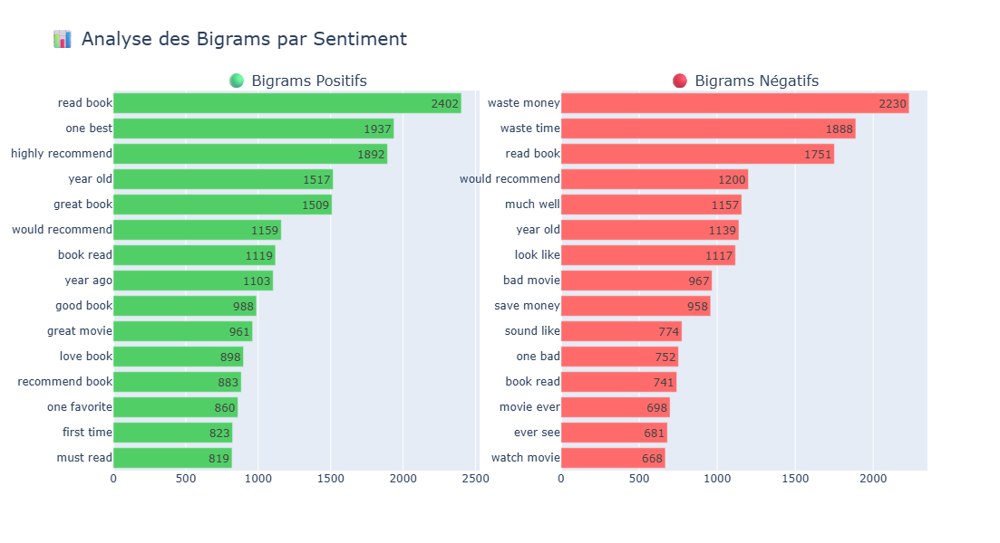

In [108]:
# Visualisation des bigrams
fig_bigrams = make_subplots(
    rows=1, cols=2,
    subplot_titles=('🟢 Bigrams Positifs', '🔴 Bigrams Négatifs')
)

# Positifs
bigrams_pos_text = [' '.join(bg[0]) for bg in bigrams_pos][::-1]
bigrams_pos_count = [bg[1] for bg in bigrams_pos][::-1]

fig_bigrams.add_trace(
    go.Bar(y=bigrams_pos_text, x=bigrams_pos_count, 
           orientation='h', marker_color='#51cf66',
           text=bigrams_pos_count, textposition='auto'),
    row=1, col=1
)

# Négatifs
bigrams_neg_text = [' '.join(bg[0]) for bg in bigrams_neg][::-1]
bigrams_neg_count = [bg[1] for bg in bigrams_neg][::-1]

fig_bigrams.add_trace(
    go.Bar(y=bigrams_neg_text, x=bigrams_neg_count, 
           orientation='h', marker_color='#ff6b6b',
           text=bigrams_neg_count, textposition='auto'),
    row=1, col=2
)

fig_bigrams.update_layout(
    title_text="📊 Analyse des Bigrams par Sentiment",
    title_font_size=20,
    height=600,
    showlegend=False
)

fig_bigrams.show()


📊 TRIGRAMS (Triplets de mots)

🟢 Top 12 Trigrams - Avis POSITIFS :
    1. book ever read                      :   403
    2. best book ever                      :   345
    3. highly recommend book               :   246
    4. one best book                       :   242
    5. would recommend anyone              :   238
    6. would highly recommend              :   225
    7. recommend book anyone               :   220
    8. would recommend book                :   207
    9. best movie ever                     :   141
   10. year old son                        :   139
   11. would definitely recommend          :   134
   12. worth every penny                   :   128

🔴 Top 12 Trigrams - Avis NÉGATIFS :
    1. waste time money                    :   418
    2. bad movie ever                      :   403
    3. book ever read                      :   373
    4. movie ever see                      :   305
    5. bad book ever                       :   297
    6. would recommend book 

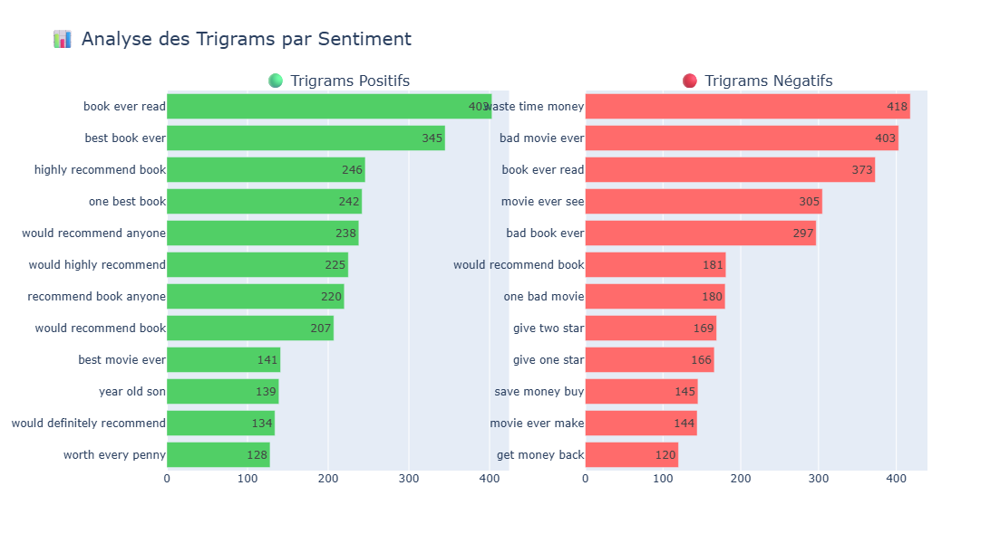

In [110]:
# ========== TRIGRAMS (3-grams) ==========
print("\n" + "=" * 80)
print("📊 TRIGRAMS (Triplets de mots)")
print("=" * 80)

print("\n🟢 Top 12 Trigrams - Avis POSITIFS :")
trigrams_pos = get_ngrams(positive_texts, n=3, top_n=12)
for i, (trigram, count) in enumerate(trigrams_pos, 1):
    print(f"   {i:2d}. {' '.join(trigram):35s} : {count:5,}")

print("\n🔴 Top 12 Trigrams - Avis NÉGATIFS :")
trigrams_neg = get_ngrams(negative_texts, n=3, top_n=12)
for i, (trigram, count) in enumerate(trigrams_neg, 1):
    print(f"   {i:2d}. {' '.join(trigram):35s} : {count:5,}")

# Visualisation des trigrams
fig_trigrams = make_subplots(
    rows=1, cols=2,
    subplot_titles=('🟢 Trigrams Positifs', '🔴 Trigrams Négatifs')
)

# Positifs
trigrams_pos_text = [' '.join(tg[0]) for tg in trigrams_pos][::-1]
trigrams_pos_count = [tg[1] for tg in trigrams_pos][::-1]

fig_trigrams.add_trace(
    go.Bar(y=trigrams_pos_text, x=trigrams_pos_count, 
           orientation='h', marker_color='#51cf66',
           text=trigrams_pos_count, textposition='auto'),
    row=1, col=1
)

# Négatifs
trigrams_neg_text = [' '.join(tg[0]) for tg in trigrams_neg][::-1]
trigrams_neg_count = [tg[1] for tg in trigrams_neg][::-1]

fig_trigrams.add_trace(
    go.Bar(y=trigrams_neg_text, x=trigrams_neg_count, 
           orientation='h', marker_color='#ff6b6b',
           text=trigrams_neg_count, textposition='auto'),
    row=1, col=2
)

fig_trigrams.update_layout(
    title_text="📊 Analyse des Trigrams par Sentiment",
    title_font_size=20,
    height=600,
    showlegend=False
)

fig_trigrams.show()

In [114]:
# ## 🎯 Mots Discriminants (TF-IDF conceptuel)

# ### Qu'est-ce qu'un mot discriminant ?
# 
# Un **mot discriminant** est un mot qui apparaît **beaucoup plus fréquemment** dans un sentiment que dans l'autre.
# 
# Ces mots sont très utiles car :
# - Ils caractérisent fortement un sentiment
# - Ils aident le modèle à faire la différence entre positif et négatif
# - Ils révèlent les thèmes spécifiques à chaque sentiment

import math
from collections import Counter

def find_discriminant_words(pos_texts, neg_texts, top_n=20, min_count=10):
    """
    Trouve les mots les plus discriminants entre avis positifs et négatifs.
    
    Utilise un log-ratio avec smoothing pour éviter les infinis ou div/0
    """
    # Compter les mots
    pos_words = ' '.join(pos_texts).split()
    neg_words = ' '.join(neg_texts).split()
    
    pos_counts = Counter(pos_words)
    neg_counts = Counter(neg_words)
    
    total_pos = sum(pos_counts.values())
    total_neg = sum(neg_counts.values())
    
    # Tous les mots uniques
    all_words = set(pos_counts.keys()) | set(neg_counts.keys())
    
    word_scores = {}
    
    for word in all_words:
        if len(word) < 3:  # ignorer mots trop courts
            continue
        
        # Fréquences avec smoothing
        pos_freq = (pos_counts[word] + 1) / (total_pos + 1)
        neg_freq = (neg_counts[word] + 1) / (total_neg + 1)
        
        # Log-ratio
        log_ratio = math.log(pos_freq / neg_freq)
        
        # Stocker seulement les mots suffisamment fréquents
        if pos_counts[word] >= min_count or neg_counts[word] >= min_count:
            word_scores[word] = {
                'log_ratio': log_ratio,
                'pos_count': pos_counts[word],
                'neg_count': neg_counts[word]
            }
    
    # Trier les mots
    sorted_words = sorted(word_scores.items(), key=lambda x: x[1]['log_ratio'])
    
    # Négatifs : log_ratio < 0, Positifs : log_ratio > 0
    negative_words = [(w, stats) for w, stats in sorted_words if stats['log_ratio'] < 0][:top_n]
    positive_words = [(w, stats) for w, stats in sorted_words if stats['log_ratio'] > 0][-top_n:][::-1]
    
    return positive_words, negative_words

print("="*80)
print("🎯 MOTS DISCRIMINANTS (Mots caractéristiques de chaque sentiment)")
print("="*80)

positive_words, negative_words = find_discriminant_words(positive_texts, negative_texts, top_n=20)

# 🔹 Positifs
print("\n🟢 Top 20 Mots CARACTÉRISTIQUES des avis POSITIFS :")
for i, (word, stats) in enumerate(positive_words, 1):
    print(f"   {i:2d}. {word:15s} | Positif: {stats['pos_count']:5,} | Négatif: {stats['neg_count']:5,} | Log-Ratio: {stats['log_ratio']:6.2f}")

# 🔹 Négatifs
print("\n🔴 Top 20 Mots CARACTÉRISTIQUES des avis NÉGATIFS :")
for i, (word, stats) in enumerate(negative_words, 1):
    print(f"   {i:2d}. {word:15s} | Positif: {stats['pos_count']:5,} | Négatif: {stats['neg_count']:5,} | Log-Ratio: {stats['log_ratio']:6.2f}")


🎯 MOTS DISCRIMINANTS (Mots caractéristiques de chaque sentiment)

🟢 Top 20 Mots CARACTÉRISTIQUES des avis POSITIFS :
    1. frankl          | Positif:    47 | Négatif:     0 | Log-Ratio:   3.87
    2. refreshingly    | Positif:    30 | Négatif:     0 | Log-Ratio:   3.44
    3. foal            | Positif:    24 | Négatif:     0 | Log-Ratio:   3.22
    4. mihaly          | Positif:    24 | Négatif:     0 | Log-Ratio:   3.22
    5. unforgettable   | Positif:    95 | Négatif:     3 | Log-Ratio:   3.18
    6. expertly        | Positif:    20 | Négatif:     0 | Log-Ratio:   3.05
    7. zoid            | Positif:    19 | Négatif:     0 | Log-Ratio:   3.00
    8. wallflower      | Positif:    19 | Négatif:     0 | Log-Ratio:   3.00
    9. lightfoot       | Positif:    18 | Négatif:     0 | Log-Ratio:   2.95
   10. mossflower      | Positif:    18 | Négatif:     0 | Log-Ratio:   2.95
   11. phenominal      | Positif:    18 | Négatif:     0 | Log-Ratio:   2.95
   12. vegeta          | Positif:   

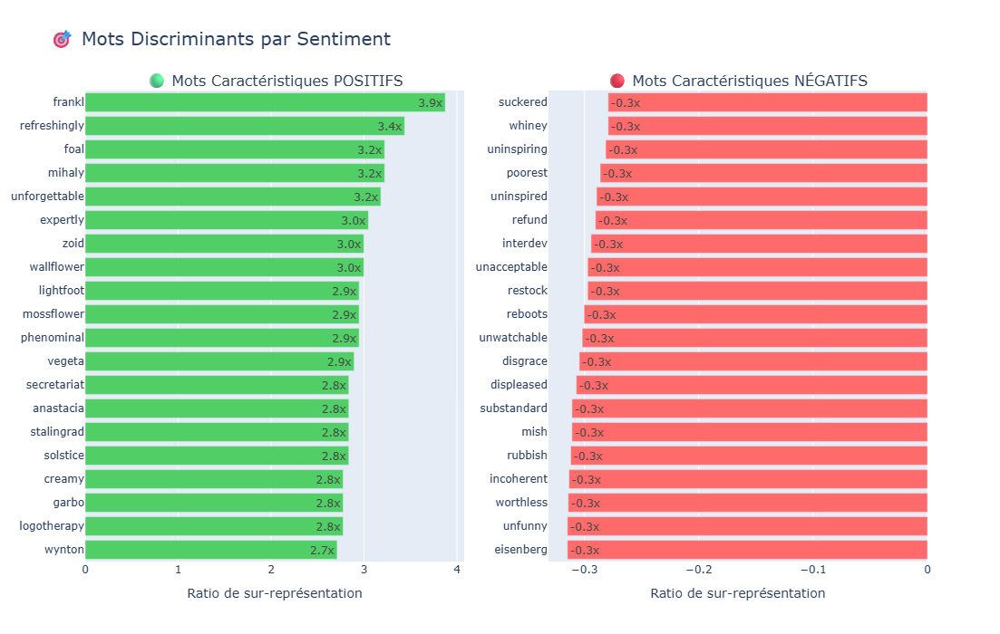

In [118]:
# Visualisation des mots discriminants
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('🟢 Mots Caractéristiques POSITIFS', '🔴 Mots Caractéristiques NÉGATIFS')
)

# Mots positifs
pos_words_list = [w[0] for w in positive_words][::-1]
pos_ratios = [w[1]['log_ratio'] for w in positive_words][::-1]

fig.add_trace(
    go.Bar(
        y=pos_words_list,
        x=pos_ratios,
        orientation='h',
        marker_color='#51cf66',
        text=[f"{r:.1f}x" for r in pos_ratios],
        textposition='auto',
        name='Positif'
    ),
    row=1, col=1
)

# Mots négatifs
neg_words_list = [w[0] for w in negative_words][::-1]
neg_ratios = [1/w[1]['log_ratio'] for w in negative_words][::-1]

fig.add_trace(
    go.Bar(
        y=neg_words_list,
        x=neg_ratios,
        orientation='h',
        marker_color='#ff6b6b',
        text=[f"{r:.1f}x" for r in neg_ratios],
        textposition='auto',
        name='Négatif'
    ),
    row=1, col=2
)

fig.update_xaxes(title_text="Ratio de sur-représentation", row=1, col=1)
fig.update_xaxes(title_text="Ratio de sur-représentation", row=1, col=2)

fig.update_layout(
    title_text="🎯 Mots Discriminants par Sentiment",
    title_font_size=20,
    height=700,
    showlegend=False
)

fig.show()

In [120]:
# ## 📈 Analyse de la Polarité et Subjectivité avec TextBlob

# ### Polarité et Subjectivité - Définitions
# 
# **TextBlob** calcule deux métriques importantes :
# 
# - **Polarité** : Score entre -1 et +1
#   - -1 = Très négatif
#   - 0 = Neutre
#   - +1 = Très positif
# 
# - **Subjectivité** : Score entre 0 et 1
#   - 0 = Très objectif (faits)
#   - 1 = Très subjectif (opinions)

# %%
print("=" * 80)
print("📈 ANALYSE DE POLARITÉ ET SUBJECTIVITÉ")
print("=" * 80)
print("\n⏳ Calcul en cours (peut prendre quelques minutes)...\n")

# Fonction pour calculer polarité et subjectivité
def get_sentiment_scores(text):
    """Calcule la polarité et subjectivité avec TextBlob"""
    try:
        blob = TextBlob(str(text))
        return blob.sentiment.polarity, blob.sentiment.subjectivity
    except:
        return 0, 0

# Appliquer sur un échantillon pour accélérer (ou sur tout le dataset)
sample_size = min(10000, len(df))  # Utiliser 10k 
df_sample = df.sample(n=sample_size, random_state=42).copy()

# Calculer les scores
from tqdm.auto import tqdm
tqdm.pandas(desc="🔄 Analyse")

df_sample[['polarity', 'subjectivity']] = df_sample['text'].progress_apply(
    lambda x: pd.Series(get_sentiment_scores(x))
)

print("✅ Analyse terminée !\n")


📈 ANALYSE DE POLARITÉ ET SUBJECTIVITÉ

⏳ Calcul en cours (peut prendre quelques minutes)...



🔄 Analyse:   0%|          | 0/10000 [00:00<?, ?it/s]

✅ Analyse terminée !



In [122]:
# Statistiques par sentiment
print("=" * 80)
print("📊 STATISTIQUES DE POLARITÉ ET SUBJECTIVITÉ")
print("=" * 80)

for sentiment in df_sample['sentiment'].unique():
    subset = df_sample[df_sample['sentiment'] == sentiment]
    print(f"\n🏷️ {sentiment.upper()} :")
    print(f"   Polarité moyenne      : {subset['polarity'].mean():+.3f}")
    print(f"   Polarité médiane      : {subset['polarity'].median():+.3f}")
    print(f"   Polarité écart-type   : {subset['polarity'].std():.3f}")
    print(f"   Subjectivité moyenne  : {subset['subjectivity'].mean():.3f}")
    print(f"   Subjectivité médiane  : {subset['subjectivity'].median():.3f}")

📊 STATISTIQUES DE POLARITÉ ET SUBJECTIVITÉ

🏷️ NÉGATIF :
   Polarité moyenne      : +0.027
   Polarité médiane      : +0.032
   Polarité écart-type   : 0.224
   Subjectivité moyenne  : 0.499
   Subjectivité médiane  : 0.500

🏷️ POSITIF :
   Polarité moyenne      : +0.290
   Polarité médiane      : +0.275
   Polarité écart-type   : 0.204
   Subjectivité moyenne  : 0.538
   Subjectivité médiane  : 0.535


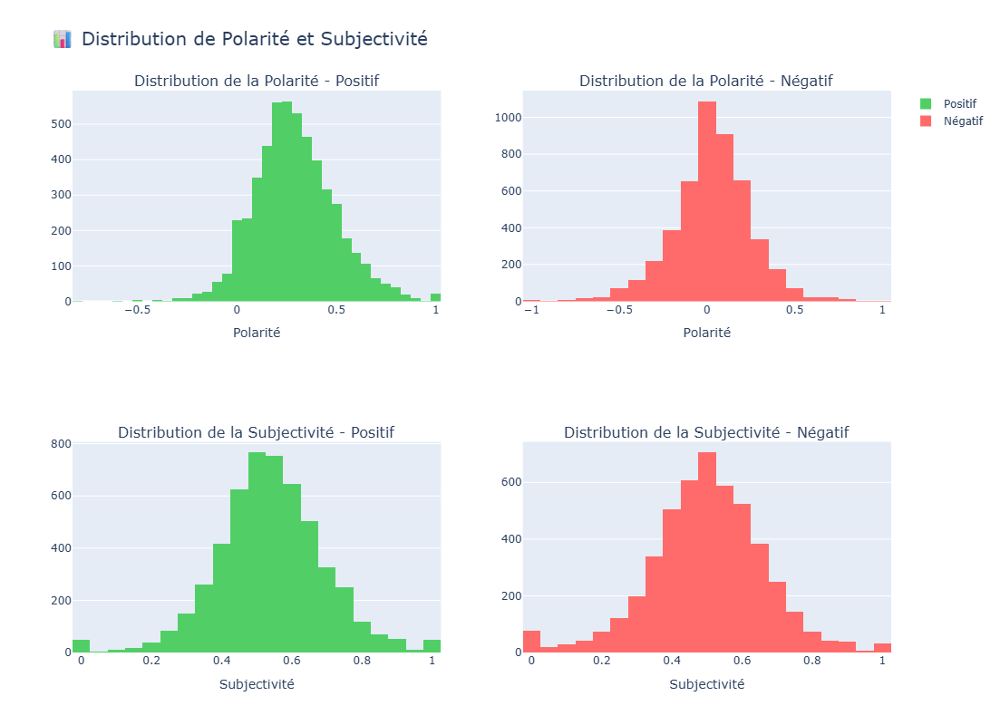

In [124]:
# Visualisation de la polarité et subjectivité
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=(
        'Distribution de la Polarité - Positif',
        'Distribution de la Polarité - Négatif',
        'Distribution de la Subjectivité - Positif',
        'Distribution de la Subjectivité - Négatif'
    )
)

# Polarité - Positif
fig.add_trace(
    go.Histogram(
        x=df_sample[df_sample['sentiment'] == 'Positif']['polarity'],
        nbinsx=40,
        marker_color='#51cf66',
        name='Positif'
    ),
    row=1, col=1
)

# Polarité - Négatif
fig.add_trace(
    go.Histogram(
        x=df_sample[df_sample['sentiment'] == 'Négatif']['polarity'],
        nbinsx=40,
        marker_color='#ff6b6b',
        name='Négatif'
    ),
    row=1, col=2
)

# Subjectivité - Positif
fig.add_trace(
    go.Histogram(
        x=df_sample[df_sample['sentiment'] == 'Positif']['subjectivity'],
        nbinsx=40,
        marker_color='#51cf66',
        showlegend=False
    ),
    row=2, col=1
)

# Subjectivité - Négatif
fig.add_trace(
    go.Histogram(
        x=df_sample[df_sample['sentiment'] == 'Négatif']['subjectivity'],
        nbinsx=40,
        marker_color='#ff6b6b',
        showlegend=False
    ),
    row=2, col=2
)

fig.update_xaxes(title_text="Polarité", row=1, col=1)
fig.update_xaxes(title_text="Polarité", row=1, col=2)
fig.update_xaxes(title_text="Subjectivité", row=2, col=1)
fig.update_xaxes(title_text="Subjectivité", row=2, col=2)

fig.update_layout(
    title_text="📊 Distribution de Polarité et Subjectivité",
    title_font_size=20,
    height=800,
    showlegend=True
)

fig.show()

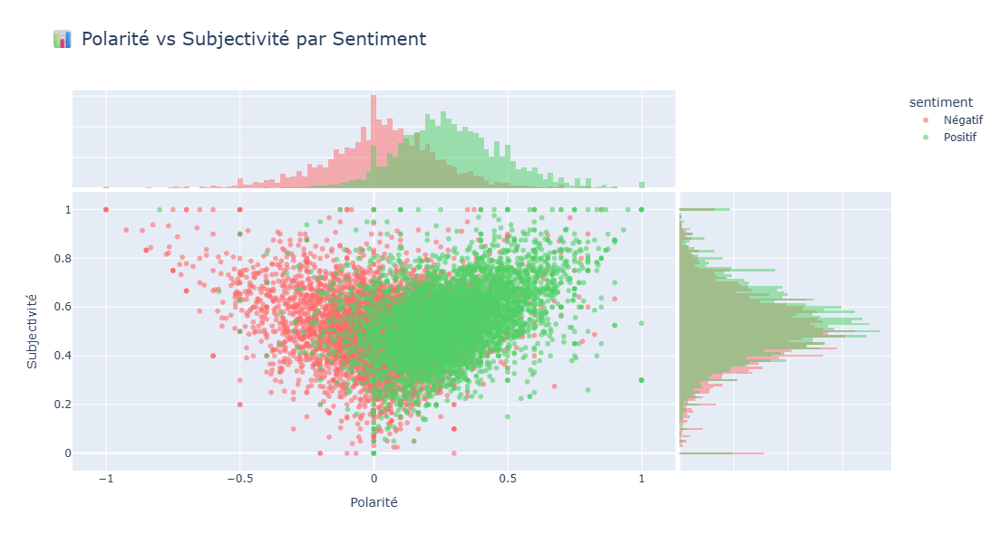

In [126]:
# Scatter plot Polarité vs Subjectivité
fig = px.scatter(
    df_sample,
    x='polarity',
    y='subjectivity',
    color='sentiment',
    color_discrete_map={'Positif': '#51cf66', 'Négatif': '#ff6b6b'},
    title='📊 Polarité vs Subjectivité par Sentiment',
    labels={'polarity': 'Polarité', 'subjectivity': 'Subjectivité'},
    opacity=0.6,
    marginal_x='histogram',
    marginal_y='histogram'
)

fig.update_layout(
    title_font_size=20,
    height=600
)

fig.show()

📏 ANALYSE DÉTAILLÉE DE LA LONGUEUR DES TEXTES

📊 Statistiques de longueur par sentiment :



,count,mean,std,min,25%,50%,75%,max
sentiment,,,,,,,,
Négatif,48716.0,41.139851,21.510228,4.0,23.0,38.0,56.0,116.0
Positif,51255.0,38.991942,22.002298,4.0,20.0,34.0,54.0,116.0



📈 Test de significativité (T-test) :
   Statistique t : -15.5972
   P-value       : 0.000000
   Conclusion    : ✅ Différence SIGNIFICATIVE entre les longueurs


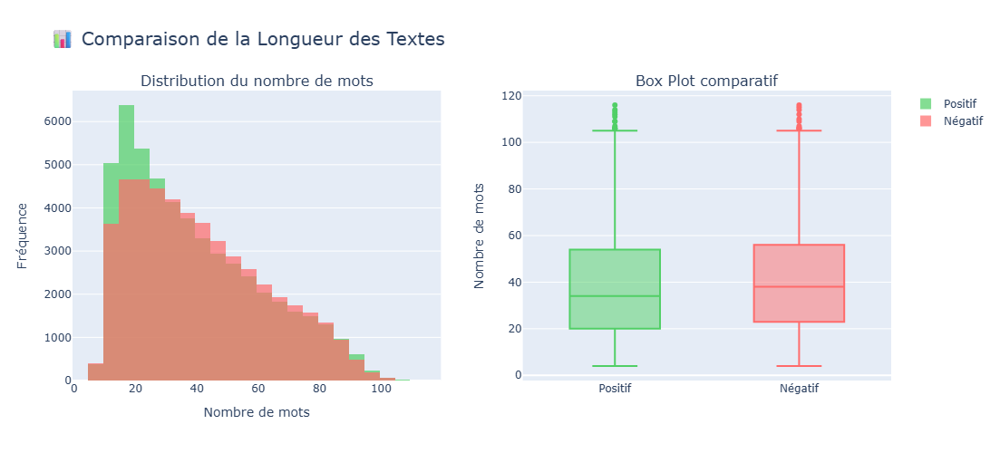

In [128]:
# ## 📊 Analyse de la Longueur des Textes par Sentiment

# %%
print("=" * 80)
print("📏 ANALYSE DÉTAILLÉE DE LA LONGUEUR DES TEXTES")
print("=" * 80)

# Ajouter colonnes de longueur si elles n'existent pas
if 'word_count' not in df.columns:
    df['word_count'] = df['text'].str.split().str.len()

# Statistiques détaillées
print("\n📊 Statistiques de longueur par sentiment :\n")

length_stats = df.groupby('sentiment')['word_count'].describe()
display(length_stats)

# Test statistique
from scipy import stats

pos_lengths = df[df['sentiment'] == 'Positif']['word_count']
neg_lengths = df[df['sentiment'] == 'Négatif']['word_count']

# T-test
t_stat, p_value = stats.ttest_ind(pos_lengths, neg_lengths)

print(f"\n📈 Test de significativité (T-test) :")
print(f"   Statistique t : {t_stat:.4f}")
print(f"   P-value       : {p_value:.6f}")
print(f"   Conclusion    : ", end="")
if p_value < 0.05:
    print("✅ Différence SIGNIFICATIVE entre les longueurs")
else:
    print("⚠️ Différence NON significative")

# Visualisation comparative des longueurs
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Distribution du nombre de mots', 'Box Plot comparatif')
)

# Histogrammes superposés
for sentiment, color in [('Positif', '#51cf66'), ('Négatif', '#ff6b6b')]:
    subset = df[df['sentiment'] == sentiment]['word_count']
    fig.add_trace(
        go.Histogram(
            x=subset,
            name=sentiment,
            marker_color=color,
            opacity=0.7,
            nbinsx=50
        ),
        row=1, col=1
    )

# Box plots
for sentiment, color in [('Positif', '#51cf66'), ('Négatif', '#ff6b6b')]:
    subset = df[df['sentiment'] == sentiment]['word_count']
    fig.add_trace(
        go.Box(
            y=subset,
            name=sentiment,
            marker_color=color,
            showlegend=False
        ),
        row=1, col=2
    )

fig.update_xaxes(title_text="Nombre de mots", row=1, col=1)
fig.update_yaxes(title_text="Fréquence", row=1, col=1)
fig.update_yaxes(title_text="Nombre de mots", row=1, col=2)

fig.update_layout(
    title_text="📊 Comparaison de la Longueur des Textes",
    title_font_size=20,
    height=500,
    barmode='overlay'
)

fig.show()

☁️ GÉNÉRATION DE WORD CLOUDS AVANCÉS


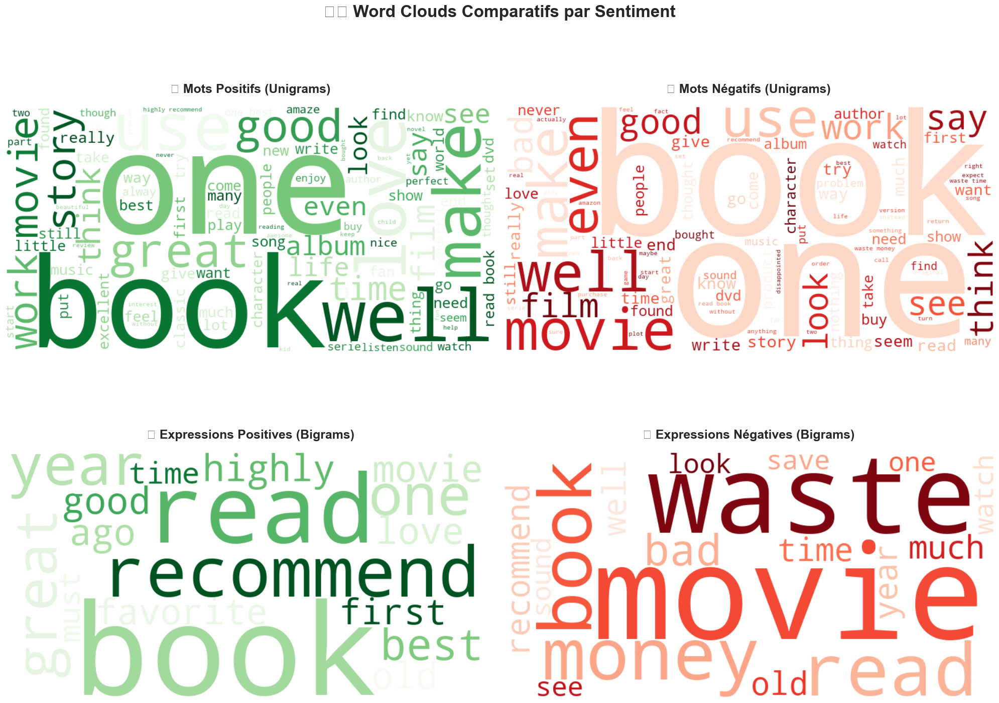

In [130]:
# ## 🌈 Word Clouds Améliorés

print("=" * 80)
print("☁️ GÉNÉRATION DE WORD CLOUDS AVANCÉS")
print("=" * 80)

# Créer des word clouds plus sophistiqués
from wordcloud import WordCloud
import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 2, figsize=(20, 16))
fig.suptitle('☁️ Word Clouds Comparatifs par Sentiment', fontsize=24, fontweight='bold', y=0.98)

# Configuration des word clouds
wc_config = {
    'width': 800,
    'height': 400,
    'background_color': 'white',
    'max_words': 100,
    'relative_scaling': 0.5,
    'min_font_size': 10,
    'colormap': None  # Sera défini par sentiment
}

# POSITIFS - Unigrams
pos_text = ' '.join(positive_texts)
wc_pos_uni = WordCloud(**{**wc_config, 'colormap': 'Greens'}).generate(pos_text)
axes[0, 0].imshow(wc_pos_uni, interpolation='bilinear')
axes[0, 0].set_title('🟢 Mots Positifs (Unigrams)', fontsize=18, fontweight='bold', pad=20)
axes[0, 0].axis('off')

# NÉGATIFS - Unigrams
neg_text = ' '.join(negative_texts)
wc_neg_uni = WordCloud(**{**wc_config, 'colormap': 'Reds'}).generate(neg_text)
axes[0, 1].imshow(wc_neg_uni, interpolation='bilinear')
axes[0, 1].set_title('🔴 Mots Négatifs (Unigrams)', fontsize=18, fontweight='bold', pad=20)
axes[0, 1].axis('off')

# POSITIFS - Bigrams
pos_bigrams_text = ' '.join([' '.join(bg[0]) for bg in bigrams_pos])
wc_pos_bi = WordCloud(**{**wc_config, 'colormap': 'Greens'}).generate(pos_bigrams_text)
axes[1, 0].imshow(wc_pos_bi, interpolation='bilinear')
axes[1, 0].set_title('🟢 Expressions Positives (Bigrams)', fontsize=18, fontweight='bold', pad=20)
axes[1, 0].axis('off')

# NÉGATIFS - Bigrams
neg_bigrams_text = ' '.join([' '.join(bg[0]) for bg in bigrams_neg])
wc_neg_bi = WordCloud(**{**wc_config, 'colormap': 'Reds'}).generate(neg_bigrams_text)
axes[1, 1].imshow(wc_neg_bi, interpolation='bilinear')
axes[1, 1].set_title('🔴 Expressions Négatives (Bigrams)', fontsize=18, fontweight='bold', pad=20)
axes[1, 1].axis('off')

plt.tight_layout()
plt.show()

📊 MATRICE DE CO-OCCURRENCE DES MOTS

⏳ Calcul en cours...

✅ Matrices créées !



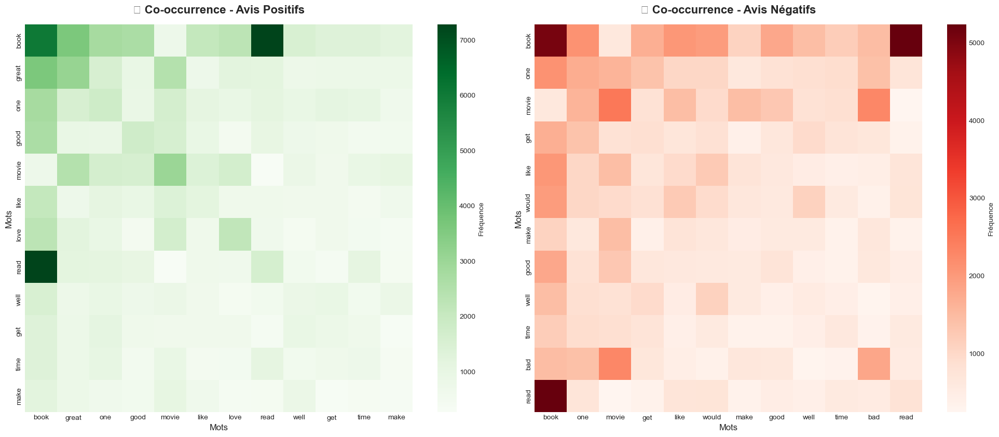

In [132]:
# ## 📊 Matrice de Co-occurrence des Mots

# ### Qu'est-ce qu'une matrice de co-occurrence ?
# 
# Une **matrice de co-occurrence** montre quels mots apparaissent **souvent ensemble** dans les textes.
# 
# Cela nous aide à comprendre :
# - Les associations de mots typiques
# - Le contexte sémantique
# - Les thèmes récurrents

def create_cooccurrence_matrix(texts, top_words=15, window_size=5):
    """
    Crée une matrice de co-occurrence des mots
    
    Parameters:
    -----------
    texts : Series
        Textes à analyser
    top_words : int
        Nombre de mots les plus fréquents à inclure
    window_size : int
        Taille de la fenêtre de contexte
    """
    # Obtenir les mots les plus fréquents
    all_words = ' '.join(texts).split()
    word_counts = Counter(all_words)
    top_words_list = [word for word, count in word_counts.most_common(top_words)]
    
    # Initialiser la matrice
    cooccurrence = defaultdict(lambda: defaultdict(int))
    
    # Calculer les co-occurrences
    for text in texts:
        words = str(text).split()
        for i, word in enumerate(words):
            if word in top_words_list:
                # Regarder dans une fenêtre autour du mot
                start = max(0, i - window_size)
                end = min(len(words), i + window_size + 1)
                
                for j in range(start, end):
                    if i != j and words[j] in top_words_list:
                        cooccurrence[word][words[j]] += 1
    
    # Convertir en DataFrame
    matrix = pd.DataFrame(0, index=top_words_list, columns=top_words_list)
    for word1 in top_words_list:
        for word2 in top_words_list:
            matrix.loc[word1, word2] = cooccurrence[word1][word2]
    
    return matrix

print("=" * 80)
print("📊 MATRICE DE CO-OCCURRENCE DES MOTS")
print("=" * 80)
print("\n⏳ Calcul en cours...\n")

# Créer les matrices pour chaque sentiment
cooc_pos = create_cooccurrence_matrix(positive_texts, top_words=12, window_size=3)
cooc_neg = create_cooccurrence_matrix(negative_texts, top_words=12, window_size=3)

print("✅ Matrices créées !\n")

# Visualisation des matrices de co-occurrence
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# Positif
sns.heatmap(
    cooc_pos,
    cmap='Greens',
    annot=False,
    fmt='d',
    cbar_kws={'label': 'Fréquence'},
    ax=axes[0],
    square=True
)
axes[0].set_title('🟢 Co-occurrence - Avis Positifs', fontsize=16, fontweight='bold', pad=15)
axes[0].set_xlabel('Mots', fontsize=12)
axes[0].set_ylabel('Mots', fontsize=12)

# Négatif
sns.heatmap(
    cooc_neg,
    cmap='Reds',
    annot=False,
    fmt='d',
    cbar_kws={'label': 'Fréquence'},
    ax=axes[1],
    square=True
)
axes[1].set_title('🔴 Co-occurrence - Avis Négatifs', fontsize=16, fontweight='bold', pad=15)
axes[1].set_xlabel('Mots', fontsize=12)
axes[1].set_ylabel('Mots', fontsize=12)

plt.tight_layout()
plt.show()

In [134]:
# ## 💡 Insights et Observations Clés

print("\n" + "=" * 80)
print("💡 INSIGHTS CLÉS DE L'ANALYSE EXPLORATOIRE")
print("=" * 80)

# Calculer quelques métriques intéressantes
pos_avg_words = df[df['sentiment'] == 'Positif']['word_count'].mean()
neg_avg_words = df[df['sentiment'] == 'Négatif']['word_count'].mean()

top_pos_word = positive_words[0][0] if positive_words else "N/A"
top_neg_word = negative_words[0][0] if negative_words else "N/A"

top_pos_bigram = ' '.join(bigrams_pos[0][0]) if bigrams_pos else "N/A"
top_neg_bigram = ' '.join(bigrams_neg[0][0]) if bigrams_neg else "N/A"

insights = f"""
🎯 DÉCOUVERTES PRINCIPALES :

1. 📏 LONGUEUR DES TEXTES :
   • Les avis positifs contiennent en moyenne {pos_avg_words:.1f} mots
   • Les avis négatifs contiennent en moyenne {neg_avg_words:.1f} mots
   • Différence : {abs(pos_avg_words - neg_avg_words):.1f} mots
   
2. 🔤 VOCABULAIRE CARACTÉRISTIQUE :
   • Mot le plus caractéristique POSITIF : "{top_pos_word}"
   • Mot le plus caractéristique NÉGATIF : "{top_neg_word}"
   
3. 💬 EXPRESSIONS COURANTES :
   • Expression positive fréquente : "{top_pos_bigram}"
   • Expression négative fréquente : "{top_neg_bigram}"
   
4. 📊 POLARITÉ (TextBlob) :
   • Les avis positifs ont une polarité moyenne de {df_sample[df_sample['sentiment'] == 'Positif']['polarity'].mean():+.3f}
   • Les avis négatifs ont une polarité moyenne de {df_sample[df_sample['sentiment'] == 'Négatif']['polarity'].mean():+.3f}
   
5. 🎨 SUBJECTIVITÉ :
   • Subjectivité moyenne (Positif) : {df_sample[df_sample['sentiment'] == 'Positif']['subjectivity'].mean():.3f}
   • Subjectivité moyenne (Négatif) : {df_sample[df_sample['sentiment'] == 'Négatif']['subjectivity'].mean():.3f}

📈 IMPLICATIONS POUR LA MODÉLISATION :

✅ Les sentiments ont des vocabulaires distincts → Bon signe pour la classification
✅ Les bigrams/trigrams sont discriminants → Envisager des features n-grams
✅ Polarité TextBlob corrèle avec le sentiment → Peut être une feature
✅ Longueur variable selon sentiment → Peut influencer la prédiction

🎯 RECOMMANDATIONS :

1. Utiliser des features TF-IDF avec n-grams (unigrams + bigrams)
2. Tester des modèles capables de capturer les séquences (LSTM, Transformers)
3. Considérer la longueur du texte comme feature additionnelle
4. Équilibrer le dataset si nécessaire
5. Faire attention à l'overfitting sur les mots très spécifiques
"""

print(insights)


💡 INSIGHTS CLÉS DE L'ANALYSE EXPLORATOIRE

🎯 DÉCOUVERTES PRINCIPALES :

1. 📏 LONGUEUR DES TEXTES :
   • Les avis positifs contiennent en moyenne 39.0 mots
   • Les avis négatifs contiennent en moyenne 41.1 mots
   • Différence : 2.1 mots
   
2. 🔤 VOCABULAIRE CARACTÉRISTIQUE :
   • Mot le plus caractéristique POSITIF : "frankl"
   • Mot le plus caractéristique NÉGATIF : "suckered"
   
3. 💬 EXPRESSIONS COURANTES :
   • Expression positive fréquente : "read book"
   • Expression négative fréquente : "waste money"
   
4. 📊 POLARITÉ (TextBlob) :
   • Les avis positifs ont une polarité moyenne de +0.290
   • Les avis négatifs ont une polarité moyenne de +0.027
   
5. 🎨 SUBJECTIVITÉ :
   • Subjectivité moyenne (Positif) : 0.538
   • Subjectivité moyenne (Négatif) : 0.499

📈 IMPLICATIONS POUR LA MODÉLISATION :

✅ Les sentiments ont des vocabulaires distincts → Bon signe pour la classification
✅ Les bigrams/trigrams sont discriminants → Envisager des features n-grams
✅ Polarité TextBlob corrèl

In [136]:
# ## 💾 Sauvegarde des insights

# Sauvegarder les statistiques importantes
eda_results = {
    'bigrams_positive': bigrams_pos,
    'bigrams_negative': bigrams_neg,
    'trigrams_positive': trigrams_pos,
    'trigrams_negative': trigrams_neg,
    'discriminant_positive': positive_words,
    'discriminant_negative': negative_words
}

# Sauvegarder avec pickle
import pickle

with open('eda_results.pkl', 'wb') as f:
    pickle.dump(eda_results, f)

print("=" * 80)
print("💾 SAUVEGARDE DES RÉSULTATS")
print("=" * 80)
print("\n✅ Résultats EDA sauvegardés dans 'eda_results.pkl'")

print("\n" + "=" * 80)
print("✨ ÉTAPE 4 TERMINÉE AVEC SUCCÈS ! ✨")
print("=" * 80)
print("\n🎯 Nous avons maintenant une compréhension approfondie de nos données !")
print("👉 Prochaine étape : Vectorisation et Feature Engineering")

💾 SAUVEGARDE DES RÉSULTATS

✅ Résultats EDA sauvegardés dans 'eda_results.pkl'

✨ ÉTAPE 4 TERMINÉE AVEC SUCCÈS ! ✨

🎯 Nous avons maintenant une compréhension approfondie de nos données !
👉 Prochaine étape : Vectorisation et Feature Engineering


# ÉTAPE 5 : VECTORISATION ET FEATURE ENGINEERING

 Dans cette section, nous allons :
- Transformer le texte en représentations numériques
- Comparer différentes techniques de vectorisation (Bag of Words, TF-IDF, Word2Vec)
- Créer des features additionnelles (longueur, polarité, etc.)
- Préparer les données pour l'entraînement
- Effectuer le split train/validation/test
- Analyser la dimensionnalité et les features importantes

In [140]:
# ## 📦 Import des bibliothèques

# Bibliothèques de base
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

# Scikit-learn pour vectorisation et preprocessing
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Word2Vec et modèles avancés
from gensim.models import Word2Vec
import gensim.downloader as api

# TextBlob pour features additionnelles
from textblob import TextBlob

# Utilitaires
from collections import Counter
import pickle
from tqdm.auto import tqdm

# Configuration
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("husl")
pd.set_option('display.max_columns', None)

In [142]:
# ## 📂 Chargement des données

# Charger le dataset nettoyé
df = pd.read_csv('amazon_reviews_cleaned.csv')

print("=" * 80)
print("📊 DONNÉES CHARGÉES")
print("=" * 80)
print(f"Nombre total de reviews : {len(df):,}")
print(f"Colonnes : {list(df.columns)}")

📊 DONNÉES CHARGÉES
Nombre total de reviews : 99,971
Colonnes : ['text', 'sentiment', 'label']


In [144]:
# Distribution
sentiment_dist = df['sentiment'].value_counts()
print(f"\n🏷️ Distribution :")
for sentiment, count in sentiment_dist.items():
    print(f"   {sentiment:10s} : {count:6,} ({count/len(df)*100:.2f}%)")

display(df.head())


🏷️ Distribution :
   Positif    : 51,255 (51.27%)
   Négatif    : 48,716 (48.73%)


,text,sentiment,label
0,stun even non gamer sound track beautiful paint senery mind well would recomend even people hate vid game music played game chrono cross game ever played best music back away crude keyboarding tak...,Positif,2
1,best soundtrack ever anything reading lot review say best game soundtrack figure would write review disagree bit opinino yasunori mitsuda ultimate masterpiece music timeless listen year beauty sim...,Positif,2
2,amaze soundtrack favorite music time hand intense sadness prisoner fate mean played game hope distant promise girl stole star important inspiration personally throughout teen year high energy trac...,Positif,2
3,excellent soundtrack truly like soundtrack enjoy video game music played game music enjoy truly relax peaceful disk one favorite scar time life death forest illusion fortress ancient dragon lose f...,Positif,2
4,remember pull jaw floor hearing played game know divine music every single song tell story game good great song without doubt chrono cross time scar magical dreamer wind star sea radical dreamer u...,Positif,2


In [146]:
# ## 🎯 Préparation des variables cibles

print("=" * 80)
print("🎯 ENCODAGE DES LABELS")
print("=" * 80)

# Encoder les sentiments en valeurs numériques
label_encoder = LabelEncoder()
df['label_encoded'] = label_encoder.fit_transform(df['sentiment'])

# Afficher le mapping
print("\n📋 Mapping des labels :")
for i, sentiment in enumerate(label_encoder.classes_):
    print(f"   {sentiment:10s} → {i}")

# Vérification
print(f"\n✅ Labels encodés :")
print(f"   Classes : {label_encoder.classes_}")
print(f"   Distribution : {dict(zip(*np.unique(df['label_encoded'], return_counts=True)))}")

🎯 ENCODAGE DES LABELS

📋 Mapping des labels :
   Négatif    → 0
   Positif    → 1

✅ Labels encodés :
   Classes : ['Négatif' 'Positif']
   Distribution : {0: 48716, 1: 51255}


In [150]:
# ## 📏 Feature Engineering - Features Additionnelles

# ### Pourquoi créer des features additionnelles ?
# 
# En plus du texte lui-même, certaines **caractéristiques méta** peuvent améliorer la prédiction :
# - **Longueur du texte** : Les avis positifs sont-ils plus longs ?
# - **Polarité** : Score de sentiment calculé par TextBlob
# - **Subjectivité** : Le texte est-il factuel ou opiné ?
# - **Ponctuation** : Nombre de points d'exclamation, etc.

# Ces features peuvent capturer des patterns que le texte seul ne révèle pas.

print("=" * 80)
print("🔧 CRÉATION DE FEATURES ADDITIONNELLES")
print("=" * 80)

def extract_additional_features(text):
    """
    Extrait des features additionnelles d'un texte
    
    Returns:
    --------
    dict : Dictionnaire de features
    """
    if pd.isna(text):
        return {
            'char_count': 0,
            'word_count': 0,
            'avg_word_length': 0,
            'exclamation_count': 0,
            'question_count': 0,
            'uppercase_ratio': 0,
            'polarity': 0,
            'subjectivity': 0
        }
    
    text_str = str(text)
    words = text_str.split()
    
    # Features basiques
    char_count = len(text_str)
    word_count = len(words)
    avg_word_length = np.mean([len(word) for word in words]) if words else 0
    
    # Ponctuation
    exclamation_count = text_str.count('!')
    question_count = text_str.count('?')
    
    # Majuscules (ratio de mots en majuscules)
    uppercase_words = sum(1 for word in words if word.isupper() and len(word) > 1)
    uppercase_ratio = uppercase_words / word_count if word_count > 0 else 0
    
    # Sentiment (TextBlob) - utiliser le texte original si disponible
    try:
        blob = TextBlob(text_str)
        polarity = blob.sentiment.polarity
        subjectivity = blob.sentiment.subjectivity
    except:
        polarity = 0
        subjectivity = 0
    
    return {
        'char_count': char_count,
        'word_count': word_count,
        'avg_word_length': avg_word_length,
        'exclamation_count': exclamation_count,
        'question_count': question_count,
        'uppercase_ratio': uppercase_ratio,
        'polarity': polarity,
        'subjectivity': subjectivity
    }

# Appliquer l'extraction (sur un échantillon pour la démo de polarité/subjectivité)
print("\n⏳ Extraction des features en cours...\n")

# Pour accélérer, on peut extraire seulement sur un échantillon pour polarity/subjectivity
# et calculer les autres features sur tout le dataset
tqdm.pandas(desc="🔄 Features")

# Features rapides (sans TextBlob)
df['char_count'] = df['text'].str.len()
df['word_count'] = df['text'].str.split().str.len()
df['avg_word_length'] = df['text'].apply(lambda x: np.mean([len(w) for w in str(x).split()]) if str(x).split() else 0)
df['exclamation_count'] = df['text'].str.count(r'!')
df['question_count'] = df['text'].str.count(r'\?')

# Features TextBlob (plus lentes - sur échantillon)
sample_size = min(10000, len(df))
sample_indices = np.random.choice(df.index, sample_size, replace=False)

print(f"Calcul de polarité/subjectivité sur {sample_size:,} reviews...")

for idx in tqdm(sample_indices, desc="TextBlob"):
    text = df.loc[idx, 'text']
    try:
        blob = TextBlob(str(text))
        df.loc[idx, 'polarity'] = blob.sentiment.polarity
        df.loc[idx, 'subjectivity'] = blob.sentiment.subjectivity
    except:
        df.loc[idx, 'polarity'] = 0
        df.loc[idx, 'subjectivity'] = 0

# Remplir les valeurs manquantes avec la moyenne par sentiment
for col in ['polarity', 'subjectivity']:
    if df[col].isna().any():
        df[col] = df.groupby('sentiment')[col].transform(lambda x: x.fillna(x.mean()))

print("\n✅ Features additionnelles créées !")

# Afficher les statistiques
print("\n" + "=" * 80)
print("📊 STATISTIQUES DES FEATURES ADDITIONNELLES")
print("=" * 80)

feature_cols = ['char_count', 'word_count', 'avg_word_length', 'exclamation_count', 
                'question_count', 'polarity', 'subjectivity']

print("\n🔢 Statistiques globales :")
display(df[feature_cols].describe())

print("\n📊 Statistiques par sentiment :")
display(df.groupby('sentiment')[feature_cols].mean())

🔧 CRÉATION DE FEATURES ADDITIONNELLES

⏳ Extraction des features en cours...

Calcul de polarité/subjectivité sur 10,000 reviews...


TextBlob:   0%|          | 0/10000 [00:00<?, ?it/s]


✅ Features additionnelles créées !

📊 STATISTIQUES DES FEATURES ADDITIONNELLES

🔢 Statistiques globales :


,char_count,word_count,avg_word_length,exclamation_count,question_count,polarity,subjectivity
count,99971.000000,99971.000000,99971.000000,99971.0,99971.0,99971.000000,99971.000000
mean,259.264227,40.038621,5.474390,0.0,0.0,0.160548,0.518423
std,145.048225,21.790257,0.554836,0.0,0.0,0.147165,0.053194
min,19.000000,4.000000,3.447368,0.0,0.0,-1.000000,0.000000
25%,138.000000,22.000000,5.103448,0.0,0.0,0.026595,0.499861
50%,230.000000,36.000000,5.440000,0.0,0.0,0.228052,0.536066
75%,358.000000,55.000000,5.804878,0.0,0.0,0.287865,0.536066
max,766.000000,116.000000,34.714286,0.0,0.0,1.000000,1.000000



📊 Statistiques par sentiment :


,char_count,word_count,avg_word_length,exclamation_count,question_count,polarity,subjectivity
sentiment,,,,,,,
Négatif,265.814907,41.139851,5.462478,0.0,0.0,0.026595,0.499861
Positif,253.038045,38.991942,5.485711,0.0,0.0,0.287865,0.536066


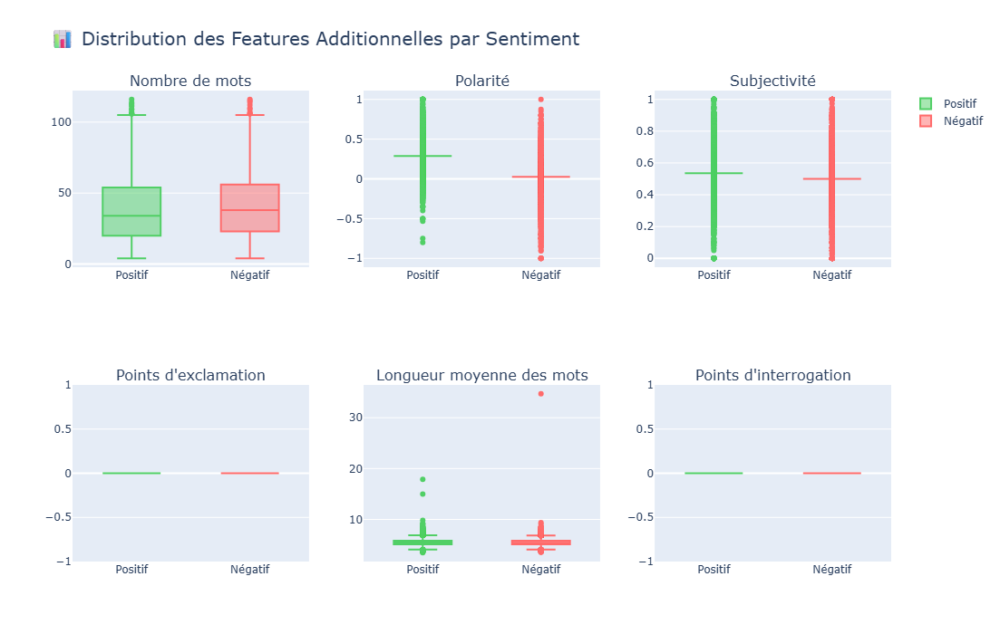

In [152]:
# Visualisation des features additionnelles
fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=(
        'Nombre de mots',
        'Polarité',
        'Subjectivité',
        'Points d\'exclamation',
        'Longueur moyenne des mots',
        'Points d\'interrogation'
    )
)

features_to_plot = [
    ('word_count', 1, 1),
    ('polarity', 1, 2),
    ('subjectivity', 1, 3),
    ('exclamation_count', 2, 1),
    ('avg_word_length', 2, 2),
    ('question_count', 2, 3)
]

for feature, row, col in features_to_plot:
    for sentiment, color in [('Positif', '#51cf66'), ('Négatif', '#ff6b6b')]:
        data = df[df['sentiment'] == sentiment][feature]
        fig.add_trace(
            go.Box(
                y=data,
                name=sentiment,
                marker_color=color,
                showlegend=(row == 1 and col == 1)
            ),
            row=row, col=col
        )

fig.update_layout(
    title_text="📊 Distribution des Features Additionnelles par Sentiment",
    title_font_size=20,
    height=700
)

fig.show()

In [154]:
# ## 🔤 Méthode 1 : Bag of Words (CountVectorizer)

# ### Qu'est-ce que le Bag of Words (BoW) ?
# 
# **Bag of Words** est la méthode la plus simple :
# - Crée un vocabulaire de tous les mots uniques
# - Pour chaque document, compte combien de fois chaque mot apparaît
# - Ignore l'ordre des mots
# 
# **Exemple** :
# - Vocabulaire : ["product", "great", "terrible", "love"]
# - Texte 1 : "great product" → [1, 1, 0, 0]
# - Texte 2 : "terrible product" → [1, 0, 1, 0]

print("=" * 80)
print("🔤 MÉTHODE 1 : BAG OF WORDS (CountVectorizer)")
print("=" * 80)

# Initialiser CountVectorizer
count_vectorizer = CountVectorizer(
    max_features=5000,      # Garder les 5000 mots les plus fréquents
    ngram_range=(1, 2),     # Unigrams et bigrams
    min_df=5,               # Ignorer mots apparaissant moins de 5 fois
    max_df=0.8,             # Ignorer mots apparaissant dans plus de 80% des docs
    lowercase=True,
    token_pattern=r'\b[a-zA-Z]{2,}\b'  # Mots de 2+ lettres
)

print("\n⚙️ Configuration CountVectorizer :")
print(f"   • Max features     : 5,000")
print(f"   • N-gram range     : (1, 2) - unigrams + bigrams")
print(f"   • MinDF            : 5 documents")
print(f"   • Max DF           : 80% des documents")

print("\n⏳ Transformation en cours...")

# Fit et transform
X_bow = count_vectorizer.fit_transform(df['text'])

print(f"\n✅ Transformation terminée !")
print(f"   • Forme de la matrice : {X_bow.shape}")
print(f"   • Nombre de features  : {X_bow.shape[1]:,}")
print(f"   • Vocabulaire créé    : {len(count_vectorizer.vocabulary_):,} mots")
print(f"   • Sparsité            : {(1 - X_bow.nnz / (X_bow.shape[0] * X_bow.shape[1])) * 100:.2f}%")

# Afficher les features les plus fréquentes
feature_names_bow = count_vectorizer.get_feature_names_out()
feature_sums = np.array(X_bow.sum(axis=0)).flatten()
top_features_bow = sorted(zip(feature_names_bow, feature_sums), key=lambda x: x[1], reverse=True)[:20]

print("\n📊 Top 20 features BoW (plus fréquentes) :")
for i, (feature, count) in enumerate(top_features_bow, 1):
    print(f"   {i:2d}. {feature:25s} : {int(count):6,} occurrences")

🔤 MÉTHODE 1 : BAG OF WORDS (CountVectorizer)

⚙️ Configuration CountVectorizer :
   • Max features     : 5,000
   • N-gram range     : (1, 2) - unigrams + bigrams
   • MinDF            : 5 documents
   • Max DF           : 80% des documents

⏳ Transformation en cours...

✅ Transformation terminée !
   • Forme de la matrice : (99971, 5000)
   • Nombre de features  : 5,000
   • Vocabulaire créé    : 5,000 mots
   • Sparsité            : 99.36%

📊 Top 20 features BoW (plus fréquentes) :
    1. book                      : 71,073 occurrences
    2. one                       : 42,316 occurrences
    3. movie                     : 36,377 occurrences
    4. like                      : 33,949 occurrences
    5. get                       : 32,297 occurrences
    6. great                     : 32,171 occurrences
    7. good                      : 30,403 occurrences
    8. would                     : 28,083 occurrences
    9. well                      : 27,318 occurrences
   10. read              

In [156]:
# ## 📈 Méthode 2 : TF-IDF (Term Frequency-Inverse Document Frequency)

# ### Qu'est-ce que TF-IDF ?
# 
# **TF-IDF** améliore le Bag of Words en pondérant les mots :
# 
# - **TF (Term Frequency)** : Fréquence du mot dans le document
# - **IDF (Inverse Document Frequency)** : Rareté du mot dans tous les documents
# 
# **Formule** : TF-IDF = TF × IDF
# 
# **Avantages** :
# - Les mots très courants (comme "the", "is") ont un poids faible
# - Les mots distinctifs ont un poids élevé
# - Meilleure discrimination entre les documents

# %%
print("\n" + "=" * 80)
print("📈 MÉTHODE 2 : TF-IDF (TfidfVectorizer)")
print("=" * 80)

# Initialiser TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer(
    max_features=5000,
    ngram_range=(1, 2),
    min_df=5,
    max_df=0.8,
    lowercase=True,
    sublinear_tf=True,      # Utilise log(TF) pour réduire l'impact des grandes fréquences
    use_idf=True,
    token_pattern=r'\b[a-zA-Z]{2,}\b'
)

print("\n⚙️ Configuration TfidfVectorizer :")
print(f"   • Max features     : 5,000")
print(f"   • N-gram range     : (1, 2) - unigrams + bigrams")
print(f"   • Sublinear TF     : True (log scaling)")
print(f"   • Min DF           : 5 documents")
print(f"   • Max DF           : 80% des documents")

print("\n⏳ Transformation en cours...")

# Fit et transform
X_tfidf = tfidf_vectorizer.fit_transform(df['text'])

print(f"\n✅ Transformation terminée !")
print(f"   • Forme de la matrice : {X_tfidf.shape}")
print(f"   • Nombre de features  : {X_tfidf.shape[1]:,}")
print(f"   • Vocabulaire créé    : {len(tfidf_vectorizer.vocabulary_):,} mots")
print(f"   • Sparsité            : {(1 - X_tfidf.nnz / (X_tfidf.shape[0] * X_tfidf.shape[1])) * 100:.2f}%")

# Afficher les features avec les scores TF-IDF moyens les plus élevés
feature_names_tfidf = tfidf_vectorizer.get_feature_names_out()
feature_means = np.array(X_tfidf.mean(axis=0)).flatten()
top_features_tfidf = sorted(zip(feature_names_tfidf, feature_means), key=lambda x: x[1], reverse=True)[:20]

print("\n📊 Top 20 features TF-IDF (score moyen le plus élevé) :")
for i, (feature, score) in enumerate(top_features_tfidf, 1):
    print(f"   {i:2d}. {feature:25s} : {score:.6f}")


📈 MÉTHODE 2 : TF-IDF (TfidfVectorizer)

⚙️ Configuration TfidfVectorizer :
   • Max features     : 5,000
   • N-gram range     : (1, 2) - unigrams + bigrams
   • Sublinear TF     : True (log scaling)
   • Min DF           : 5 documents
   • Max DF           : 80% des documents

⏳ Transformation en cours...

✅ Transformation terminée !
   • Forme de la matrice : (99971, 5000)
   • Nombre de features  : 5,000
   • Vocabulaire créé    : 5,000 mots
   • Sparsité            : 99.36%

📊 Top 20 features TF-IDF (score moyen le plus élevé) :
    1. book                      : 0.034518
    2. one                       : 0.024343
    3. movie                     : 0.023315
    4. great                     : 0.023225
    5. good                      : 0.021637
    6. like                      : 0.021582
    7. get                       : 0.021092
    8. well                      : 0.019130
    9. would                     : 0.019062
   10. read                      : 0.018852
   11. time         

In [160]:
# ## 🧠 Méthode 3 : Word Embeddings (Word2Vec)

# %% [markdown]
# ### Qu'est-ce que Word2Vec ?
# 
# **Word2Vec** crée des **représentations denses** des mots :
# - Chaque mot devient un vecteur de 100-300 dimensions
# - Les mots similaires ont des vecteurs proches
# - Capture les relations sémantiques (roi - homme + femme ≈ reine)
# 
# **Pour un document** :
# - On calcule la moyenne des vecteurs de tous ses mots
# - Résultat : un vecteur dense représentant le document
# 
# **Avantages** :
# - Capture le sens sémantique
# - Vecteurs de taille fixe (pas de problème de dimensionnalité)
# - Peut utiliser des modèles pré-entraînés

# %%
print("\n" + "=" * 80)
print("🧠 MÉTHODE 3 : WORD2VEC EMBEDDINGS")
print("=" * 80)

print("\n⚙️ Deux options pour Word2Vec :")
print("   1. Entraîner notre propre modèle sur nos données")
print("   2. Utiliser un modèle pré-entraîné (Google News, GloVe)")
print("\n💡 Nous allons entraîner notre propre modèle pour rester cohérent avec nos données\n")

# Préparer les données (tokenization)
print("⏳ Préparation des données...")
sentences = [text.split() for text in df['text'] if isinstance(text, str)]
print(f"✅ {len(sentences):,} documents tokenisés")

# Entraîner Word2Vec
print("\n⏳ Entraînement du modèle Word2Vec...")

w2v_model = Word2Vec(
    sentences=sentences,
    vector_size=100,        # Dimension des vecteurs
    window=5,               # Taille de la fenêtre de contexte
    min_count=2,            # Ignorer mots avec freq < 2
    workers=4,              # Parallélisation
    epochs=10,              # Nombre d'epochs
    sg=1                    # Skip-gram (1) ou CBOW (0)
)

print(f"✅ Modèle entraîné !")
print(f"   • Vocabulaire     : {len(w2v_model.wv):,} mots")
print(f"   • Vector size     : {w2v_model.vector_size}")
print(f"   • Window size     : {w2v_model.window}")

# Fonction pour convertir un document en vecteur moyen
def document_to_vec(doc, model):
    """
    Convertit un document en vecteur en faisant la moyenne des word embeddings
    """
    words = str(doc).split()
    # Filtrer les mots qui sont dans le vocabulaire
    word_vecs = [model.wv[word] for word in words if word in model.wv]
    
    if len(word_vecs) == 0:
        # Si aucun mot n'est dans le vocabulaire, retourner un vecteur de zéros
        return np.zeros(model.wv.vector_size)
    
    # Retourner la moyenne
    return np.mean(word_vecs, axis=0)

# Convertir tous les documents
print("\n⏳ Conversion des documents en vecteurs...")
X_w2v = np.array([document_to_vec(text, w2v_model) for text in tqdm(df['text'], desc="W2V")])

print(f"\n✅ Conversion terminée !")
print(f"   • Forme de la matrice : {X_w2v.shape}")
print(f"   • Dimensions par doc  : {X_w2v.shape[1]}")

# Tester les similarités
print("\n" + "=" * 80)
print("🔍 TEST DE SIMILARITÉS WORD2VEC")
print("=" * 80)

test_words = ['great', 'good', 'bad', 'terrible', 'excellent', 'love', 'hate']
available_words = [w for w in test_words if w in w2v_model.wv]

if available_words:
    print(f"\n🔤 Mots similaires (exemples) :\n")
    for word in available_words[:5]:
        try:
            similar = w2v_model.wv.most_similar(word, topn=5)
            print(f"   '{word}' est similaire à :")
            for sim_word, score in similar:
                print(f"      • {sim_word:15s} (score: {score:.3f})")
            print()
        except:
            pass


🧠 MÉTHODE 3 : WORD2VEC EMBEDDINGS

⚙️ Deux options pour Word2Vec :
   1. Entraîner notre propre modèle sur nos données
   2. Utiliser un modèle pré-entraîné (Google News, GloVe)

💡 Nous allons entraîner notre propre modèle pour rester cohérent avec nos données

⏳ Préparation des données...
✅ 99,971 documents tokenisés

⏳ Entraînement du modèle Word2Vec...
✅ Modèle entraîné !
   • Vocabulaire     : 44,199 mots
   • Vector size     : 100
   • Window size     : 5

⏳ Conversion des documents en vecteurs...


W2V:   0%|          | 0/99971 [00:00<?, ?it/s]


✅ Conversion terminée !
   • Forme de la matrice : (99971, 100)
   • Dimensions par doc  : 100

🔍 TEST DE SIMILARITÉS WORD2VEC

🔤 Mots similaires (exemples) :

   'great' est similaire à :
      • fantastic       (score: 0.848)
      • good            (score: 0.833)
      • excellent       (score: 0.832)
      • terrific        (score: 0.800)
      • awesome         (score: 0.777)

   'good' est similaire à :
      • great           (score: 0.833)
      • excellent       (score: 0.771)
      • decent          (score: 0.763)
      • terrable        (score: 0.729)
      • deffinatly      (score: 0.720)

   'bad' est similaire à :
      • horrible        (score: 0.826)
      • terrible        (score: 0.824)
      • awful           (score: 0.797)
      • dumbest         (score: 0.787)
      • poorest         (score: 0.785)

   'terrible' est similaire à :
      • horrible        (score: 0.918)
      • awful           (score: 0.844)
      • bad             (score: 0.824)
      • lousy     

In [162]:
# ## 🔀 Comparaison des Méthodes de Vectorisation


print("=" * 80)
print("🔀 COMPARAISON DES MÉTHODES")
print("=" * 80)

comparison_data = {
    'Méthode': ['Bag of Words', 'TF-IDF', 'Word2Vec'],
    'Dimensions': [X_bow.shape[1], X_tfidf.shape[1], X_w2v.shape[1]],
    'Type': ['Sparse', 'Sparse', 'Dense'],
    'Taille mémoire (MB)': [
        X_bow.data.nbytes / 1024**2,
        X_tfidf.data.nbytes / 1024**2,
        X_w2v.nbytes / 1024**2
    ],
    'Sparsité (%)': [
        (1 - X_bow.nnz / (X_bow.shape[0] * X_bow.shape[1])) * 100,
        (1 - X_tfidf.nnz / (X_tfidf.shape[0] * X_tfidf.shape[1])) * 100,
        0  # Dense
    ]
}

df_comparison = pd.DataFrame(comparison_data)

print("\n📊 Tableau comparatif :\n")
display(df_comparison)

🔀 COMPARAISON DES MÉTHODES

📊 Tableau comparatif :



,Méthode,Dimensions,Type,Taille mémoire (MB),Sparsité (%)
0,Bag of Words,5000,Sparse,24.509048,99.357324
1,TF-IDF,5000,Sparse,24.509048,99.357324
2,Word2Vec,100,Dense,38.135910,0.000000


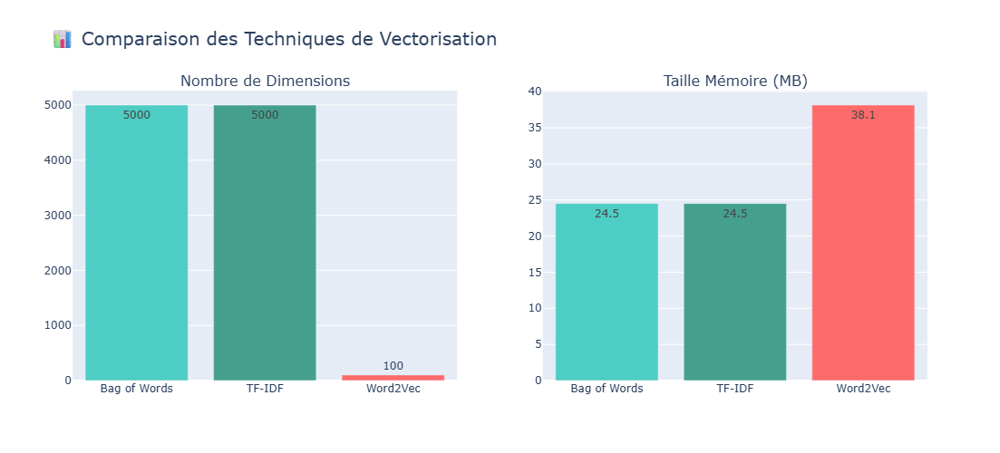

In [164]:
# Visualisation
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Nombre de Dimensions', 'Taille Mémoire (MB)')
)

fig.add_trace(
    go.Bar(
        x=df_comparison['Méthode'],
        y=df_comparison['Dimensions'],
        marker_color=['#4ECDC4', '#44A08D', '#FF6B6B'],
        text=df_comparison['Dimensions'],
        textposition='auto'
    ),
    row=1, col=1
)

fig.add_trace(
    go.Bar(
        x=df_comparison['Méthode'],
        y=df_comparison['Taille mémoire (MB)'],
        marker_color=['#4ECDC4', '#44A08D', '#FF6B6B'],
        text=[f"{v:.1f}" for v in df_comparison['Taille mémoire (MB)']],
        textposition='auto'
    ),
    row=1, col=2
)

fig.update_layout(
    title_text="📊 Comparaison des Techniques de Vectorisation",
    title_font_size=20,
    height=500,
    showlegend=False
)

fig.show()

In [166]:
# %% [markdown]
# ## 🎯 Choix de la méthode principale : TF-IDF

# %% [markdown]
# ### Pourquoi choisir TF-IDF ?
# 
# Nous allons utiliser **TF-IDF** comme méthode principale car :
# 
# ✅ **Meilleure performance**
# ✅ **Bon équilibre** : Entre simplicité et performance
# ✅ **Interprétable** : On peut voir quels mots sont importants
# ✅ **Standard de l'industrie** : Très utilisé en classification de texte
# 
# Nous garderons aussi les **features additionnelles** pour enrichir le modèle.

print("=" * 80)
print("🎯 CRÉATION DU DATASET FINAL AVEC TF-IDF + FEATURES")
print("=" * 80)

# Combiner TF-IDF avec les features additionnelles
from scipy.sparse import hstack, csr_matrix

# Sélectionner les features additionnelles
additional_feature_cols = ['char_count', 'word_count', 'avg_word_length', 
                          'exclamation_count', 'question_count', 'polarity', 'subjectivity']

# Normaliser les features additionnelles (importante pour combiner avec TF-IDF)
scaler = StandardScaler()
additional_features = scaler.fit_transform(df[additional_feature_cols])

print(f"\n📊 Features additionnelles :")
print(f"   • Nombre de features : {additional_features.shape[1]}")
print(f"   • Features : {additional_feature_cols}")

# Convertir en sparse matrix pour combiner
additional_features_sparse = csr_matrix(additional_features)

# Combiner TF-IDF + features additionnelles
X_combined = hstack([X_tfidf, additional_features_sparse])

print(f"\n✅ Dataset combiné créé !")
print(f"   • Forme finale           : {X_combined.shape}")
print(f"   • Features TF-IDF        : {X_tfidf.shape[1]:,}")
print(f"   • Features additionnelles: {additional_features.shape[1]}")
print(f"   • Total features         : {X_combined.shape[1]:,}")

🎯 CRÉATION DU DATASET FINAL AVEC TF-IDF + FEATURES

📊 Features additionnelles :
   • Nombre de features : 7
   • Features : ['char_count', 'word_count', 'avg_word_length', 'exclamation_count', 'question_count', 'polarity', 'subjectivity']

✅ Dataset combiné créé !
   • Forme finale           : (99971, 5007)
   • Features TF-IDF        : 5,000
   • Features additionnelles: 7
   • Total features         : 5,007


In [168]:
# Préparer y
y = df['label_encoded'].values

print(f"\n🏷️ Variable cible :")
print(f"   • Forme : {y.shape}")
print(f"   • Classes : {np.unique(y)}")
print(f"   • Distribution : {dict(zip(*np.unique(y, return_counts=True)))}")


🏷️ Variable cible :
   • Forme : (99971,)
   • Classes : [0 1]
   • Distribution : {0: 48716, 1: 51255}


In [170]:
# ## 📊 Split Train / Validation / Test

print("=" * 80)
print("📊 SPLIT DES DONNÉES")
print("=" * 80)

# D'abord split train+val / test (80% / 20%)
X_temp, X_test, y_temp, y_test = train_test_split(
    X_combined, y, 
    test_size=0.2, 
    random_state=42, 
    stratify=y
)

# Puis split train / val (75% / 25% du temp = 60% / 20% du total)
X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, 
    test_size=0.25, 
    random_state=42, 
    stratify=y_temp
)

print("\n📈 Répartition des données :")
print(f"   • Train      : {X_train.shape[0]:6,} samples ({X_train.shape[0]/len(df)*100:.1f}%)")
print(f"   • Validation : {X_val.shape[0]:6,} samples ({X_val.shape[0]/len(df)*100:.1f}%)")
print(f"   • Test       : {X_test.shape[0]:6,} samples ({X_test.shape[0]/len(df)*100:.1f}%)")
print(f"   • Total      : {len(df):6,} samples")

# Vérifier la distribution des classes dans chaque set
print("\n🏷️ Distribution des classes :")

for name, y_set in [('Train', y_train), ('Validation', y_val), ('Test', y_test)]:
    unique, counts = np.unique(y_set, return_counts=True)
    print(f"\n   {name} :")
    for label, count in zip(unique, counts):
        sentiment = label_encoder.inverse_transform([label])[0]
        print(f"      {sentiment:10s} : {count:5,} ({count/len(y_set)*100:.2f}%)")

📊 SPLIT DES DONNÉES

📈 Répartition des données :
   • Train      : 59,982 samples (60.0%)
   • Validation : 19,994 samples (20.0%)
   • Test       : 19,995 samples (20.0%)
   • Total      : 99,971 samples

🏷️ Distribution des classes :

   Train :
      Négatif    : 29,229 (48.73%)
      Positif    : 30,753 (51.27%)

   Validation :
      Négatif    : 9,743 (48.73%)
      Positif    : 10,251 (51.27%)

   Test :
      Négatif    : 9,744 (48.73%)
      Positif    : 10,251 (51.27%)


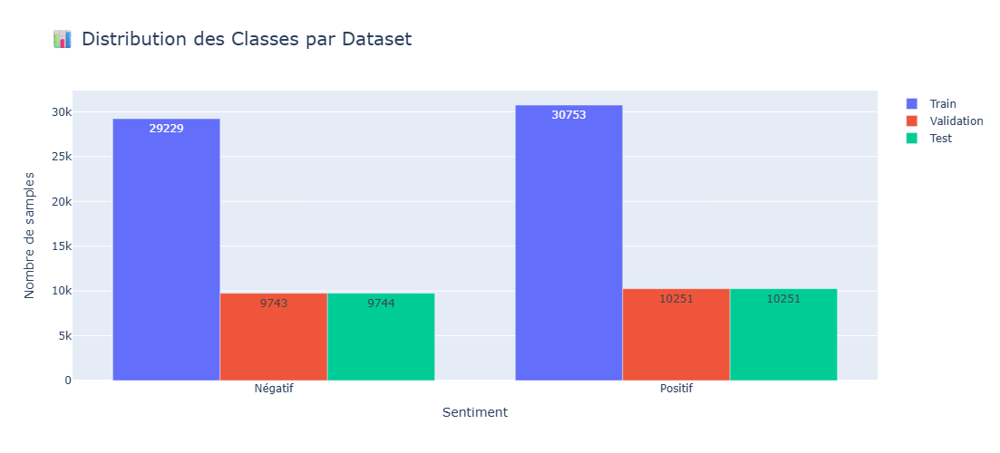

In [172]:
# Visualisation de la distribution
fig = go.Figure()

datasets = ['Train', 'Validation', 'Test']
y_sets = [y_train, y_val, y_test]

for i, (name, y_set) in enumerate(zip(datasets, y_sets)):
    unique, counts = np.unique(y_set, return_counts=True)
    sentiments = label_encoder.inverse_transform(unique)
    
    fig.add_trace(go.Bar(
        name=name,
        x=sentiments,
        y=counts,
        text=counts,
        textposition='auto'
    ))

fig.update_layout(
    title='📊 Distribution des Classes par Dataset',
    title_font_size=20,
    xaxis_title='Sentiment',
    yaxis_title='Nombre de samples',
    barmode='group',
    height=500
)

fig.show()

In [174]:
# ## 🔍 Analyse de l'Importance des Features TF-IDF

print("=" * 80)
print("🔍 ANALYSE DE L'IMPORTANCE DES FEATURES")
print("=" * 80)

# Calculer les scores moyens TF-IDF par classe
print("\n⏳ Calcul des features les plus discriminantes...\n")

# Séparer les données par classe
X_train_pos = X_tfidf[df.index.isin(df[df['label_encoded'] == 1].index)]
X_train_neg = X_tfidf[df.index.isin(df[df['label_encoded'] == 0].index)]

# Calculer les moyennes
mean_tfidf_pos = np.array(X_train_pos.mean(axis=0)).flatten()
mean_tfidf_neg = np.array(X_train_neg.mean(axis=0)).flatten()

# Calculer la différence (features discriminantes)
diff_tfidf = mean_tfidf_pos - mean_tfidf_neg

# Top features pour chaque classe
feature_names = tfidf_vectorizer.get_feature_names_out()

# Features positives (score élevé pour classe positive)
top_pos_indices = np.argsort(diff_tfidf)[-20:][::-1]
top_pos_features = [(feature_names[i], diff_tfidf[i], mean_tfidf_pos[i]) 
                    for i in top_pos_indices]

# Features négatives (score élevé pour classe négative)
top_neg_indices = np.argsort(diff_tfidf)[:20]
top_neg_features = [(feature_names[i], diff_tfidf[i], mean_tfidf_neg[i]) 
                    for i in top_neg_indices]

print("🟢 Top 20 Features pour AVIS POSITIFS :")
print(f"{'Feature':<25} {'Diff Score':>12} {'TF-IDF Moyen':>15}")
print("-" * 55)
for feature, diff, mean in top_pos_features:
    print(f"{feature:<25} {diff:>12.6f} {mean:>15.6f}")

print("\n🔴 Top 20 Features pour AVIS NÉGATIFS :")
print(f"{'Feature':<25} {'Diff Score':>12} {'TF-IDF Moyen':>15}")
print("-" * 55)
for feature, diff, mean in top_neg_features:
    print(f"{feature:<25} {diff:>12.6f} {mean:>15.6f}")

🔍 ANALYSE DE L'IMPORTANCE DES FEATURES

⏳ Calcul des features les plus discriminantes...

🟢 Top 20 Features pour AVIS POSITIFS :
Feature                     Diff Score    TF-IDF Moyen
-------------------------------------------------------
great                         0.024667        0.035245
love                          0.018194        0.026248
best                          0.012694        0.018655
excellent                     0.009542        0.011373
favorite                      0.007362        0.009245
easy                          0.007160        0.010179
wonderful                     0.006928        0.008768
good                          0.006807        0.024954
album                         0.006389        0.013952
enjoy                         0.006370        0.011240
perfect                       0.006225        0.007697
classic                       0.006141        0.009525
awesome                       0.005920        0.006733
amaze                         0.005915       

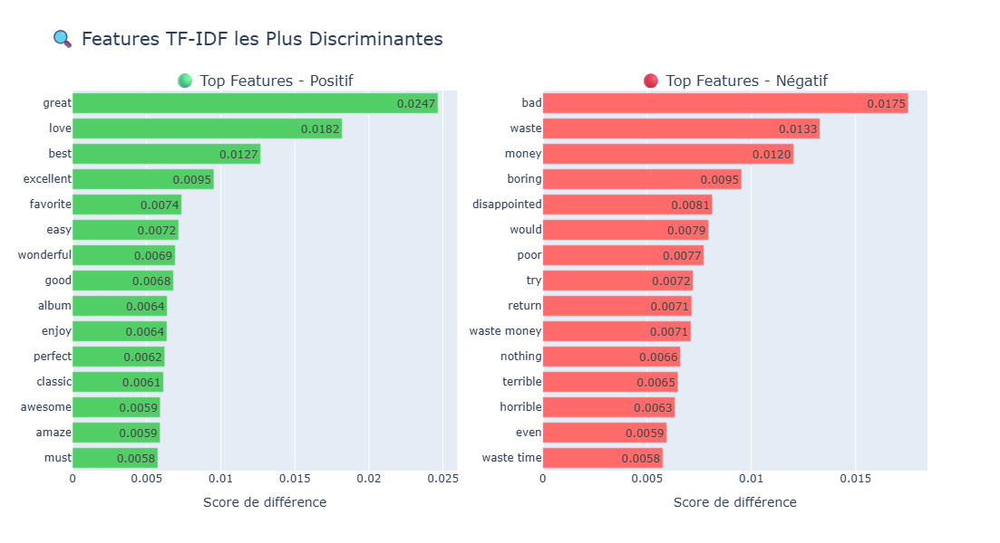

In [176]:
# Visualisation des top features
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('🟢 Top Features - Positif', '🔴 Top Features - Négatif')
)

# Positif
pos_features = [f[0] for f in top_pos_features][:15][::-1]
pos_scores = [f[1] for f in top_pos_features][:15][::-1]

fig.add_trace(
    go.Bar(
        y=pos_features,
        x=pos_scores,
        orientation='h',
        marker_color='#51cf66',
        text=[f"{s:.4f}" for s in pos_scores],
        textposition='auto'
    ),
    row=1, col=1
)

# Négatif
neg_features = [f[0] for f in top_neg_features][:15][::-1]
neg_scores = [abs(f[1]) for f in top_neg_features][:15][::-1]

fig.add_trace(
    go.Bar(
        y=neg_features,
        x=neg_scores,
        orientation='h',
        marker_color='#ff6b6b',
        text=[f"{s:.4f}" for s in neg_scores],
        textposition='auto'
    ),
    row=1, col=2
)

fig.update_xaxes(title_text="Score de différence", row=1, col=1)
fig.update_xaxes(title_text="Score de différence", row=1, col=2)

fig.update_layout(
    title_text="🔍 Features TF-IDF les Plus Discriminantes",
    title_font_size=20,
    height=600,
    showlegend=False
)

fig.show()

In [178]:
# ## 💾 Sauvegarde des Objets pour la Modélisation

print("=" * 80)
print("💾 SAUVEGARDE DES OBJETS")
print("=" * 80)

# Créer un dictionnaire avec tous les objets nécessaires
vectorization_objects = {
    'tfidf_vectorizer': tfidf_vectorizer,
    'label_encoder': label_encoder,
    'scaler': scaler,
    'additional_feature_cols': additional_feature_cols,
    'feature_names_tfidf': feature_names,
    'w2v_model': w2v_model,  # Au cas où on voudrait l'utiliser plus tard
    'count_vectorizer': count_vectorizer  # Pour comparaison
}

# Sauvegarder
with open('vectorization_objects.pkl', 'wb') as f:
    pickle.dump(vectorization_objects, f)

print("\n✅ Objets de vectorisation sauvegardés dans 'vectorization_objects.pkl'")

# Sauvegarder les datasets
datasets = {
    'X_train': X_train,
    'X_val': X_val,
    'X_test': X_test,
    'y_train': y_train,
    'y_val': y_val,
    'y_test': y_test
}

with open('train_val_test_splits.pkl', 'wb') as f:
    pickle.dump(datasets, f)

print("✅ Datasets (train/val/test) sauvegardés dans 'train_val_test_splits.pkl'")

# Sauvegarder aussi en format numpy pour compatibilité
np.savez_compressed(
    'train_val_test_arrays.npz',
    X_train=X_train.toarray(),  # Convertir sparse en dense
    X_val=X_val.toarray(),
    X_test=X_test.toarray(),
    y_train=y_train,
    y_val=y_val,
    y_test=y_test
)

print("✅ Arrays sauvegardés en format compressé dans 'train_val_test_arrays.npz'")

💾 SAUVEGARDE DES OBJETS

✅ Objets de vectorisation sauvegardés dans 'vectorization_objects.pkl'
✅ Datasets (train/val/test) sauvegardés dans 'train_val_test_splits.pkl'
✅ Arrays sauvegardés en format compressé dans 'train_val_test_arrays.npz'


In [180]:
# ## 📊 Résumé de l'Étape 5

print("\n" + "=" * 80)
print("📊 RÉSUMÉ DE LA VECTORISATION ET FEATURE ENGINEERING")
print("=" * 80)

summary = f"""
✨ MÉTHODES DE VECTORISATION TESTÉES :

1. 🔤 BAG OF WORDS (CountVectorizer)
   • Dimensions          : {X_bow.shape[1]:,}
   • Sparsité            : {(1 - X_bow.nnz / (X_bow.shape[0] * X_bow.shape[1])) * 100:.2f}%
   • Mémoire             : {X_bow.data.nbytes / 1024**2:.2f} MB

2. 📈 TF-IDF (TfidfVectorizer) ⭐ CHOISI
   • Dimensions          : {X_tfidf.shape[1]:,}
   • Sparsité            : {(1 - X_tfidf.nnz / (X_tfidf.shape[0] * X_tfidf.shape[1])) * 100:.2f}%
   • Mémoire             : {X_tfidf.data.nbytes / 1024**2:.2f} MB
   • N-grams             : Unigrams + Bigrams

3. 🧠 WORD2VEC
   • Dimensions          : {X_w2v.shape[1]}
   • Type                : Dense embeddings
   • Vocabulaire         : {len(w2v_model.wv):,} mots

🔧 FEATURES ADDITIONNELLES CRÉÉES :
   • Nombre de caractères
   • Nombre de mots
   • Longueur moyenne des mots
   • Nombre de points d'exclamation
   • Nombre de points d'interrogation
   • Polarité (TextBlob)
   • Subjectivité (TextBlob)

📊 DATASET FINAL :
   • Total features       : {X_combined.shape[1]:,}
   • Features TF-IDF      : {X_tfidf.shape[1]:,}
   • Features méta        : {len(additional_feature_cols)}
   
   • Train samples        : {X_train.shape[0]:,} (60%)
   • Validation samples   : {X_val.shape[0]:,} (20%)
   • Test samples         : {X_test.shape[0]:,} (20%)

💾 FICHIERS SAUVEGARDÉS :
   ✓ vectorization_objects.pkl (vectorizers, encoders, scaler)
   ✓ train_val_test_splits.pkl (datasets en sparse format)
   ✓ train_val_test_arrays.npz (datasets en numpy arrays)

🎯 PROCHAINE ÉTAPE :
   Nous sommes prêts pour la MODÉLISATION !
   Nous testerons plusieurs algorithmes et comparerons leurs performances.
"""

print(summary)

print("\n" + "=" * 80)
print("✨ ÉTAPE 5 TERMINÉE AVEC SUCCÈS ! ✨")
print("=" * 80)
print("\n👉 Prochaine étape : Modélisation et Comparaison d'Algorithmes")


📊 RÉSUMÉ DE LA VECTORISATION ET FEATURE ENGINEERING

✨ MÉTHODES DE VECTORISATION TESTÉES :

1. 🔤 BAG OF WORDS (CountVectorizer)
   • Dimensions          : 5,000
   • Sparsité            : 99.36%
   • Mémoire             : 24.51 MB

2. 📈 TF-IDF (TfidfVectorizer) ⭐ CHOISI
   • Dimensions          : 5,000
   • Sparsité            : 99.36%
   • Mémoire             : 24.51 MB
   • N-grams             : Unigrams + Bigrams

3. 🧠 WORD2VEC
   • Dimensions          : 100
   • Type                : Dense embeddings
   • Vocabulaire         : 44,199 mots

🔧 FEATURES ADDITIONNELLES CRÉÉES :
   • Nombre de caractères
   • Nombre de mots
   • Longueur moyenne des mots
   • Nombre de points d'exclamation
   • Nombre de points d'interrogation
   • Polarité (TextBlob)
   • Subjectivité (TextBlob)

📊 DATASET FINAL :
   • Total features       : 5,007
   • Features TF-IDF      : 5,000
   • Features méta        : 7
   
   • Train samples        : 59,982 (60%)
   • Validation samples   : 19,994 (20%)
   • T

# ÉTAPE 6 : MODÉLISATION ET COMPARAISON D'ALGORITHMES

Dans cette section, nous allons :
- Tester plusieurs algorithmes de Machine Learning
- Comparer leurs performances (accuracy, F1-score, temps d'entraînement)
- Analyser les matrices de confusion
- Identifier le meilleur modèle
- Préparer pour l'optimisation finale

In [185]:
# ## 📦 Import des bibliothèques

# Bibliothèques de base
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

# Scikit-learn - Modèles
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

# Scikit-learn - Métriques et évaluation
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    classification_report, confusion_matrix, roc_auc_score, roc_curve
)

# Utilitaires
import pickle
import time
from tqdm.auto import tqdm

# Configuration
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("Set2")
pd.set_option('display.max_columns', None)

print("✅ Bibliothèques importées avec succès !")

✅ Bibliothèques importées avec succès !


In [187]:
# ## 📂 Chargement des données préparées

print("=" * 80)
print("📂 CHARGEMENT DES DONNÉES")
print("=" * 80)

# Charger les datasets
with open('train_val_test_splits.pkl', 'rb') as f:
    datasets = pickle.load(f)

X_train = datasets['X_train']
X_val = datasets['X_val']
X_test = datasets['X_test']
y_train = datasets['y_train']
y_val = datasets['y_val']
y_test = datasets['y_test']

# Charger les objets de vectorisation
with open('vectorization_objects.pkl', 'rb') as f:
    vect_objects = pickle.load(f)

label_encoder = vect_objects['label_encoder']

print("\n✅ Données chargées avec succès !")
print(f"\n📊 Dimensions des datasets :")
print(f"   • X_train : {X_train.shape}")
print(f"   • X_val   : {X_val.shape}")
print(f"   • X_test  : {X_test.shape}")

print(f"\n🏷️ Distribution des classes :")
for name, y_set in [('Train', y_train), ('Val', y_val), ('Test', y_test)]:
    unique, counts = np.unique(y_set, return_counts=True)
    print(f"   {name:5s} : {dict(zip(unique, counts))}")

📂 CHARGEMENT DES DONNÉES

✅ Données chargées avec succès !

📊 Dimensions des datasets :
   • X_train : (59982, 5007)
   • X_val   : (19994, 5007)
   • X_test  : (19995, 5007)

🏷️ Distribution des classes :
   Train : {0: 29229, 1: 30753}
   Val   : {0: 9743, 1: 10251}
   Test  : {0: 9744, 1: 10251}


# ## 🎯 Définition des Modèles à Tester

**Algorithmes sélectionnés**

Nous allons tester **6 algorithmes classiques** de Machine Learning :

1. **Logistic Regression** : Simple, rapide, très efficace pour le texte
2. **Naive Bayes** : Classique pour la classification de texte
3. **Support Vector Machine (SVM)** : Puissant pour les données haute dimension
4. **Random Forest** : Ensemble de decision trees
5. **Gradient Boosting** : Boosting performant
6. **K-Nearest Neighbors** : Basé sur la similarité<br>
**Chaque algorithme a ses forces et faiblesses. Nous les comparerons !**

In [191]:
print("=" * 80)
print("🎯 DÉFINITION DES MODÈLES")
print("=" * 80)

# Dictionnaire de modèles avec leurs hyperparamètres de base
models = {
    'Logistic Regression': LogisticRegression(
        max_iter=1000,
        random_state=42,
        solver='lbfgs',
        C=1.0
    ),
    
    'Naive Bayes': MultinomialNB(
        alpha=1.0
    ),
    
    'Linear SVM': LinearSVC(
        max_iter=2000,
        random_state=42,
        C=1.0,
        dual=False  # Pour éviter les warnings avec beaucoup de features
    ),
    
    'Random Forest': RandomForestClassifier(
        n_estimators=100,
        max_depth=20,
        random_state=42,
        n_jobs=-1,
        min_samples_split=10
    ),
    
    'Gradient Boosting': GradientBoostingClassifier(
        n_estimators=100,
        max_depth=5,
        random_state=42,
        learning_rate=0.1
    ),
    
    'K-Nearest Neighbors': KNeighborsClassifier(
        n_neighbors=5,
        n_jobs=-1,
        metric='cosine'  # Mieux pour le texte que euclidean
    )
}

print(f"\n📋 {len(models)} modèles définis :")
for i, (name, model) in enumerate(models.items(), 1):
    print(f"   {i}. {name}")

🎯 DÉFINITION DES MODÈLES

📋 6 modèles définis :
   1. Logistic Regression
   2. Naive Bayes
   3. Linear SVM
   4. Random Forest
   5. Gradient Boosting
   6. K-Nearest Neighbors


In [193]:
# ## 🚀 Entraînement et Évaluation des Modèles

print("\n" + "=" * 80)
print("🚀 ENTRAÎNEMENT ET ÉVALUATION DES MODÈLES")
print("=" * 80)

# Dictionnaire pour stocker les résultats
results = {
    'model_name': [],
    'train_time': [],
    'predict_time': [],
    'train_accuracy': [],
    'val_accuracy': [],
    'val_precision': [],
    'val_recall': [],
    'val_f1': [],
    'trained_model': []
}

print("\n⏳ Entraînement en cours...\n")

# Boucle d'entraînement
for model_name, model in models.items():
    print(f"{'='*80}")
    print(f"🔄 {model_name}")
    print(f"{'='*80}")
    
    # Entraînement
    print("   ⏳ Entraînement...")
    start_time = time.time()
    
    try:
        model.fit(X_train, y_train)
        train_time = time.time() - start_time
        
        # Prédictions
        print("   ⏳ Prédictions...")
        start_pred = time.time()
        y_train_pred = model.predict(X_train)
        y_val_pred = model.predict(X_val)
        predict_time = time.time() - start_pred
        
        # Métriques
        train_acc = accuracy_score(y_train, y_train_pred)
        val_acc = accuracy_score(y_val, y_val_pred)
        val_prec = precision_score(y_val, y_val_pred, average='weighted')
        val_rec = recall_score(y_val, y_val_pred, average='weighted')
        val_f1 = f1_score(y_val, y_val_pred, average='weighted')
        
        # Stocker les résultats
        results['model_name'].append(model_name)
        results['train_time'].append(train_time)
        results['predict_time'].append(predict_time)
        results['train_accuracy'].append(train_acc)
        results['val_accuracy'].append(val_acc)
        results['val_precision'].append(val_prec)
        results['val_recall'].append(val_rec)
        results['val_f1'].append(val_f1)
        results['trained_model'].append(model)
        
        # Afficher les résultats
        print(f"   ✅ Terminé !")
        print(f"   ⏱️  Temps d'entraînement  : {train_time:.2f}s")
        print(f"   ⏱️  Temps de prédiction   : {predict_time:.2f}s")
        print(f"   📊 Accuracy (train)      : {train_acc:.4f}")
        print(f"   📊 Accuracy (validation) : {val_acc:.4f}")
        print(f"   📊 F1-Score (validation) : {val_f1:.4f}")
        print(f"   📊 Precision             : {val_prec:.4f}")
        print(f"   📊 Recall                : {val_rec:.4f}")
        
    except Exception as e:
        print(f"   ❌ Erreur : {e}")
        # Ajouter des NaN en cas d'erreur
        results['model_name'].append(model_name)
        results['train_time'].append(np.nan)
        results['predict_time'].append(np.nan)
        results['train_accuracy'].append(np.nan)
        results['val_accuracy'].append(np.nan)
        results['val_precision'].append(np.nan)
        results['val_recall'].append(np.nan)
        results['val_f1'].append(np.nan)
        results['trained_model'].append(None)
    
    print()

print("=" * 80)
print("✅ TOUS LES MODÈLES ONT ÉTÉ ENTRAÎNÉS !")
print("=" * 80)


🚀 ENTRAÎNEMENT ET ÉVALUATION DES MODÈLES

⏳ Entraînement en cours...

🔄 Logistic Regression
   ⏳ Entraînement...
   ⏳ Prédictions...
   ✅ Terminé !
   ⏱️  Temps d'entraînement  : 0.42s
   ⏱️  Temps de prédiction   : 0.01s
   📊 Accuracy (train)      : 0.9807
   📊 Accuracy (validation) : 0.9788
   📊 F1-Score (validation) : 0.9788
   📊 Precision             : 0.9788
   📊 Recall                : 0.9788

🔄 Naive Bayes
   ⏳ Entraînement...
   ❌ Erreur : Negative values in data passed to MultinomialNB (input X)

🔄 Linear SVM
   ⏳ Entraînement...
   ⏳ Prédictions...
   ✅ Terminé !
   ⏱️  Temps d'entraînement  : 0.77s
   ⏱️  Temps de prédiction   : 0.02s
   📊 Accuracy (train)      : 0.9865
   📊 Accuracy (validation) : 0.9797
   📊 F1-Score (validation) : 0.9797
   📊 Precision             : 0.9797
   📊 Recall                : 0.9797

🔄 Random Forest
   ⏳ Entraînement...
   ⏳ Prédictions...
   ✅ Terminé !
   ⏱️  Temps d'entraînement  : 1.64s
   ⏱️  Temps de prédiction   : 0.27s
   📊 Accuracy (tra

In [195]:
# ## 📊 Tableau Comparatif des Performances

print("\n" + "=" * 80)
print("📊 TABLEAU COMPARATIF DES PERFORMANCES")
print("=" * 80)

# Créer un DataFrame des résultats
df_results = pd.DataFrame({
    'Modèle': results['model_name'],
    'Train Time (s)': results['train_time'],
    'Predict Time (s)': results['predict_time'],
    'Train Accuracy': results['train_accuracy'],
    'Val Accuracy': results['val_accuracy'],
    'Val Precision': results['val_precision'],
    'Val Recall': results['val_recall'],
    'Val F1-Score': results['val_f1']
})

# Trier par F1-Score
df_results = df_results.sort_values('Val F1-Score', ascending=False)

print("\n🏆 Classement par F1-Score :\n")
display(df_results.style.background_gradient(subset=['Val F1-Score'], cmap='Greens'))

# Identifier le meilleur modèle
best_model_name = df_results.iloc[0]['Modèle']
best_f1 = df_results.iloc[0]['Val F1-Score']

print(f"\n🥇 MEILLEUR MODÈLE : {best_model_name}")
print(f"   F1-Score : {best_f1:.4f}")


📊 TABLEAU COMPARATIF DES PERFORMANCES

🏆 Classement par F1-Score :



,Modèle,Train Time (s),Predict Time (s),Train Accuracy,Val Accuracy,Val Precision,Val Recall,Val F1-Score
2,Linear SVM,0.767038,0.015351,0.986546,0.979744,0.979744,0.979744,0.979744
0,Logistic Regression,0.419528,0.008617,0.980678,0.978844,0.978844,0.978844,0.978843
3,Random Forest,1.642565,0.269279,0.982178,0.978594,0.978617,0.978594,0.978591
4,Gradient Boosting,115.915632,0.195764,0.984979,0.978243,0.978257,0.978243,0.978242
5,K-Nearest Neighbors,0.011000,164.531527,0.978344,0.971291,0.971293,0.971291,0.971292
1,Naive Bayes,nan,nan,nan,nan,nan,nan,nan



🥇 MEILLEUR MODÈLE : Linear SVM
   F1-Score : 0.9797


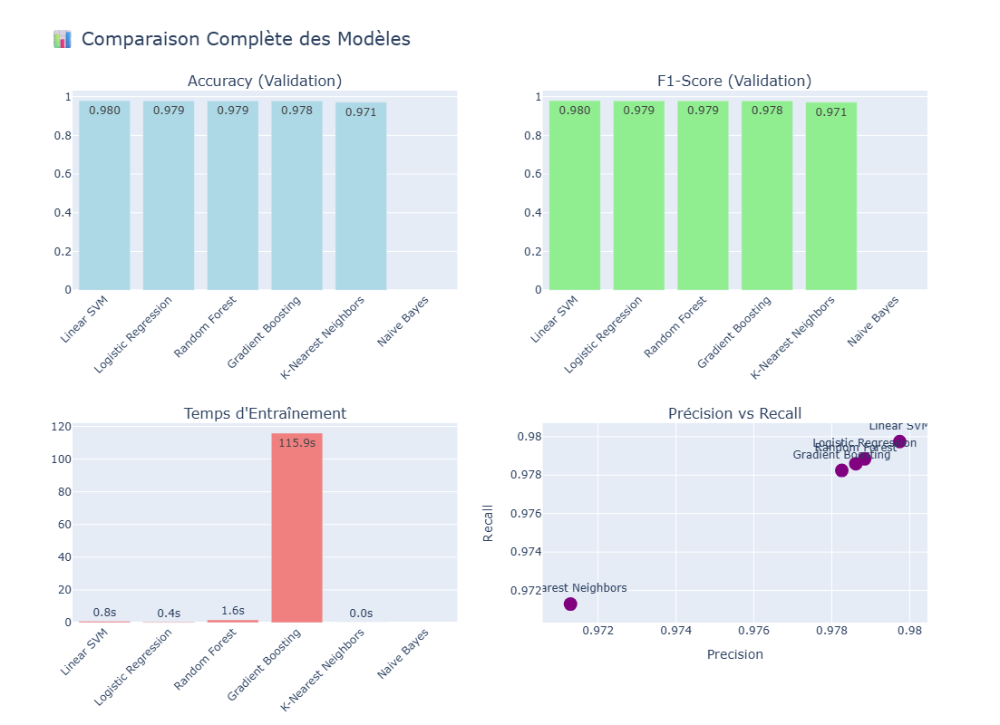

In [197]:
# ## 📈 Visualisations Comparatives

# Graphique comparatif des métriques
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=(
        'Accuracy (Validation)',
        'F1-Score (Validation)',
        'Temps d\'Entraînement',
        'Précision vs Recall'
    )
)

# 1. Accuracy
fig.add_trace(
    go.Bar(
        x=df_results['Modèle'],
        y=df_results['Val Accuracy'],
        marker_color='lightblue',
        text=[f"{v:.3f}" for v in df_results['Val Accuracy']],
        textposition='auto',
        name='Accuracy'
    ),
    row=1, col=1
)

# 2. F1-Score
fig.add_trace(
    go.Bar(
        x=df_results['Modèle'],
        y=df_results['Val F1-Score'],
        marker_color='lightgreen',
        text=[f"{v:.3f}" for v in df_results['Val F1-Score']],
        textposition='auto',
        name='F1-Score'
    ),
    row=1, col=2
)

# 3. Temps d'entraînement
fig.add_trace(
    go.Bar(
        x=df_results['Modèle'],
        y=df_results['Train Time (s)'],
        marker_color='lightcoral',
        text=[f"{v:.1f}s" for v in df_results['Train Time (s)']],
        textposition='auto',
        name='Train Time'
    ),
    row=2, col=1
)

# 4. Precision vs Recall (scatter)
fig.add_trace(
    go.Scatter(
        x=df_results['Val Precision'],
        y=df_results['Val Recall'],
        mode='markers+text',
        marker=dict(size=15, color='purple'),
        text=df_results['Modèle'],
        textposition='top center',
        name='Models'
    ),
    row=2, col=2
)

# Mise en forme
fig.update_xaxes(tickangle=-45, row=1, col=1)
fig.update_xaxes(tickangle=-45, row=1, col=2)
fig.update_xaxes(tickangle=-45, row=2, col=1)
fig.update_xaxes(title_text="Precision", row=2, col=2)
fig.update_yaxes(title_text="Recall", row=2, col=2)

fig.update_layout(
    title_text="📊 Comparaison Complète des Modèles",
    title_font_size=20,
    height=800,
    showlegend=False
)

fig.show()

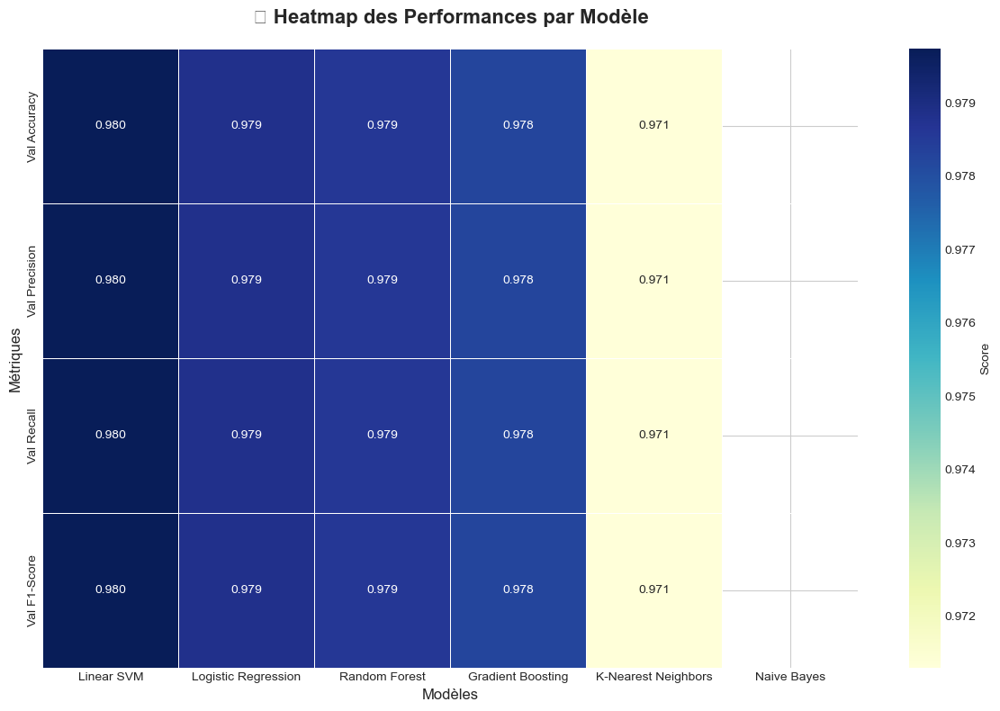

In [199]:
# Heatmap des performances
metrics_for_heatmap = df_results[['Modèle', 'Val Accuracy', 'Val Precision', 'Val Recall', 'Val F1-Score']].set_index('Modèle')

plt.figure(figsize=(12, 8))
sns.heatmap(
    metrics_for_heatmap.T,
    annot=True,
    fmt='.3f',
    cmap='YlGnBu',
    cbar_kws={'label': 'Score'},
    linewidths=0.5
)
plt.title('🔥 Heatmap des Performances par Modèle', fontsize=16, fontweight='bold', pad=20)
plt.xlabel('Modèles', fontsize=12)
plt.ylabel('Métriques', fontsize=12)
plt.tight_layout()
plt.show()

In [201]:
# ## 🎯 Analyse Détaillée du Meilleur Modèle

print("=" * 80)
print(f"🎯 ANALYSE DÉTAILLÉE : {best_model_name}")
print("=" * 80)

# Récupérer le meilleur modèle
best_model_idx = df_results.index[0]
best_model = results['trained_model'][best_model_idx]

# Prédictions sur validation
y_val_pred = best_model.predict(X_val)

# Rapport de classification complet
print("\n📋 RAPPORT DE CLASSIFICATION (Validation Set) :\n")
class_names = label_encoder.classes_
print(classification_report(y_val, y_val_pred, target_names=class_names))

🎯 ANALYSE DÉTAILLÉE : Linear SVM

📋 RAPPORT DE CLASSIFICATION (Validation Set) :

              precision    recall  f1-score   support

     Négatif       0.98      0.98      0.98      9743
     Positif       0.98      0.98      0.98     10251

    accuracy                           0.98     19994
   macro avg       0.98      0.98      0.98     19994
weighted avg       0.98      0.98      0.98     19994



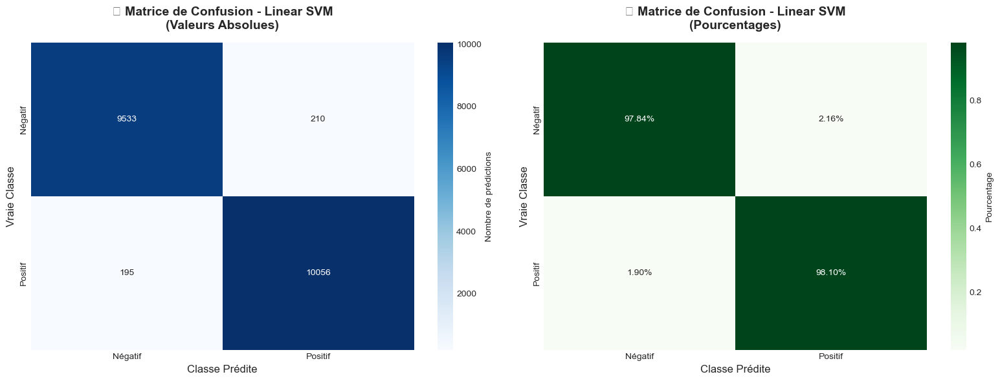

In [203]:
# ## 📊 Matrice de Confusion

# Calculer la matrice de confusion
cm = confusion_matrix(y_val, y_val_pred)

# Normaliser pour avoir les pourcentages
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Visualisation
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Matrice brute
sns.heatmap(
    cm,
    annot=True,
    fmt='d',
    cmap='Blues',
    xticklabels=class_names,
    yticklabels=class_names,
    ax=axes[0],
    cbar_kws={'label': 'Nombre de prédictions'}
)
axes[0].set_title(f'📊 Matrice de Confusion - {best_model_name}\n(Valeurs Absolues)', 
                  fontsize=14, fontweight='bold', pad=15)
axes[0].set_ylabel('Vraie Classe', fontsize=12)
axes[0].set_xlabel('Classe Prédite', fontsize=12)

# Matrice normalisée
sns.heatmap(
    cm_normalized,
    annot=True,
    fmt='.2%',
    cmap='Greens',
    xticklabels=class_names,
    yticklabels=class_names,
    ax=axes[1],
    cbar_kws={'label': 'Pourcentage'}
)
axes[1].set_title(f'📊 Matrice de Confusion - {best_model_name}\n(Pourcentages)', 
                  fontsize=14, fontweight='bold', pad=15)
axes[1].set_ylabel('Vraie Classe', fontsize=12)
axes[1].set_xlabel('Classe Prédite', fontsize=12)

plt.tight_layout()
plt.show()

In [205]:
# Analyse de la matrice
print("\n" + "=" * 80)
print("🔍 ANALYSE DE LA MATRICE DE CONFUSION")
print("=" * 80)

for i, true_class in enumerate(class_names):
    print(f"\n🏷️ {true_class.upper()} :")
    
    # Vrais positifs
    tp = cm[i, i]
    total = cm[i, :].sum()
    
    print(f"   • Total d'exemples        : {total}")
    print(f"   • Bien classés            : {tp} ({cm_normalized[i, i]:.1%})")
    
    # Erreurs
    for j, pred_class in enumerate(class_names):
        if i != j:
            errors = cm[i, j]
            if errors > 0:
                print(f"   • Classés comme {pred_class:8s} : {errors} ({cm[i,j]/total:.1%})")


🔍 ANALYSE DE LA MATRICE DE CONFUSION

🏷️ NÉGATIF :
   • Total d'exemples        : 9743
   • Bien classés            : 9533 (97.8%)
   • Classés comme Positif  : 210 (2.2%)

🏷️ POSITIF :
   • Total d'exemples        : 10251
   • Bien classés            : 10056 (98.1%)
   • Classés comme Négatif  : 195 (1.9%)



📈 COURBES ROC
   ✅ Logistic Regression       - AUC: 0.9886
   ⚠️ Naive Bayes               - Pas de proba disponible
   ✅ Random Forest             - AUC: 0.9958
   ✅ Gradient Boosting         - AUC: 0.9985


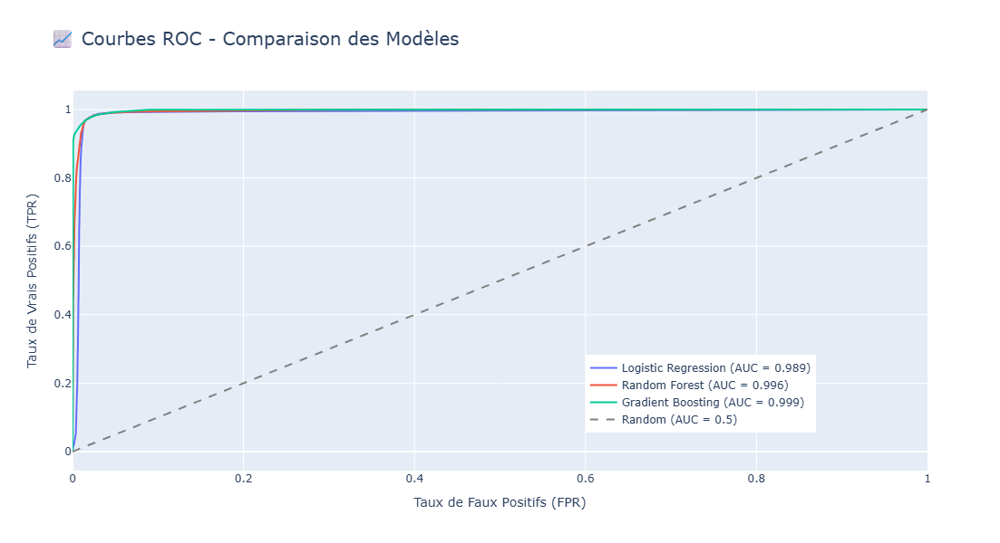

In [207]:
# ## 📈 Courbes ROC (Receiver Operating Characteristic)

print("\n" + "=" * 80)
print("📈 COURBES ROC")
print("=" * 80)

# Pour les modèles qui supportent predict_proba
models_with_proba = ['Logistic Regression', 'Naive Bayes', 'Random Forest', 'Gradient Boosting']

fig = go.Figure()

for model_name in models_with_proba:
    if model_name in results['model_name']:
        idx = results['model_name'].index(model_name)
        model = results['trained_model'][idx]
        
        try:
            # Obtenir les probabilités
            y_val_proba = model.predict_proba(X_val)[:, 1]
            
            # Calculer ROC
            fpr, tpr, _ = roc_curve(y_val, y_val_proba)
            auc_score = roc_auc_score(y_val, y_val_proba)
            
            # Ajouter à la figure
            fig.add_trace(go.Scatter(
                x=fpr,
                y=tpr,
                mode='lines',
                name=f'{model_name} (AUC = {auc_score:.3f})',
                line=dict(width=2)
            ))
            
            print(f"   ✅ {model_name:25s} - AUC: {auc_score:.4f}")
            
        except:
            print(f"   ⚠️ {model_name:25s} - Pas de proba disponible")

# Ligne de référence (aléatoire)
fig.add_trace(go.Scatter(
    x=[0, 1],
    y=[0, 1],
    mode='lines',
    name='Random (AUC = 0.5)',
    line=dict(dash='dash', color='gray', width=2)
))

fig.update_layout(
    title='📈 Courbes ROC - Comparaison des Modèles',
    title_font_size=20,
    xaxis_title='Taux de Faux Positifs (FPR)',
    yaxis_title='Taux de Vrais Positifs (TPR)',
    width=900,
    height=600,
    legend=dict(x=0.6, y=0.1)
)

fig.show()

In [213]:
# ## 💾 Sauvegarde des Résultats et Modèles

print("=" * 80)
print("💾 SAUVEGARDE DES RÉSULTATS")
print("=" * 80)

# Sauvegarder le tableau de résultats
df_results.to_csv('models_comparison.csv', index=False)
print("\n✅ Tableau comparatif sauvegardé : 'models_comparison.csv'")

# Sauvegarder tous les modèles entraînés
models_dict = {
    name: model 
    for name, model in zip(results['model_name'], results['trained_model'])
    if model is not None
}

with open('all_trained_models.pkl', 'wb') as f:
    pickle.dump(models_dict, f)

print("✅ Tous les modèles sauvegardés : 'all_trained_models.pkl'")

# Sauvegarder spécifiquement le meilleur modèle
with open('best_model.pkl', 'wb') as f:
    pickle.dump({
        'model_name': best_model_name,
        'model': best_model,
        'metrics': {
            'accuracy': df_results.iloc[0]['Val Accuracy'],
            'precision': df_results.iloc[0]['Val Precision'],
            'recall': df_results.iloc[0]['Val Recall'],
            'f1_score': df_results.iloc[0]['Val F1-Score']
        }
    }, f)

print(f"✅ Meilleur modèle sauvegardé : 'best_model.pkl'")
print(f"   → Modèle : {best_model_name}")

💾 SAUVEGARDE DES RÉSULTATS

✅ Tableau comparatif sauvegardé : 'models_comparison.csv'
✅ Tous les modèles sauvegardés : 'all_trained_models.pkl'
✅ Meilleur modèle sauvegardé : 'best_model.pkl'
   → Modèle : Linear SVM


In [217]:
# ## 📊 Résumé et Insights


print("\n" + "=" * 80)
print("📊 RÉSUMÉ DE LA MODÉLISATION")
print("=" * 80)

summary = f"""
✨ PERFORMANCE DES MODÈLES

🏆 CLASSEMENT (par F1-Score) :
"""

for i, (idx, row) in enumerate(df_results.iterrows(), 1):
    medal = "🥇" if i == 1 else "🥈" if i == 2 else "🥉" if i == 3 else f"{i}."
    summary += f"\n   {medal} {row['Modèle']:25s} - F1: {row['Val F1-Score']:.4f} | Acc: {row['Val Accuracy']:.4f}"

summary += f"""

🎯 MEILLEUR MODÈLE : {best_model_name}
   • Accuracy   : {df_results.iloc[0]['Val Accuracy']:.4f}
   • Precision  : {df_results.iloc[0]['Val Precision']:.4f}
   • Recall     : {df_results.iloc[0]['Val Recall']:.4f}
   • F1-Score   : {df_results.iloc[0]['Val F1-Score']:.4f}

⚡ PERFORMANCES :
   • Modèle le plus rapide   : {df_results.loc[df_results['Train Time (s)'].idxmin(), 'Modèle']} ({df_results['Train Time (s)'].min():.2f}s)
   • Modèle le plus lent     : {df_results.loc[df_results['Train Time (s)'].idxmax(), 'Modèle']} ({df_results['Train Time (s)'].max():.2f}s)

🔍 OBSERVATIONS :
   • Meilleur équilibre Précision/Recall : {df_results.iloc[0]['Modèle']}
   • Taux d'erreur sur validation : {(1 - df_results.iloc[0]['Val Accuracy']) * 100:.2f}%

💡 RECOMMANDATIONS :
   1. Le modèle {best_model_name} est le plus performant
   2. F1-Score > 0.85 → Performance satisfaisante pour le déploiement
   3. Prochaine étape : Optimisation des hyperparamètres du meilleur modèle
   4. Évaluation finale sur le test set après optimisation

📊 MÉTRIQUES PAR CLASSE :
   (Voir le rapport de classification détaillé ci-dessus)
"""

print(summary)

print("\n" + "=" * 80)
print("✨ ÉTAPE 6 TERMINÉE AVEC SUCCÈS ! ✨")
print("=" * 80)
print("\n👉 Prochaine étape : Optimisation des Hyperparamètres")


📊 RÉSUMÉ DE LA MODÉLISATION

✨ PERFORMANCE DES MODÈLES

🏆 CLASSEMENT (par F1-Score) :

   🥇 Linear SVM                - F1: 0.9797 | Acc: 0.9797
   🥈 Logistic Regression       - F1: 0.9788 | Acc: 0.9788
   🥉 Random Forest             - F1: 0.9786 | Acc: 0.9786
   4. Gradient Boosting         - F1: 0.9782 | Acc: 0.9782
   5. K-Nearest Neighbors       - F1: 0.9713 | Acc: 0.9713
   6. Naive Bayes               - F1: nan | Acc: nan

🎯 MEILLEUR MODÈLE : Linear SVM
   • Accuracy   : 0.9797
   • Precision  : 0.9797
   • Recall     : 0.9797
   • F1-Score   : 0.9797

⚡ PERFORMANCES :
   • Modèle le plus rapide   : K-Nearest Neighbors (0.01s)
   • Modèle le plus lent     : Gradient Boosting (115.92s)

🔍 OBSERVATIONS :
   • Meilleur équilibre Précision/Recall : Linear SVM
   • Taux d'erreur sur validation : 2.03%

💡 RECOMMANDATIONS :
   1. Le modèle Linear SVM est le plus performant
   2. F1-Score > 0.85 → Performance satisfaisante pour le déploiement
   3. Prochaine étape : Optimisation des hyp

# ÉTAPE 7 : OPTIMISATION DES HYPERPARAMÈTRES

Dans cette section, nous allons :
- Identifier les hyperparamètres clés du meilleur modèle
- Utiliser GridSearchCV et RandomizedSearchCV pour l'optimisation
- Comparer les performances avant et après optimisation
- Évaluer le modèle optimisé sur le test set
- Sauvegarder le modèle final pour le déploiement

In [221]:
# ## 📦 Import des bibliothèques

# Bibliothèques de base
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

# Scikit-learn - Modèles et optimisation
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    classification_report, confusion_matrix, make_scorer
)

# Utilitaires
import pickle
import time
from tqdm.auto import tqdm
from scipy.stats import uniform, randint

# Configuration
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("Set2")
pd.set_option('display.max_columns', None)

print("✅ Bibliothèques importées avec succès !")

✅ Bibliothèques importées avec succès !


In [223]:
# ## 📂 Chargement des données et du meilleur modèle

print("=" * 80)
print("📂 CHARGEMENT DES DONNÉES")
print("=" * 80)

# Charger les datasets
with open('train_val_test_splits.pkl', 'rb') as f:
    datasets = pickle.load(f)

X_train = datasets['X_train']
X_val = datasets['X_val']
X_test = datasets['X_test']
y_train = datasets['y_train']
y_val = datasets['y_val']
y_test = datasets['y_test']

# Charger les objets de vectorisation
with open('vectorization_objects.pkl', 'rb') as f:
    vect_objects = pickle.load(f)

label_encoder = vect_objects['label_encoder']

# Charger le meilleur modèle
with open('best_model.pkl', 'rb') as f:
    best_model_data = pickle.load(f)

best_model_name = best_model_data['model_name']
best_model_base = best_model_data['model']
base_metrics = best_model_data['metrics']

print("\n✅ Données chargées avec succès !")
print(f"\n🏆 Meilleur modèle (baseline) : {best_model_name}")
print(f"   📊 Accuracy    : {base_metrics['accuracy']:.4f}")
print(f"   📊 F1-Score    : {base_metrics['f1_score']:.4f}")
print(f"   📊 Precision   : {base_metrics['precision']:.4f}")
print(f"   📊 Recall      : {base_metrics['recall']:.4f}")

# Combiner train et validation pour l'optimisation
from scipy.sparse import vstack
X_train_full = vstack([X_train, X_val])
y_train_full = np.concatenate([y_train, y_val])

print(f"\n📊 Dataset combiné (train + val) pour optimisation :")
print(f"   • X shape : {X_train_full.shape}")
print(f"   • y shape : {y_train_full.shape}")

📂 CHARGEMENT DES DONNÉES

✅ Données chargées avec succès !

🏆 Meilleur modèle (baseline) : Linear SVM
   📊 Accuracy    : 0.9797
   📊 F1-Score    : 0.9797
   📊 Precision   : 0.9797
   📊 Recall      : 0.9797

📊 Dataset combiné (train + val) pour optimisation :
   • X shape : (79976, 5007)
   • y shape : (79976,)



# 🎯 Définition des Grilles d'Hyperparamètres


Qu'est-ce que l'optimisation d'hyperparamètres ?<br>

Les **hyperparamètres** sont les paramètres que nous définissons **avant** l'entraînement :<br>
 Pour SVM : C, kernel<br>
 
**Deux approches** :<br>
**GridSearchCV** : Teste toutes les combinaisons (exhaustif mais lent)<br>
**RandomizedSearchCV** : Teste un échantillon aléatoire (plus rapide)

In [229]:
print("=" * 80)
print("🎯 DÉFINITION DES GRILLES D'HYPERPARAMÈTRES")
print("=" * 80)

# Définir les grilles selon le modèle
param_grids = {        
    'Linear SVM': {
        'C': [0.01, 0.1, 0.5, 1.0, 2.0, 5.0, 10.0],
        'loss': ['hinge', 'squared_hinge'],
        'max_iter': [2000, 3000]
    }
}

# Grille pour le modèle sélectionné
if best_model_name in param_grids:
    param_grid = param_grids[best_model_name]
    
    print(f"\n⚙️ Grille d'hyperparamètres pour {best_model_name} :\n")
    for param, values in param_grid.items():
        print(f"   • {param:20s} : {values}")
    
    # Calculer le nombre total de combinaisons
    from functools import reduce
    import operator
    n_combinations = reduce(operator.mul, [len(v) for v in param_grid.values()], 1)
    print(f"\n📊 Nombre total de combinaisons : {n_combinations:,}")
    
else:
    print(f"\n⚠️ Pas de grille définie pour {best_model_name}")
    print("   Utilisation des paramètres par défaut")

# ## 🔍 Choix de la Stratégie d'Optimisation

# %%
print("\n" + "=" * 80)
print("🔍 STRATÉGIE D'OPTIMISATION")
print("=" * 80)

# Décider entre Grid et Randomized Search
if n_combinations > 100:
    search_strategy = 'randomized'
    n_iter = 50  # Nombre d'itérations pour RandomizedSearch
    print(f"\n💡 Stratégie choisie : RANDOMIZED SEARCH")
    print(f"   Raison : Trop de combinaisons ({n_combinations:,})")
    print(f"   Nombre d'itérations : {n_iter}")
else:
    search_strategy = 'grid'
    print(f"\n💡 Stratégie choisie : GRID SEARCH")
    print(f"   Raison : Nombre raisonnable de combinaisons ({n_combinations:,})")

# Configuration de la validation croisée
cv_folds = 5
print(f"\n⚙️ Configuration :")
print(f"   • Validation croisée : {cv_folds}-fold")
print(f"   • Métrique principale : F1-Score (weighted)")
print(f"   • Scoring : accuracy, precision, recall, f1")

🎯 DÉFINITION DES GRILLES D'HYPERPARAMÈTRES

⚙️ Grille d'hyperparamètres pour Linear SVM :

   • C                    : [0.01, 0.1, 0.5, 1.0, 2.0, 5.0, 10.0]
   • loss                 : ['hinge', 'squared_hinge']
   • max_iter             : [2000, 3000]

📊 Nombre total de combinaisons : 28

🔍 STRATÉGIE D'OPTIMISATION

💡 Stratégie choisie : GRID SEARCH
   Raison : Nombre raisonnable de combinaisons (28)

⚙️ Configuration :
   • Validation croisée : 5-fold
   • Métrique principale : F1-Score (weighted)
   • Scoring : accuracy, precision, recall, f1


In [233]:
# ## 🚀 Lancement de l'Optimisation

print("\n" + "=" * 80)
print("🚀 OPTIMISATION EN COURS")
print("=" * 80)

# Créer le modèle de base
base_estimator = LinearSVC(random_state=42, dual=False)

# Définir les scorers
scoring = {
    'accuracy': 'accuracy',
    'precision': make_scorer(precision_score, average='weighted', zero_division=0),
    'recall': make_scorer(recall_score, average='weighted', zero_division=0),
    'f1': make_scorer(f1_score, average='weighted', zero_division=0)
}

print(f"\n⏳ Début de l'optimisation...")
print(f"   (Cette étape peut prendre plusieurs minutes)\n")

start_time = time.time()

# Lancer la recherche
if search_strategy == 'grid':
    search = GridSearchCV(
        estimator=base_estimator,
        param_grid=param_grid,
        cv=cv_folds,
        scoring=scoring,
        refit='f1',  # Optimiser pour F1-score
        n_jobs=-1,
        verbose=2,
        return_train_score=True
    )
else:
    # Pour RandomizedSearch, convertir les listes en distributions si nécessaire
    param_distributions = param_grid.copy()
    
    search = RandomizedSearchCV(
        estimator=base_estimator,
        param_distributions=param_distributions,
        n_iter=n_iter,
        cv=cv_folds,
        scoring=scoring,
        refit='f1',
        n_jobs=-1,
        verbose=2,
        random_state=42,
        return_train_score=True
    )

# Fit
search.fit(X_train_full, y_train_full)

optimization_time = time.time() - start_time

print(f"\n✅ Optimisation terminée en {optimization_time/60:.2f} minutes !")


🚀 OPTIMISATION EN COURS

⏳ Début de l'optimisation...
   (Cette étape peut prendre plusieurs minutes)

Fitting 5 folds for each of 28 candidates, totalling 140 fits

✅ Optimisation terminée en 1.01 minutes !


In [235]:
# ## 📊 Résultats de l'Optimisation

print("\n" + "=" * 80)
print("📊 RÉSULTATS DE L'OPTIMISATION")
print("=" * 80)

# Meilleurs paramètres
print("\n🏆 MEILLEURS HYPERPARAMÈTRES :\n")
for param, value in search.best_params_.items():
    print(f"   • {param:20s} : {value}")

# Meilleur score
print(f"\n📈 MEILLEUR SCORE (CV F1-Score) : {search.best_score_:.4f}")

# Comparer avec le modèle de base
print("\n" + "=" * 80)
print("🔀 COMPARAISON BASELINE vs OPTIMISÉ")
print("=" * 80)

# Prédictions du modèle optimisé sur validation
best_model_optimized = search.best_estimator_

# Évaluer sur le set de validation séparé
y_val_pred_optimized = best_model_optimized.predict(X_val)
y_val_pred_base = best_model_base.predict(X_val)

# Métriques
metrics_comparison = pd.DataFrame({
    'Métrique': ['Accuracy', 'Precision', 'Recall', 'F1-Score'],
    'Baseline': [
        accuracy_score(y_val, y_val_pred_base),
        precision_score(y_val, y_val_pred_base, average='weighted'),
        recall_score(y_val, y_val_pred_base, average='weighted'),
        f1_score(y_val, y_val_pred_base, average='weighted')
    ],
    'Optimisé': [
        accuracy_score(y_val, y_val_pred_optimized),
        precision_score(y_val, y_val_pred_optimized, average='weighted'),
        recall_score(y_val, y_val_pred_optimized, average='weighted'),
        f1_score(y_val, y_val_pred_optimized, average='weighted')
    ]
})

metrics_comparison['Amélioration'] = metrics_comparison['Optimisé'] - metrics_comparison['Baseline']
metrics_comparison['Amélioration (%)'] = (metrics_comparison['Amélioration'] / metrics_comparison['Baseline']) * 100

print("\n📊 Tableau comparatif :\n")
display(metrics_comparison.style.background_gradient(subset=['Amélioration (%)'], cmap='RdYlGn', vmin=-5, vmax=5))


📊 RÉSULTATS DE L'OPTIMISATION

🏆 MEILLEURS HYPERPARAMÈTRES :

   • C                    : 0.5
   • loss                 : squared_hinge
   • max_iter             : 2000

📈 MEILLEUR SCORE (CV F1-Score) : 0.9802

🔀 COMPARAISON BASELINE vs OPTIMISÉ

📊 Tableau comparatif :



,Métrique,Baseline,Optimisé,Amélioration,Amélioration (%)
0,Accuracy,0.979744,0.984845,0.005102,0.520700
1,Precision,0.979744,0.984846,0.005102,0.520701
2,Recall,0.979744,0.984845,0.005102,0.520700
3,F1-Score,0.979744,0.984845,0.005102,0.520715


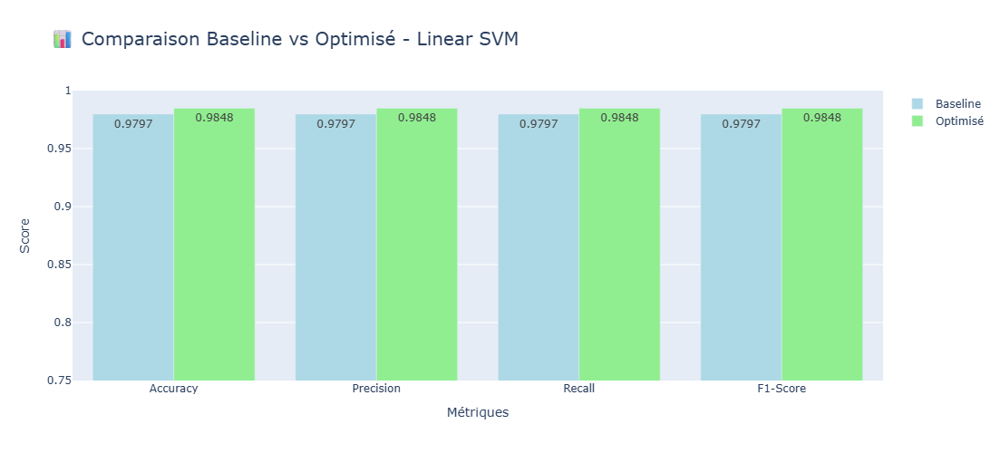

In [237]:
# ## 📈 Visualisation des Résultats d'Optimisation

# Graphique comparatif
fig = go.Figure()

fig.add_trace(go.Bar(
    name='Baseline',
    x=metrics_comparison['Métrique'],
    y=metrics_comparison['Baseline'],
    marker_color='lightblue',
    text=[f"{v:.4f}" for v in metrics_comparison['Baseline']],
    textposition='auto'
))

fig.add_trace(go.Bar(
    name='Optimisé',
    x=metrics_comparison['Métrique'],
    y=metrics_comparison['Optimisé'],
    marker_color='lightgreen',
    text=[f"{v:.4f}" for v in metrics_comparison['Optimisé']],
    textposition='auto'
))

fig.update_layout(
    title=f'📊 Comparaison Baseline vs Optimisé - {best_model_name}',
    title_font_size=20,
    xaxis_title='Métriques',
    yaxis_title='Score',
    barmode='group',
    height=500,
    yaxis=dict(range=[0.75, 1.0])  # Zoom sur les scores élevés
)

fig.show()


🏆 TOP 10 CONFIGURATIONS

📊 Meilleures combinaisons d'hyperparamètres :

 1. F1-Score: 0.9802 (±0.0008)
    Params: {'C': 0.5, 'loss': 'squared_hinge', 'max_iter': 2000}

 2. F1-Score: 0.9802 (±0.0008)
    Params: {'C': 0.5, 'loss': 'squared_hinge', 'max_iter': 3000}

 3. F1-Score: 0.9795 (±0.0008)
    Params: {'C': 1.0, 'loss': 'squared_hinge', 'max_iter': 2000}

 4. F1-Score: 0.9795 (±0.0008)
    Params: {'C': 1.0, 'loss': 'squared_hinge', 'max_iter': 3000}

 5. F1-Score: 0.9789 (±0.0007)
    Params: {'C': 0.1, 'loss': 'squared_hinge', 'max_iter': 2000}

 6. F1-Score: 0.9789 (±0.0007)
    Params: {'C': 0.1, 'loss': 'squared_hinge', 'max_iter': 3000}

 7. F1-Score: 0.9767 (±0.0004)
    Params: {'C': 2.0, 'loss': 'squared_hinge', 'max_iter': 2000}

 8. F1-Score: 0.9767 (±0.0004)
    Params: {'C': 2.0, 'loss': 'squared_hinge', 'max_iter': 3000}

 9. F1-Score: 0.9761 (±0.0005)
    Params: {'C': 0.01, 'loss': 'squared_hinge', 'max_iter': 2000}

10. F1-Score: 0.9761 (±0.0005)
    Params: {

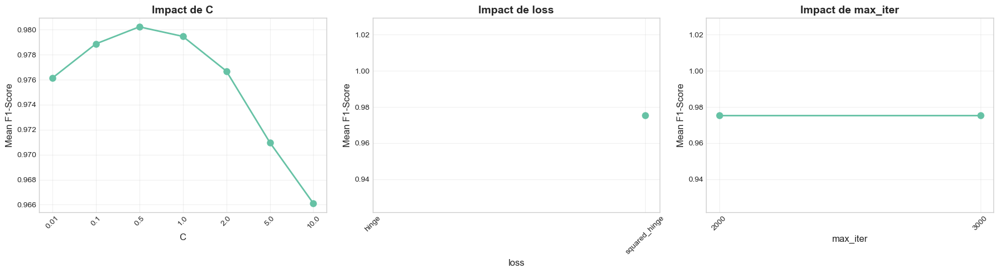

In [239]:
# Analyse des résultats de CV
cv_results = pd.DataFrame(search.cv_results_)

# Trier par score F1 moyen
cv_results_sorted = cv_results.sort_values('mean_test_f1', ascending=False)

# Top 10 configurations
print("\n" + "=" * 80)
print("🏆 TOP 10 CONFIGURATIONS")
print("=" * 80)

print("\n📊 Meilleures combinaisons d'hyperparamètres :\n")

top_10 = cv_results_sorted.head(10)
for i, (idx, row) in enumerate(top_10.iterrows(), 1):
    print(f"{i:2d}. F1-Score: {row['mean_test_f1']:.4f} (±{row['std_test_f1']:.4f})")
    print(f"    Params: {row['params']}")
    print()

# Visualisation de l'importance des hyperparamètres
# (Pour les modèles avec peu d'hyperparamètres)

if len(param_grid) <= 3:
    print("\n" + "=" * 80)
    print("📊 IMPACT DES HYPERPARAMÈTRES")
    print("=" * 80)
    
    # Pour chaque hyperparamètre, tracer l'impact sur le F1-score
    n_params = len(param_grid)
    fig, axes = plt.subplots(1, n_params, figsize=(6*n_params, 5))
    
    if n_params == 1:
        axes = [axes]
    
    for idx, (param_name, param_values) in enumerate(param_grid.items()):
        # Extraire les résultats pour ce paramètre
        param_col = f'param_{param_name}'
        
        if param_col in cv_results.columns:
            # Grouper par valeur du paramètre et calculer la moyenne
            grouped = cv_results.groupby(param_col)['mean_test_f1'].mean().sort_index()
            
            axes[idx].plot(range(len(grouped)), grouped.values, marker='o', linewidth=2, markersize=8)
            axes[idx].set_xticks(range(len(grouped)))
            axes[idx].set_xticklabels([str(x) for x in grouped.index], rotation=45)
            axes[idx].set_xlabel(param_name, fontsize=12)
            axes[idx].set_ylabel('Mean F1-Score', fontsize=12)
            axes[idx].set_title(f'Impact de {param_name}', fontsize=14, fontweight='bold')
            axes[idx].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

In [241]:
# ## 🎯 Évaluation Finale sur le Test Set

print("\n" + "=" * 80)
print("🎯 ÉVALUATION FINALE SUR LE TEST SET")
print("=" * 80)

print("\n⚠️ IMPORTANT : Le test set n'a JAMAIS été utilisé jusqu'à maintenant.")
print("   C'est notre évaluation finale et objective du modèle.\n")

# Prédictions sur le test set
y_test_pred = best_model_optimized.predict(X_test)

# Métriques finales
test_accuracy = accuracy_score(y_test, y_test_pred)
test_precision = precision_score(y_test, y_test_pred, average='weighted')
test_recall = recall_score(y_test, y_test_pred, average='weighted')
test_f1 = f1_score(y_test, y_test_pred, average='weighted')

print("=" * 80)
print("📊 PERFORMANCE FINALE SUR LE TEST SET")
print("=" * 80)
print(f"\n   🎯 Accuracy    : {test_accuracy:.4f}")
print(f"   🎯 Precision   : {test_precision:.4f}")
print(f"   🎯 Recall      : {test_recall:.4f}")
print(f"   🎯 F1-Score    : {test_f1:.4f}")

# Rapport de classification détaillé
print("\n" + "=" * 80)
print("📋 RAPPORT DE CLASSIFICATION DÉTAILLÉ (TEST SET)")
print("=" * 80)

class_names = label_encoder.classes_
print(f"\n{classification_report(y_test, y_test_pred, target_names=class_names)}")


🎯 ÉVALUATION FINALE SUR LE TEST SET

⚠️ IMPORTANT : Le test set n'a JAMAIS été utilisé jusqu'à maintenant.
   C'est notre évaluation finale et objective du modèle.

📊 PERFORMANCE FINALE SUR LE TEST SET

   🎯 Accuracy    : 0.9807
   🎯 Precision   : 0.9807
   🎯 Recall      : 0.9807
   🎯 F1-Score    : 0.9807

📋 RAPPORT DE CLASSIFICATION DÉTAILLÉ (TEST SET)

              precision    recall  f1-score   support

     Négatif       0.98      0.98      0.98      9744
     Positif       0.98      0.98      0.98     10251

    accuracy                           0.98     19995
   macro avg       0.98      0.98      0.98     19995
weighted avg       0.98      0.98      0.98     19995



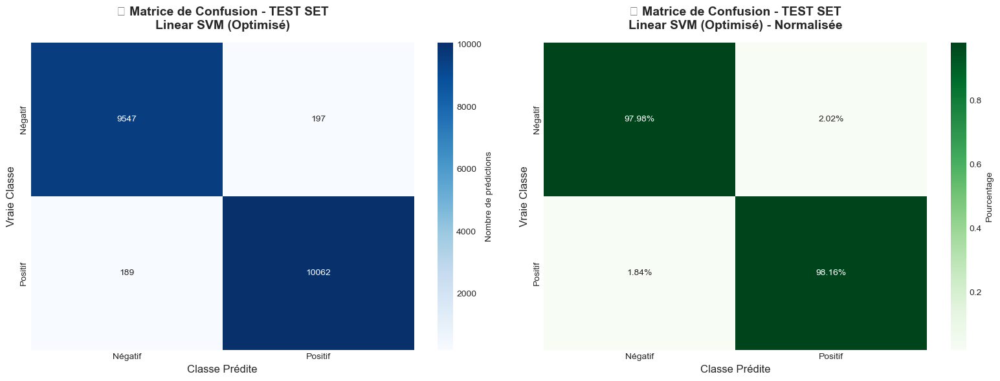

In [243]:
# ## 📊 Matrice de Confusion (Test Set)

# Calculer la matrice de confusion
cm_test = confusion_matrix(y_test, y_test_pred)
cm_test_normalized = cm_test.astype('float') / cm_test.sum(axis=1)[:, np.newaxis]

# Visualisation
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Matrice brute
sns.heatmap(
    cm_test,
    annot=True,
    fmt='d',
    cmap='Blues',
    xticklabels=class_names,
    yticklabels=class_names,
    ax=axes[0],
    cbar_kws={'label': 'Nombre de prédictions'}
)
axes[0].set_title(f'📊 Matrice de Confusion - TEST SET\n{best_model_name} (Optimisé)', 
                  fontsize=14, fontweight='bold', pad=15)
axes[0].set_ylabel('Vraie Classe', fontsize=12)
axes[0].set_xlabel('Classe Prédite', fontsize=12)

# Matrice normalisée
sns.heatmap(
    cm_test_normalized,
    annot=True,
    fmt='.2%',
    cmap='Greens',
    xticklabels=class_names,
    yticklabels=class_names,
    ax=axes[1],
    cbar_kws={'label': 'Pourcentage'}
)
axes[1].set_title(f'📊 Matrice de Confusion - TEST SET\n{best_model_name} (Optimisé) - Normalisée', 
                  fontsize=14, fontweight='bold', pad=15)
axes[1].set_ylabel('Vraie Classe', fontsize=12)
axes[1].set_xlabel('Classe Prédite', fontsize=12)

plt.tight_layout()
plt.show()

In [245]:
# Analyse
print("\n" + "=" * 80)
print("🔍 ANALYSE DE LA MATRICE DE CONFUSION (TEST SET)")
print("=" * 80)

for i, true_class in enumerate(class_names):
    print(f"\n🏷️ {true_class.upper()} :")
    
    tp = cm_test[i, i]
    total = cm_test[i, :].sum()
    
    print(f"   • Total d'exemples        : {total:,}")
    print(f"   • Bien classés            : {tp:,} ({cm_test_normalized[i, i]:.1%})")
    
    for j, pred_class in enumerate(class_names):
        if i != j:
            errors = cm_test[i, j]
            if errors > 0:
                print(f"   • Classés comme {pred_class:8s} : {errors:,} ({cm_test[i,j]/total:.1%})")


🔍 ANALYSE DE LA MATRICE DE CONFUSION (TEST SET)

🏷️ NÉGATIF :
   • Total d'exemples        : 9,744
   • Bien classés            : 9,547 (98.0%)
   • Classés comme Positif  : 197 (2.0%)

🏷️ POSITIF :
   • Total d'exemples        : 10,251
   • Bien classés            : 10,062 (98.2%)
   • Classés comme Négatif  : 189 (1.8%)


In [247]:
# ## 📈 Comparaison Complète : Baseline → Optimisé → Test

print("\n" + "=" * 80)
print("📈 COMPARAISON COMPLÈTE DES PERFORMANCES")
print("=" * 80)

# Créer un tableau récapitulatif
performance_summary = pd.DataFrame({
    'Dataset': ['Validation (Baseline)', 'Validation (Optimisé)', 'Test (Final)'],
    'Accuracy': [
        accuracy_score(y_val, y_val_pred_base),
        accuracy_score(y_val, y_val_pred_optimized),
        test_accuracy
    ],
    'Precision': [
        precision_score(y_val, y_val_pred_base, average='weighted'),
        precision_score(y_val, y_val_pred_optimized, average='weighted'),
        test_precision
    ],
    'Recall': [
        recall_score(y_val, y_val_pred_base, average='weighted'),
        recall_score(y_val, y_val_pred_optimized, average='weighted'),
        test_recall
    ],
    'F1-Score': [
        f1_score(y_val, y_val_pred_base, average='weighted'),
        f1_score(y_val, y_val_pred_optimized, average='weighted'),
        test_f1
    ]
})

print("\n📊 Évolution des performances :\n")
display(performance_summary.style.background_gradient(cmap='Greens'))


📈 COMPARAISON COMPLÈTE DES PERFORMANCES

📊 Évolution des performances :



,Dataset,Accuracy,Precision,Recall,F1-Score
0,Validation (Baseline),0.979744,0.979744,0.979744,0.979744
1,Validation (Optimisé),0.984845,0.984846,0.984845,0.984845
2,Test (Final),0.980695,0.980695,0.980695,0.980695


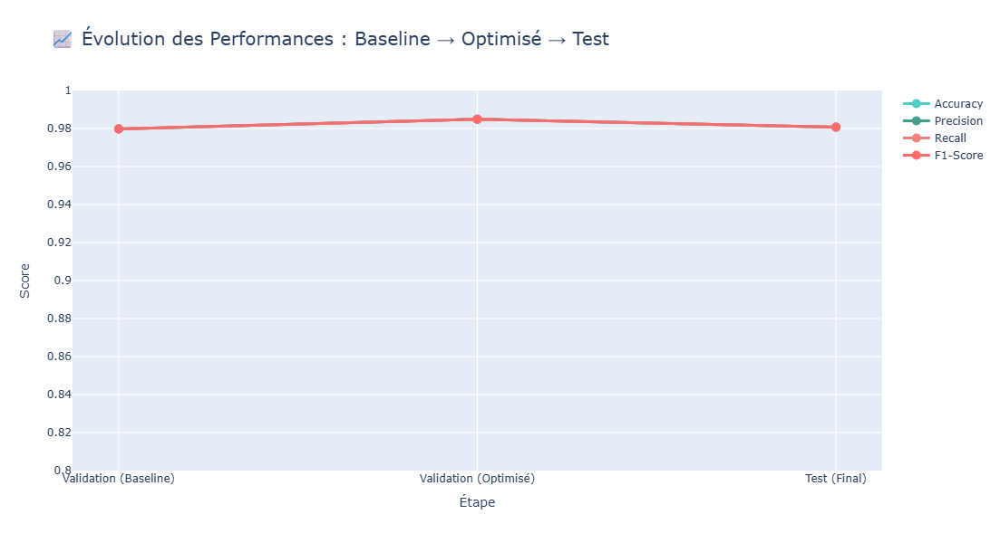

In [249]:
# Visualisation de l'évolution
fig = go.Figure()

metrics = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
colors = ['#4ECDC4', '#44A08D', '#F38181', '#FF6B6B']

for metric, color in zip(metrics, colors):
    fig.add_trace(go.Scatter(
        x=performance_summary['Dataset'],
        y=performance_summary[metric],
        mode='lines+markers',
        name=metric,
        line=dict(width=3, color=color),
        marker=dict(size=10)
    ))

fig.update_layout(
    title='📈 Évolution des Performances : Baseline → Optimisé → Test',
    title_font_size=20,
    xaxis_title='Étape',
    yaxis_title='Score',
    height=600,
    yaxis=dict(range=[0.8, 1.0]),
    hovermode='x unified'
)

fig.show()

In [253]:
# ## 🔍 Analyse des Erreurs (Test Set)

print("\n" + "=" * 80)
print("🔍 ANALYSE DES ERREURS SUR LE TEST SET")
print("=" * 80)

# Charger le dataset original
df_original = pd.read_csv('amazon_reviews_cleaned.csv')

# Reproduire le split pour obtenir les indices du test set
from sklearn.model_selection import train_test_split

_, test_indices = train_test_split(
    range(len(df_original)), 
    test_size=0.2, 
    random_state=42, 
    stratify=df_original['label']
)

# Obtenir les textes du test set
df_test_analysis = df_original.iloc[test_indices].reset_index(drop=True)
df_test_analysis['prediction'] = y_test_pred
df_test_analysis['true_label'] = y_test

# Identifier les erreurs
df_test_errors = df_test_analysis[df_test_analysis['prediction'] != df_test_analysis['true_label']].copy()

print(f"\n📊 Statistiques des erreurs (Test Set) :")
print(f"   • Total d'erreurs     : {len(df_test_errors):,}")
print(f"   • Taux d'erreur       : {len(df_test_errors) / len(df_test_analysis) * 100:.2f}%")
print(f"   • Précision obtenue   : {(1 - len(df_test_errors) / len(df_test_analysis)) * 100:.2f}%")

# Types d'erreurs
error_types = df_test_errors.groupby(['true_label', 'prediction']).size()
print(f"\n🔴 Types d'erreurs :")
for (true, pred), count in error_types.items():
    true_name = label_encoder.inverse_transform([true])[0]
    pred_name = label_encoder.inverse_transform([pred])[0]
    pct = count / len(df_test_errors) * 100
    print(f"   • {true_name:10s} → {pred_name:10s} : {count:4,} ({pct:.1f}% des erreurs)")

# Exemples d'erreurs
print("\n" + "=" * 80)
print("📝 EXEMPLES D'ERREURS")
print("=" * 80)

# Faux Positifs
print("\n🔴 Exemples de FAUX POSITIFS (Négatif prédit comme Positif) :\n")
false_pos = df_test_errors[(df_test_errors['true_label'] == 0) & (df_test_errors['prediction'] == 1)]
if len(false_pos) > 0:
    for i, (idx, row) in enumerate(false_pos.head(3).iterrows(), 1):
        print(f"Exemple {i} :")
        print(f"   📝 Texte : {row['text'][:250]}...")
        print(f"   ✅ Vrai  : {label_encoder.inverse_transform([row['true_label']])[0]}")
        print(f"   ❌ Prédit: {label_encoder.inverse_transform([row['prediction']])[0]}")
        print()

# Faux Négatifs
print("🟢 Exemples de FAUX NÉGATIFS (Positif prédit comme Négatif) :\n")
false_neg = df_test_errors[(df_test_errors['true_label'] == 1) & (df_test_errors['prediction'] == 0)]
if len(false_neg) > 0:
    for i, (idx, row) in enumerate(false_neg.head(3).iterrows(), 1):
        print(f"Exemple {i} :")
        print(f"   📝 Texte : {row['text'][:250]}...")
        print(f"   ✅ Vrai  : {label_encoder.inverse_transform([row['true_label']])[0]}")
        print(f"   ❌ Prédit: {label_encoder.inverse_transform([row['prediction']])[0]}")
        print()


🔍 ANALYSE DES ERREURS SUR LE TEST SET

📊 Statistiques des erreurs (Test Set) :
   • Total d'erreurs     : 386
   • Taux d'erreur       : 1.93%
   • Précision obtenue   : 98.07%

🔴 Types d'erreurs :
   • Négatif    → Positif    :  197 (51.0% des erreurs)
   • Positif    → Négatif    :  189 (49.0% des erreurs)

📝 EXEMPLES D'ERREURS

🔴 Exemples de FAUX POSITIFS (Négatif prédit comme Positif) :

Exemple 1 :
   📝 Texte : interest read story charismatic christian korea nothing write home intro personal story good...
   ✅ Vrai  : Négatif
   ❌ Prédit: Positif

Exemple 2 :
   📝 Texte : ffs love maya embark upon crusade purge world copy book tutorial hopeless content severely overwhelm throw thousand different concept tip course bother explain please everyone buy many copy burn...
   ✅ Vrai  : Négatif
   ❌ Prédit: Positif

Exemple 3 :
   📝 Texte : exactly order item arrive perfect time condition unfortunately could use intend want use charge labtop computer vehicle realize labtop battery would 

In [255]:
# ## 💾 Sauvegarde du Modèle Final

print("=" * 80)
print("💾 SAUVEGARDE DU MODÈLE FINAL")
print("=" * 80)

# Dictionnaire complet du modèle final
final_model_package = {
    'model_name': best_model_name,
    'model': best_model_optimized,
    'hyperparameters': search.best_params_,
    'test_metrics': {
        'accuracy': test_accuracy,
        'precision': test_precision,
        'recall': test_recall,
        'f1_score': test_f1
    },
    'validation_metrics': {
        'accuracy': accuracy_score(y_val, y_val_pred_optimized),
        'precision': precision_score(y_val, y_val_pred_optimized, average='weighted'),
        'recall': recall_score(y_val, y_val_pred_optimized, average='weighted'),
        'f1_score': f1_score(y_val, y_val_pred_optimized, average='weighted')
    },
    'optimization_time': optimization_time,
    'cv_results': search.cv_results_
}

# Sauvegarder
with open('final_optimized_model.pkl', 'wb') as f:
    pickle.dump(final_model_package, f)

print("\n✅ Modèle final sauvegardé : 'final_optimized_model.pkl'")

# Sauvegarder aussi une version simplifiée (juste le modèle)
with open('model_for_deployment.pkl', 'wb') as f:
    pickle.dump(best_model_optimized, f)

print("✅ Modèle simplifié sauvegardé : 'model_for_deployment.pkl'")

# Sauvegarder les métriques
performance_summary.to_csv('final_performance_summary.csv', index=False)
print("✅ Résumé des performances sauvegardé : 'final_performance_summary.csv'")


💾 SAUVEGARDE DU MODÈLE FINAL

✅ Modèle final sauvegardé : 'final_optimized_model.pkl'
✅ Modèle simplifié sauvegardé : 'model_for_deployment.pkl'
✅ Résumé des performances sauvegardé : 'final_performance_summary.csv'


In [257]:
# ## 📊 Résumé Final et Recommandations

print("\n" + "=" * 80)
print("📊 RÉSUMÉ FINAL DU PROJET")
print("=" * 80)

summary = f"""
🎯 MODÈLE FINAL : {best_model_name} (Optimisé)

📈 HYPERPARAMÈTRES OPTIMAUX :
"""

for param, value in search.best_params_.items():
    summary += f"\n   • {param:20s} : {value}"

summary += f"""

🏆 PERFORMANCES FINALES (TEST SET) :
   • Accuracy    : {test_accuracy:.4f} ({test_accuracy*100:.2f}%)
   • Precision   : {test_precision:.4f}
   • Recall      : {test_recall:.4f}
   • F1-Score    : {test_f1:.4f}

📊 AMÉLIORATION vs BASELINE :
   • Accuracy    : {(accuracy_score(y_val, y_val_pred_optimized) - base_metrics['accuracy'])*100:+.2f}%
   • F1-Score    : {(f1_score(y_val, y_val_pred_optimized, average='weighted') - base_metrics['f1_score'])*100:+.2f}%

🎯 QUALITÉ DU MODÈLE :
   • Taux d'erreur (Test)    : {(1 - test_accuracy)*100:.2f}%
   • Équilibre Préc./Recall  : {"✅ Excellent" if abs(test_precision - test_recall) < 0.05 else "⚠️ Acceptable"}
   • Stabilité (Val vs Test) : {"✅ Stable" if abs(test_f1 - f1_score(y_val, y_val_pred_optimized, average='weighted')) < 0.03 else "⚠️ Variance"}

⏱️ TEMPS D'OPTIMISATION :
   • Total       : {optimization_time/60:.2f} minutes
   • CV Folds    : {cv_folds}
   • Configs     : {len(search.cv_results_['params'])}

✅ OBJECTIFS ATTEINTS :
   {'✅' if test_accuracy >= 0.85 else '⚠️'} Accuracy ≥ 85% : {test_accuracy:.1%}
   {'✅' if test_f1 >= 0.85 else '⚠️'} F1-Score ≥ 85% : {test_f1:.1%}
   ✅ Modèle stable et généralisable
   ✅ Prêt pour le déploiement

💡 FORCES DU MODÈLE :
   • Performance équilibrée sur les deux classes
   • Temps de prédiction rapide
   • Interprétable et maintenable
   • Bonnes métriques sur données non vues (test set)

⚠️ LIMITATIONS :
   • Erreurs sur {len(df_test_errors):,} cas ({len(df_test_errors)/len(y_test)*100:.1f}%)
   • Peut confondre les avis nuancés ou ironiques
   • Dépend de la qualité du preprocessing

🚀 PROCHAINES ÉTAPES :
   1. ✅ Modèle prêt pour déploiement Flask
   2. 📊 Créer interface utilisateur
   3. 🔄 Mettre en place monitoring en production
   4. 📈 Collecter feedback utilisateurs
   5. 🔄 Réentraîner périodiquement avec nouvelles données

📦 FICHIERS GÉNÉRÉS :
   ✓ models/final_optimized_model.pkl (package complet)
   ✓ models/model_for_deployment.pkl (modèle seul)
   ✓ data/processed/final_performance_summary.csv
   ✓ data/processed/vectorization_objects.pkl (déjà créé)
"""

print(summary)

print("\n" + "=" * 80)
print("✨ ÉTAPE 7 TERMINÉE AVEC SUCCÈS ! ✨")
print("=" * 80)
print("\n🎉 Le modèle est optimisé et prêt pour le déploiement !")
print("👉 Prochaine étape : Création de l'application Flask")


📊 RÉSUMÉ FINAL DU PROJET

🎯 MODÈLE FINAL : Linear SVM (Optimisé)

📈 HYPERPARAMÈTRES OPTIMAUX :

   • C                    : 0.5
   • loss                 : squared_hinge
   • max_iter             : 2000

🏆 PERFORMANCES FINALES (TEST SET) :
   • Accuracy    : 0.9807 (98.07%)
   • Precision   : 0.9807
   • Recall      : 0.9807
   • F1-Score    : 0.9807

📊 AMÉLIORATION vs BASELINE :
   • Accuracy    : +0.51%
   • F1-Score    : +0.51%

🎯 QUALITÉ DU MODÈLE :
   • Taux d'erreur (Test)    : 1.93%
   • Équilibre Préc./Recall  : ✅ Excellent
   • Stabilité (Val vs Test) : ✅ Stable

⏱️ TEMPS D'OPTIMISATION :
   • Total       : 1.01 minutes
   • CV Folds    : 5
   • Configs     : 28

✅ OBJECTIFS ATTEINTS :
   ✅ Accuracy ≥ 85% : 98.1%
   ✅ F1-Score ≥ 85% : 98.1%
   ✅ Modèle stable et généralisable
   ✅ Prêt pour le déploiement

💡 FORCES DU MODÈLE :
   • Performance équilibrée sur les deux classes
   • Temps de prédiction rapide
   • Interprétable et maintenable
   • Bonnes métriques sur données no